## Comparing MUC6 cells in healthy and disease by Gene Ontology analysis

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import sys
import os
from collections import Counter
import gseapy

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_hex
import ast

import gseapy

In [2]:
import random

In [3]:
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.0 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3


In [4]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

In [5]:
gene_set_names = gseapy.get_library_name(organism='Human')
print(gene_set_names)

['ARCHS4_Cell-lines', 'ARCHS4_IDG_Coexp', 'ARCHS4_Kinases_Coexp', 'ARCHS4_TFs_Coexp', 'ARCHS4_Tissues', 'Achilles_fitness_decrease', 'Achilles_fitness_increase', 'Aging_Perturbations_from_GEO_down', 'Aging_Perturbations_from_GEO_up', 'Allen_Brain_Atlas_10x_scRNA_2021', 'Allen_Brain_Atlas_down', 'Allen_Brain_Atlas_up', 'Azimuth_2023', 'Azimuth_Cell_Types_2021', 'BioCarta_2013', 'BioCarta_2015', 'BioCarta_2016', 'BioPlanet_2019', 'BioPlex_2017', 'CCLE_Proteomics_2020', 'CORUM', 'COVID-19_Related_Gene_Sets', 'COVID-19_Related_Gene_Sets_2021', 'Cancer_Cell_Line_Encyclopedia', 'CellMarker_Augmented_2021', 'ChEA_2013', 'ChEA_2015', 'ChEA_2016', 'ChEA_2022', 'Chromosome_Location', 'Chromosome_Location_hg19', 'ClinVar_2019', 'DSigDB', 'Data_Acquisition_Method_Most_Popular_Genes', 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019', 'DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019', 'Descartes_Cell_Types_and_Tissue_2021', 'Diabetes_Perturbations_GEO_2022', 'DisGeNET', 'Disease_Perturbations_from_GEO

### Import data

In [6]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/pooled_compartments/Epi_SI_AP.pooled_healthy_disease.remapped.allgenes.fine_annot.no_doublets.20230418.h5ad')

In [7]:
adata

AnnData object with n_obs × n_vars = 221900 × 18485
    var: 'gene_ids-0-0-query', 'feature_type-0-0-query', 'mito-0-0-query', 'ribo-0-0-query', 'hb-0-0-query', 'n_counts-0-0-query', 'n_counts_raw-0-0-query', 'n_counts_spliced-0-0-query', 'n_counts_unspliced-0-0-query', 'n_cells-0-0-query', 'n_cells_raw-0-0-query', 'n_cells_spliced-0-0-query', 'n_cells_unspliced-0-0-query', 'cc-0-0-query', 'ig-0-0-query', 'tcr-0-0-query', 'gene_id-1-0-query', 'mt-1-0-query', 'ensmbl_id-colon-1-0-query', 'n_cells_by_counts-colon-1-0-query', 'mean_counts-colon-1-0-query', 'pct_dropout_by_counts-colon-1-0-query', 'total_counts-colon-1-0-query', 'n_cells_by_counts-ileum-1-0-query', 'mean_counts-ileum-1-0-query', 'pct_dropout_by_counts-ileum-1-0-query', 'total_counts-ileum-1-0-query', 'gene_ids-reference', 'feature_type-reference', 'mito-reference', 'ribo-reference', 'hb-reference', 'n_counts-reference', 'n_counts_raw-reference', 'n_counts_spliced-reference', 'n_counts_unspliced-reference', 'n_cells-referen

In [8]:
adata.obs = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/pooled_compartments/Epi_SI_AP.pooled_healthy_disease.remapped.allgenes.fine_annot.no_doublets.20230418.csv',index_col=0)

/home/jovyan/my-conda-envs/standard_plot_gsea/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: DtypeWarning: Columns (3,5,6,8,9,11,12,14,62,63,64,65,66,67,70,72,73,75,78,82,83,84,86,88,91,92,93,94,95,100,101,102,103,106,107,109,110,112,113,114,118,120,121,122,123,124,125,126,127,128,130,131,133,134,135) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [9]:
adata

AnnData object with n_obs × n_vars = 221900 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [10]:
adata.X.max()

9.066531

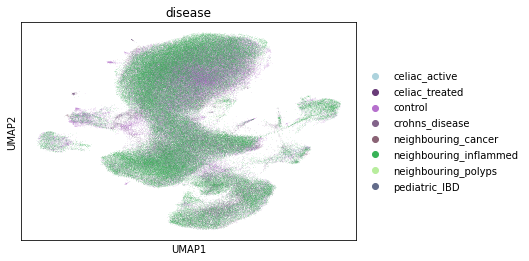

In [11]:
sc.pl.umap(adata,color='disease')

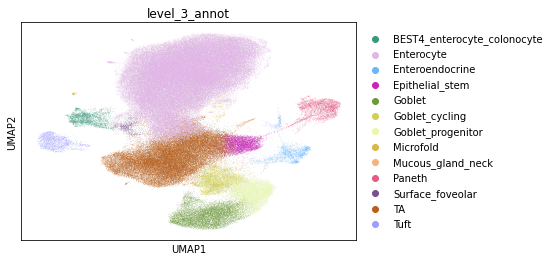

In [12]:
sc.pl.umap(adata,color='level_3_annot')

### Analyse

In [13]:
#Prepare categories for downsampling (per donor_celltype combination)
adata.obs['donor_celltype']=adata.obs['donorID_unified'].astype(str)+'_'+adata.obs['level_3_annot'].astype(str)
adata.obs.donor_celltype.value_counts()

D207_Enterocyte           22733
D207_TA                    9010
D168_Enterocyte            8924
D191_TA                    6877
D11_Enterocyte             6846
                          ...  
D46_Goblet                    1
D214_Mucous_gland_neck        1
D46_Goblet_cycling            1
D47_Paneth                    1
D161_Mucous_gland_neck        1
Name: donor_celltype, Length: 943, dtype: int64

In [14]:
#isolate MUC6/MGN/INFLAREs
muc6 = adata[adata.obs.level_3_annot.isin(['Mucous_gland_neck'])].copy()

In [15]:
muc6

AnnData object with n_obs × n_vars = 298 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_splic

In [16]:
#subcluster, recompute neighbours and umap
sc.pp.neighbors(muc6, use_rep="X_scANVI")
sc.tl.umap(muc6)

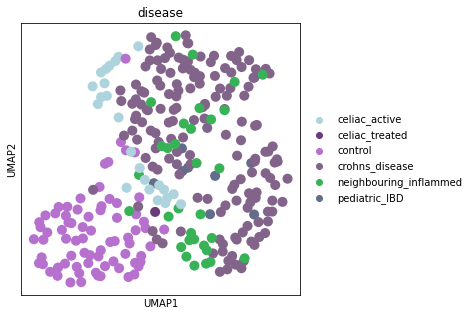

In [17]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(muc6,color='disease')

In [18]:
muc6.obs['disease'].cat.reorder_categories(['control',

 'crohns_disease',
 'pediatric_IBD',                               
  'neighbouring_inflammed',
                                            'celiac_active','celiac_treated'
   ], inplace=True)


/home/jovyan/my-conda-envs/standard_plot_gsea/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  res = method(*args, **kwargs)


In [19]:
muc6

AnnData object with n_obs × n_vars = 298 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_splic

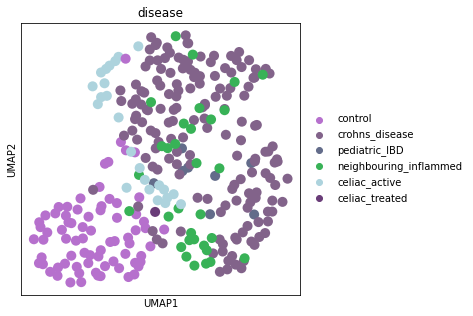

In [20]:
sc.pl.umap(muc6,color='disease')

In [21]:
#simplify disease metadata
muc6.obs['disease_simplified'] = (muc6.obs["disease"].map(lambda x: {
 'control':'healthy',
 'neighbouring_inflammed':'neighbouring',
 'pediatric_IBD':'IBD',
 'crohns_disease':'IBD',
 'celiac_active':'celiac',
    'celiac_treated':'celiac'#only 1 cell
        
         }.get(x, x)).astype("category"))

In [22]:
muc6.obs['disease'].value_counts()

crohns_disease            159
control                    74
neighbouring_inflammed     32
celiac_active              24
pediatric_IBD               8
celiac_treated              1
Name: disease, dtype: int64

In [23]:
muc6.obs['disease'].value_counts()

crohns_disease            159
control                    74
neighbouring_inflammed     32
celiac_active              24
pediatric_IBD               8
celiac_treated              1
Name: disease, dtype: int64

In [24]:
muc6.uns['log1p']["base"] = None

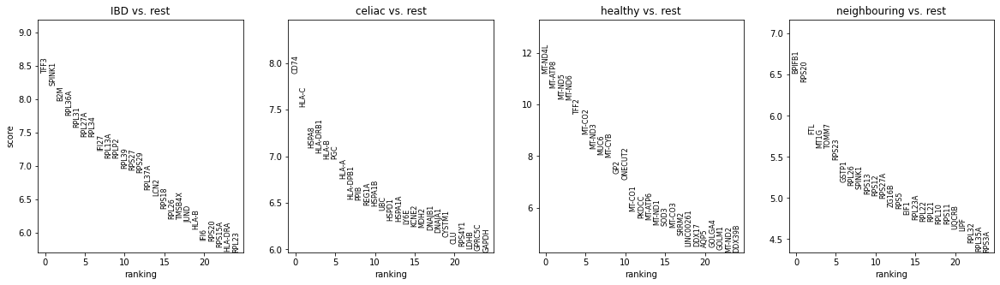

In [25]:
#DGE scanpy wilcoxon using broad disease categories
sc.tl.rank_genes_groups(muc6,groupby='disease_simplified',method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6, n_genes=25, sharey=False, key="wilcoxon")

In [26]:
#compare IBD to healthy and neighbouring, then do GO analysis

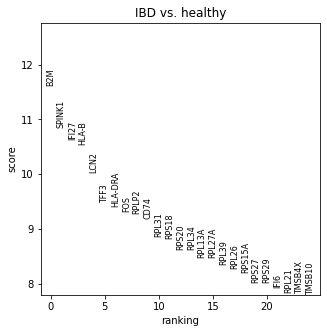

In [27]:
sc.tl.rank_genes_groups(muc6,groupby='disease_simplified',groups=['IBD'], reference='healthy', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6, n_genes=25, sharey=False, key="wilcoxon")

#### GSEA

In [28]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6, group='IBD', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

165


In [29]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Biological_Process_2018',
                     cutoff = 0.5)

In [30]:
enr_res.results.head()

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2018,SRP-dependent cotranslational protein targetin...,62/89,5.308400e-113,6.078118e-110,0,0,441.602301,114164.274472,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;SRP14;RPL10...
1,GO_Biological_Process_2018,protein targeting to ER (GO:0045047),63/97,9.047749e-112,5.179836e-109,0,0,359.706747,91972.344319,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;SRP14;RPL10...
2,GO_Biological_Process_2018,cotranslational protein targeting to membrane ...,62/93,4.831604e-111,1.844062e-108,0,0,384.543689,97678.621912,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;SRP14;RPL10...
3,GO_Biological_Process_2018,"nuclear-transcribed mRNA catabolic process, no...",62/112,2.031849e-103,5.816169e-101,0,0,238.188350,56321.378344,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;RPL10A;RPL9...
4,GO_Biological_Process_2018,viral gene expression (GO:0019080),61/110,9.748871e-102,2.232491e-99,0,0,236.841837,55086.220488,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;RPL10A;RPL9...


<AxesSubplot:title={'center':'GO_Biological_Process_2018'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

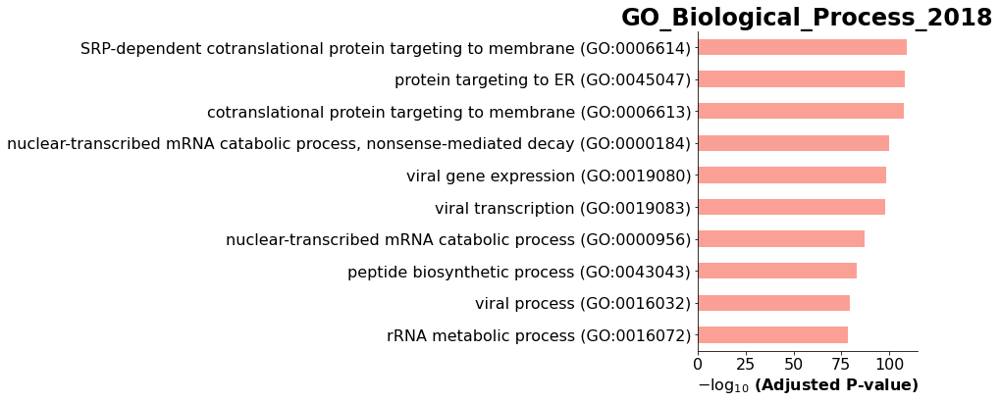

In [31]:
gseapy.barplot(enr_res.res2d,title='GO_Biological_Process_2018')

<AxesSubplot:title={'center':'KEGG_2019_Human'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

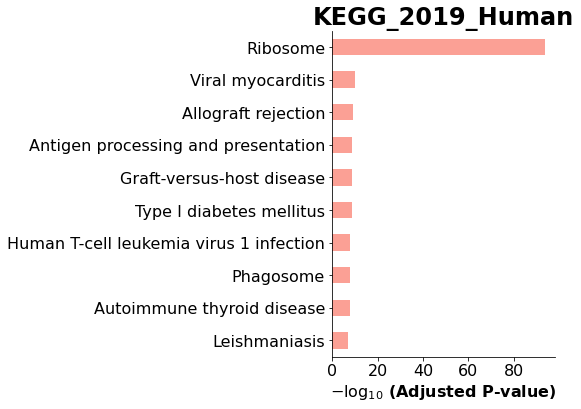

In [32]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='KEGG_2019_Human',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='KEGG_2019_Human')

<AxesSubplot:title={'center':'WikiPathways_2019_Human'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

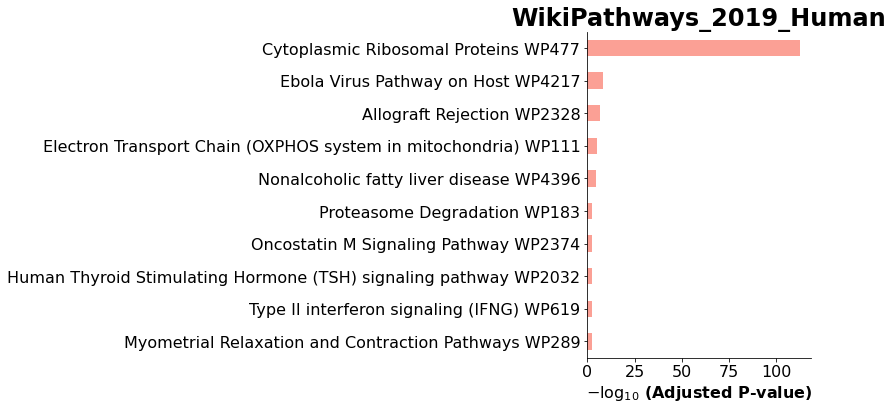

In [33]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='WikiPathways_2019_Human',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='WikiPathways_2019_Human')

<AxesSubplot:title={'center':'GO_Cellular_Component_2021'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

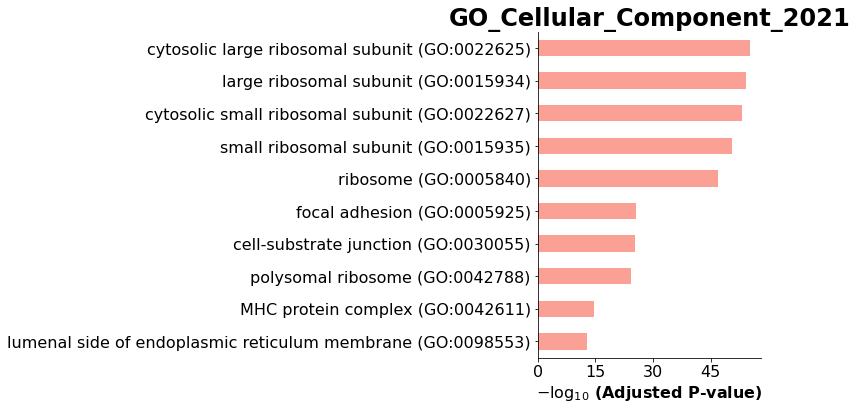

In [34]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Cellular_Component_2021',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='GO_Cellular_Component_2021')

<AxesSubplot:title={'center':'HDSigDB_Human_2021'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

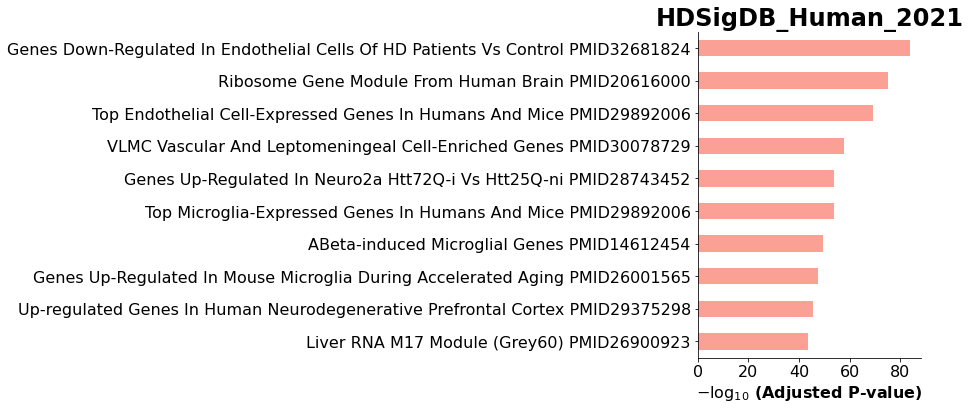

In [35]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='HDSigDB_Human_2021',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='HDSigDB_Human_2021')

<AxesSubplot:title={'center':'MSigDB_Hallmark_2020'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

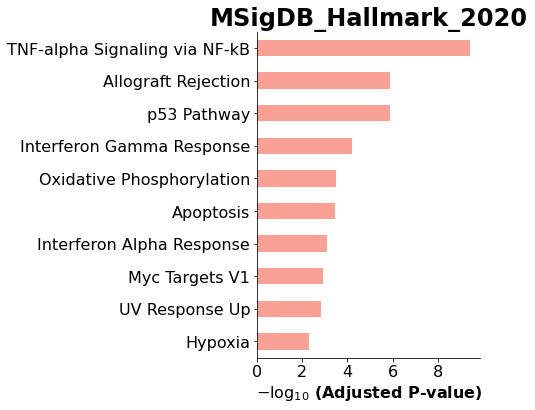

In [36]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='MSigDB_Hallmark_2020',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='MSigDB_Hallmark_2020')

<AxesSubplot:title={'center':'GO_Molecular_Function_2018'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

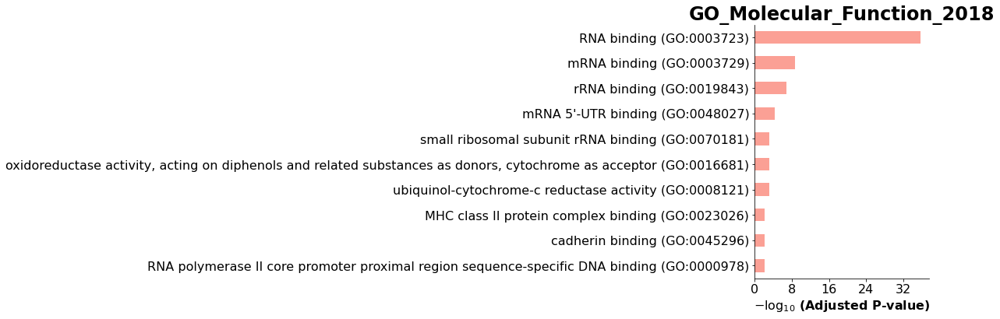

In [37]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Molecular_Function_2018',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='GO_Molecular_Function_2018')

<AxesSubplot:title={'center':'KEGG_2021_Human'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

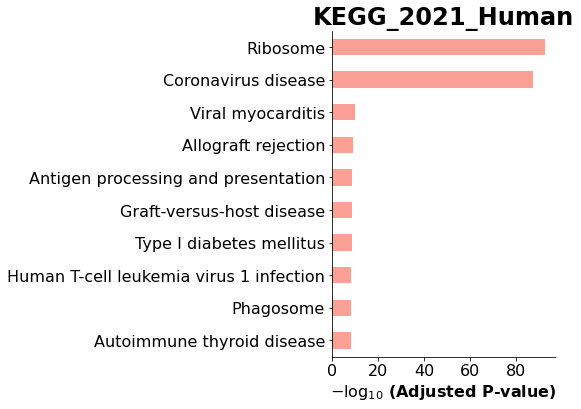

In [38]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='KEGG_2021_Human',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='KEGG_2021_Human')

<AxesSubplot:title={'center':'RNA-Seq_Disease_Gene_and_Drug_Signatures_from_GEO'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

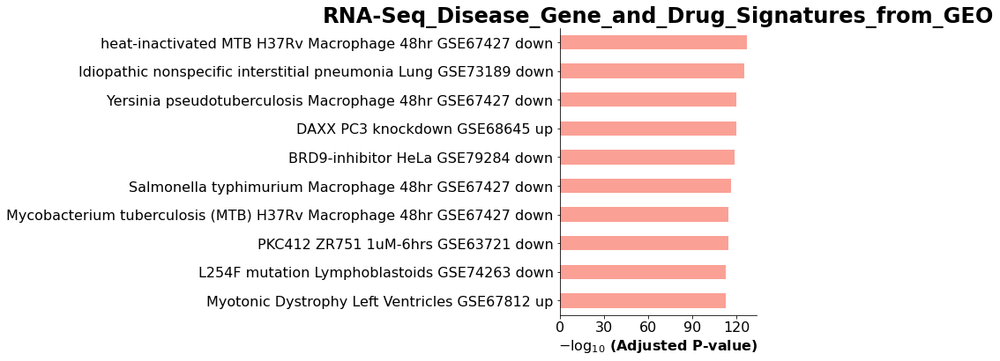

In [39]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='RNA-Seq_Disease_Gene_and_Drug_Signatures_from_GEO',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='RNA-Seq_Disease_Gene_and_Drug_Signatures_from_GEO')

<AxesSubplot:title={'center':'Reactome_2016'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

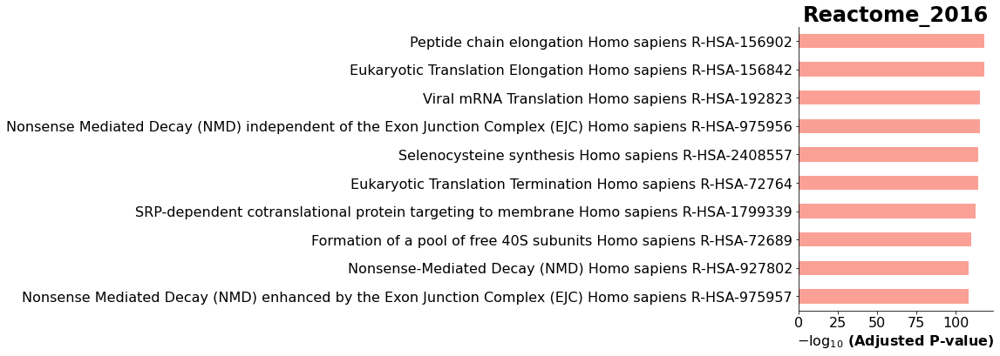

In [40]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='Reactome_2016',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='Reactome_2016')

<AxesSubplot:title={'center':'Reactome_2022'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

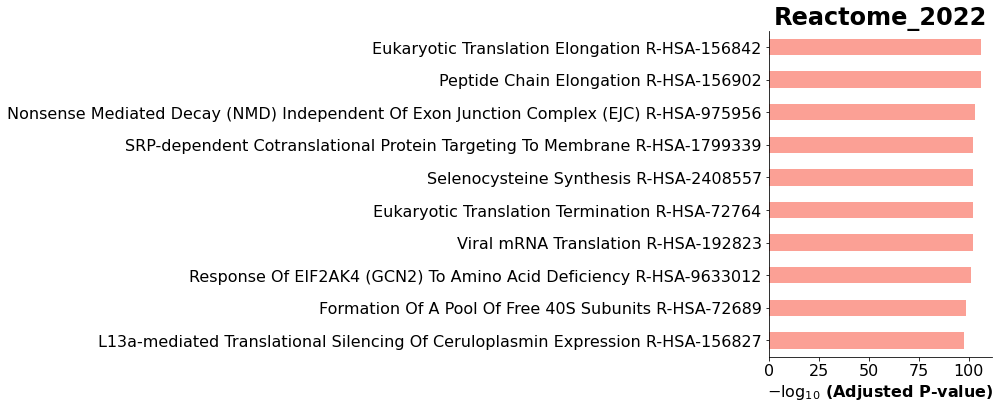

In [41]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='Reactome_2022',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='Reactome_2022',topterm=15)

In [42]:
from gseapy import barplot, dotplot

better plotting functions
https://github.com/zqfang/GSEApy/blob/master/docs/gseapy_example.ipynb

In [43]:
enr_res.results.head()

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,Reactome_2022,Eukaryotic Translation Elongation R-HSA-156842,61/90,6.925179e-110,4.155108e-107,0,0,400.585544,100686.854467,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;RPL10A;RPL9...
1,Reactome_2022,Peptide Chain Elongation R-HSA-156902,60/86,2.910058e-109,8.730175e-107,0,0,435.362637,108803.044906,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;RPL10A;RPL9...
2,Reactome_2022,Nonsense Mediated Decay (NMD) Independent Of E...,60/92,2.223003e-106,4.446007e-104,0,0,353.625000,86028.178695,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;RPL10A;RPL9...
3,Reactome_2022,SRP-dependent Cotranslational Protein Targetin...,62/108,7.684019e-105,8.258423e-103,0,0,258.952723,62079.329742,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;RPL10A;SRP1...
4,Reactome_2022,Selenocysteine Synthesis R-HSA-2408557,59/90,9.634826e-105,8.258423e-103,0,0,355.580037,85163.570176,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;RPL10A;RPL9...


In [44]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

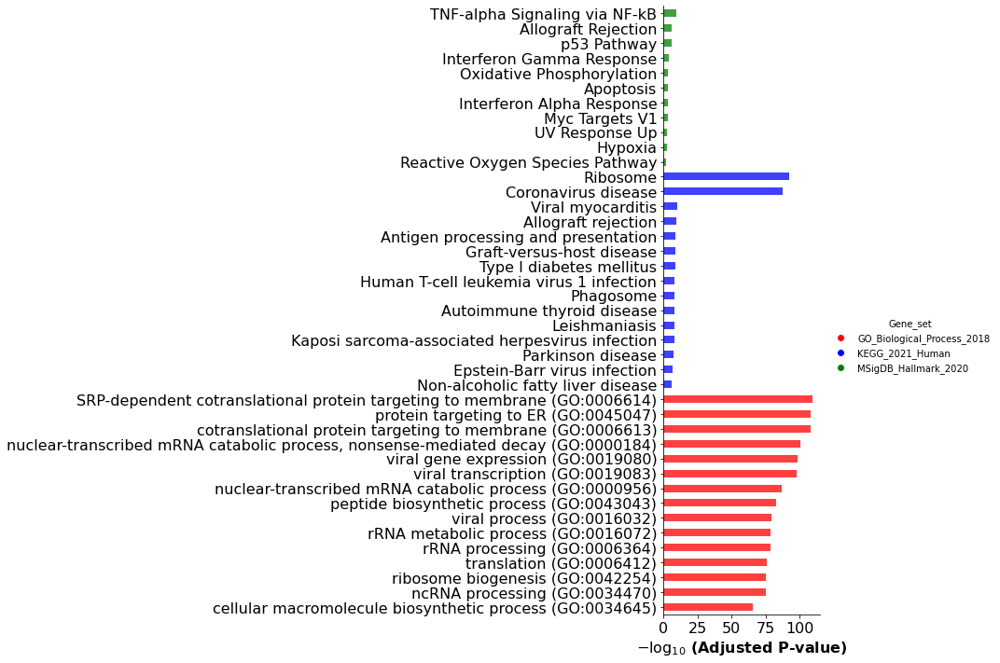

In [45]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=15,
              figsize=(3,12), 
              color=['red', 'blue','green'] # set colors for group
             )

In [46]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['KEGG_2021_Human'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

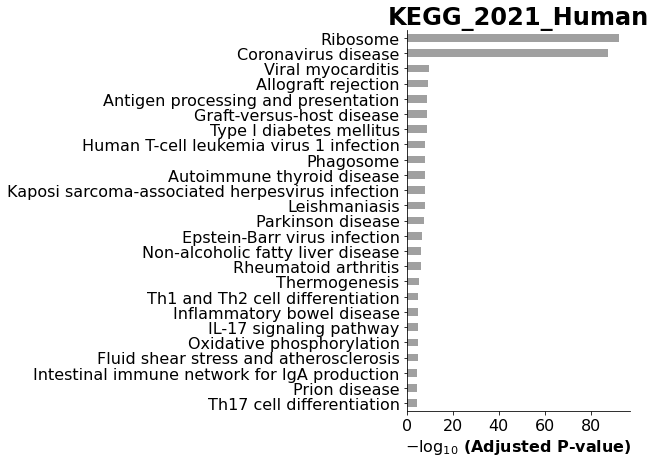

In [47]:
ax = barplot(enr.res2d,title='KEGG_2021_Human', figsize=(4, 7), color='grey',top_term=25)

In [48]:
ax.figure.savefig('KEGG_2021_Human_top25_muc6_IBD_vs_healthy.pdf',bbox_inches='tight')

In [49]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

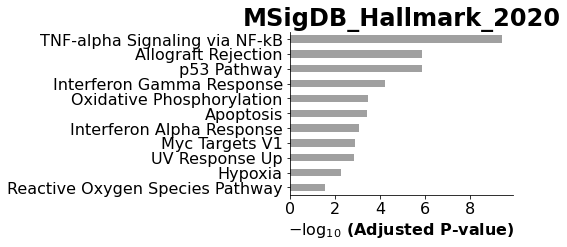

In [50]:
ax = barplot(enr.res2d,title='MSigDB_Hallmark_2020', figsize=(4, 3), color='grey',top_term=25)

In [51]:
ax.figure.savefig('MSIGDB_Hallmark_top25_muc6_IBD_vs_healthy.pdf',bbox_inches='tight')

In [52]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

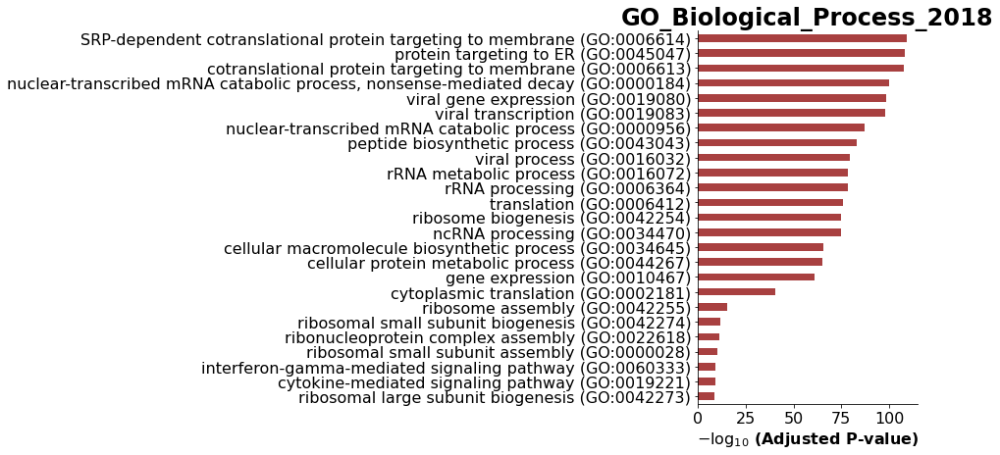

In [53]:
ax = barplot(enr.res2d,title='GO_Biological_Process_2018', figsize=(4, 7), color='darkred',top_term=25)

In [54]:
from gseapy import gseaplot, heatmap

In [55]:
enr

In [56]:
pd.options.display.max_colwidth = 1000

In [57]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

In [58]:
enr.results.head(26)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,16/200,1.009099e-11,3.834576e-10,0,0,11.468340,290.371230,EGR1;JUN;BTG2;BTG1;DUSP1;FOS;CXCL3;SAT1;CXCL2;ETS2;EIF1;RHOB;ZFP36;KLF6;FOSB;ATF3
1,MSigDB_Hallmark_2020,p53 Pathway,12/200,1.066073e-07,1.350360e-06,0,0,8.196496,131.587470,JUN;BTG2;HINT1;BTG1;RPL36;RPS27L;FOS;SAT1;TM4SF1;ATF3;S100A10;RPS12
2,MSigDB_Hallmark_2020,Allograft Rejection,12/200,1.066073e-07,1.350360e-06,0,0,8.196496,131.587470,CD74;RPS9;RPS19;STAT1;HLA-DRA;RPS3A;HLA-A;TIMP1;B2M;RPL9;RPL39;HLA-E
3,MSigDB_Hallmark_2020,Interferon Gamma Response,10/200,6.504549e-06,6.179322e-05,0,0,6.670628,79.667371,IFITM3;CD74;BTG1;IFI27;STAT1;HLA-B;ISG15;HLA-A;B2M;HLA-DRB1
4,MSigDB_Hallmark_2020,Oxidative Phosphorylation,9/200,4.362905e-05,3.315808e-04,0,0,5.933548,59.571561,COX7B;UQCRB;UQCRQ;NDUFA4;NDUFB1;COX7A2;COX6C;COX7C;UQCRH
5,MSigDB_Hallmark_2020,Apoptosis,8/161,5.834581e-05,3.695234e-04,0,0,6.554931,63.904830,IFITM3;JUN;BTG2;TIMP1;SAT1;ATF3;RHOB;SOD1
6,MSigDB_Hallmark_2020,Interferon Alpha Response,6/97,1.530801e-04,8.310061e-04,0,0,8.187435,71.922930,IFITM3;CD74;IFI27;HLA-C;ISG15;B2M
7,MSigDB_Hallmark_2020,Myc Targets V1,8/200,2.613695e-04,1.241505e-03,0,0,5.213110,43.005948,RPS5;RPL34;RPL22;RPS6;RPS3;RPS2;PABPC1;RPS10
8,MSigDB_Hallmark_2020,UV Response Up,7/158,3.441432e-04,1.453049e-03,0,0,5.775337,46.055154,BTG2;BTG1;FOSB;FOS;CXCL2;ATF3;RHOB
9,MSigDB_Hallmark_2020,Hypoxia,7/200,1.383459e-03,5.257145e-03,0,0,4.508887,29.682762,ZFP36;JUN;KLF6;BTG1;DUSP1;FOS;ATF3


In [59]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['KEGG_2021_Human'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

In [60]:
enr.results.head(26)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,KEGG_2021_Human,Ribosome,64/158,2.828849e-95,4.639313e-93,0,0,133.076048,28971.416022,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;RPL10A;RPL9;RPL7;RPS15;RPS4X;RPS14;RPS16;RPL18A;RPS19;RPS18;RPL36;RPL35;RPLP2;RPL38;RPL37;RPS11;RPL39;RPS10;RPS13;RPS12;RPS9;RPL21;RPS8;RPL23;RPS5;RPL22;RPS6;RPL13A;RPS3A;RPL37A;RPL24;RPL27;RPL26;RPL28;UBA52;RPL10;RPL12;RPL11;RPL36A;RPS27L;RPS15A;RPS3;RPL13;RPS2;RPS27A;RPL41;RPL35A;RPL23A;RPS26;RPS25;RPS28;RPS27;RPS29;RPL27A;RPS20;FAU;RPS24;RPS23
1,KEGG_2021_Human,Coronavirus disease,68/232,4.849629e-90,3.976696e-88,0,0,84.085240,17292.445475,RPL30;RPL3;RPL32;RPL31;RPL34;RPLP1;RPL10A;RPL9;RPL7;RPS15;RPS4X;RPS14;RPS16;RPS19;RPL18A;RPS18;RPL36;RPL35;RPLP2;RPL38;RPL37;RPS11;RPL39;RPS10;RPS13;RPS12;RPS9;RPL21;RPS8;RPL23;RPS5;RPL22;RPS6;RPL13A;RPS3A;FOS;RPL37A;RPL24;RPL27;RPL26;RPL28;UBA52;RPL10;RPL12;RPL11;RPL36A;RPS27L;RPS15A;RPS3;RPL13;RPS2;RPS27A;RPL41;JUN;STAT1;RPL35A;ISG15;RPL23A;RPS26;RPS25;RPS28;RPS27;RPS29;RPL27A;RPS20;FAU;RPS24;RPS23
2,KEGG_2021_Human,Viral myocarditis,11/60,2.080701e-12,1.137450e-10,0,0,28.842566,775.816450,HLA-DRB5;HLA-B;HLA-DPB1;HLA-C;HLA-DRA;HLA-A;ACTB;HLA-DRB1;ACTG1;HLA-DPA1;HLA-E
3,KEGG_2021_Human,Allograft rejection,9/38,1.887127e-11,7.737219e-10,0,0,39.401857,972.965049,HLA-DRB5;HLA-B;HLA-DPB1;HLA-C;HLA-DRA;HLA-A;HLA-DRB1;HLA-DPA1;HLA-E
4,KEGG_2021_Human,Antigen processing and presentation,11/78,4.157630e-11,1.363703e-09,0,0,21.074627,503.757150,CD74;HLA-DRB5;HLA-B;HLA-DPB1;HLA-C;HLA-DRA;HLA-A;B2M;HLA-DRB1;HLA-DPA1;HLA-E
5,KEGG_2021_Human,Graft-versus-host disease,9/42,5.018667e-11,1.371769e-09,0,0,34.618881,820.996173,HLA-DRB5;HLA-B;HLA-DPB1;HLA-C;HLA-DRA;HLA-A;HLA-DRB1;HLA-DPA1;HLA-E
6,KEGG_2021_Human,Type I diabetes mellitus,9/43,6.302633e-11,1.476617e-09,0,0,33.598982,789.155032,HLA-DRB5;HLA-B;HLA-DPB1;HLA-C;HLA-DRA;HLA-A;HLA-DRB1;HLA-DPA1;HLA-E
7,KEGG_2021_Human,Human T-cell leukemia virus 1 infection,15/219,4.117192e-10,7.547385e-09,0,0,9.623039,207.960418,EGR1;HLA-DRB5;JUN;HLA-B;HLA-C;HLA-A;FOS;ETS2;HLA-E;ZFP36;HLA-DPB1;HLA-DRA;B2M;HLA-DRB1;HLA-DPA1
8,KEGG_2021_Human,Phagosome,13/152,4.141858e-10,7.547385e-09,0,0,12.118894,261.825156,HLA-DRB5;HLA-B;HLA-C;CYBA;HLA-A;ACTB;ACTG1;HLA-E;SEC61G;HLA-DPB1;HLA-DRA;HLA-DRB1;HLA-DPA1
9,KEGG_2021_Human,Autoimmune thyroid disease,9/53,4.616440e-10,7.570961e-09,0,0,25.949738,557.821457,HLA-DRB5;HLA-B;HLA-DPB1;HLA-C;HLA-DRA;HLA-A;HLA-DRB1;HLA-DPA1;HLA-E


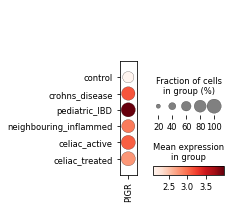

In [61]:
sc.pl.dotplot(muc6,var_names='PIGR',groupby='disease')

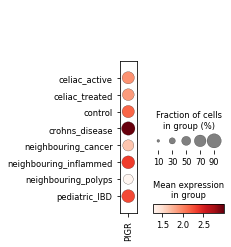

In [62]:
sc.pl.dotplot(adata,var_names='PIGR',groupby='disease')

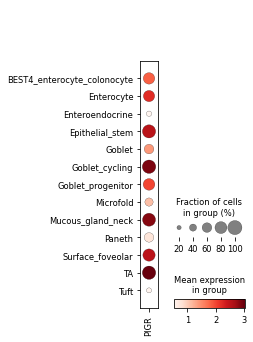

In [63]:
sc.pl.dotplot(adata,var_names='PIGR',groupby='level_3_annot')

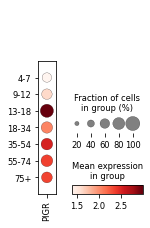

In [64]:
sc.pl.dotplot(adata,var_names='PIGR',groupby='age_unified')

In [65]:
muc6_dendrogram = muc6[~muc6.obs.disease.isin(['celiac_treated'])].copy()

         Falling back to preprocessing with `sc.pp.pca` and default params.


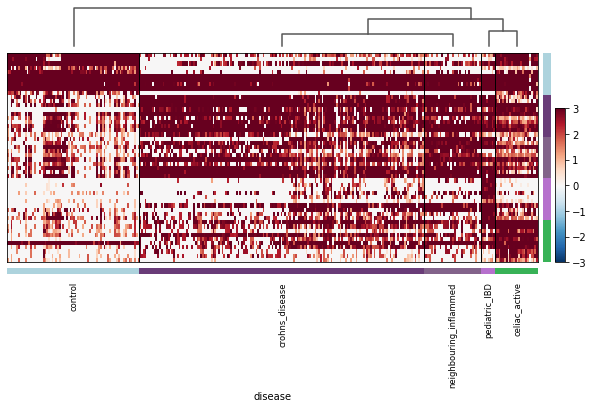

In [66]:
#dendrogram
sc.tl.rank_genes_groups(muc6_dendrogram,groupby='disease',method='wilcoxon')
sc.tl.dendrogram(muc6_dendrogram, groupby='disease')
sc.pl.rank_genes_groups_heatmap(muc6_dendrogram,groupby='disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='RdBu_r')

#### Import full data with all MUC6+ cells (stomach and intestines)

In [67]:
full_adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.h5ad')

In [68]:
full_adata.obs = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.csv',index_col=0)

/home/jovyan/my-conda-envs/standard_plot_gsea/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: DtypeWarning: Columns (3,5,6,8,9,11,12,14,62,63,64,65,66,67,70,73,75,82,83,84,86,92,93,95,100,101,102,105,106,108,109,111,112,113,114,115,117,119,123,124,125,126,127,128,129,130,131,132,133) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [69]:
full_adata

AnnData object with n_obs × n_vars = 1596203 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_s

In [70]:
#subset MUC6/MGN/INFLARE cells
full_muc6 = full_adata[full_adata.obs.level_3_annot.isin(['Mucous_gland_neck'])].copy()

In [71]:
full_muc6

AnnData object with n_obs × n_vars = 19058 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [72]:
full_muc6.obs.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/pooled_compartments/all_muc6_cells_rawcounts_20230613.csv')

In [73]:
df = pd.DataFrame(full_muc6.X.todense(), index=full_muc6.obs_names, columns=full_muc6.var_names)
#tranpose
df = df.T
df

index,AAACCTGCATGTAAGA-HCA_A_GT12935004,AAACGGGCATCGATTG-HCA_A_GT12935004,AAACGGGTCTGGTGTA-HCA_A_GT12935004,AAAGCAAAGCTGTCTA-HCA_A_GT12935004,AAAGCAAGTCAGTGGA-HCA_A_GT12935004,AACCATGTCCGAAGAG-HCA_A_GT12935004,AACTCAGAGGACAGCT-HCA_A_GT12935004,AACTCAGAGGGAAACA-HCA_A_GT12935004,AACTCTTAGACACTAA-HCA_A_GT12935004,AACTGGTTCCAGAGGA-HCA_A_GT12935004,...,GTTCTCGCAAGTTGTC-1_6-GI4288_DUO_EPI_GEX,TACTTACTCCAAGTAC-1_6-GI4288_DUO_EPI_GEX,TCCACACCACGTGAGA-1_6-GI4288_DUO_EPI_GEX,TGAGGGACATCCCATC-1_6-GI4288_DUO_EPI_GEX,TTGACTTCAAACCTAC-1_6-GI4288_DUO_EPI_GEX,TTGCCGTTCGAGAACG-1_6-GI4288_DUO_EPI_GEX,AATCCAGAGTTGAGAT-1_12-GI4359_DUO_EPI_GEX,CTGCGGATCAGTACGT-1_14-GI4394_DUO_EPI_GEX,GGTGCGTCAAGCCGTC-1_14-GI4394_DUO_EPI_GEX,TGCACCTCACGTTGGC-1_16-GI4401_DUO_EPI_GEX
AL627309.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
FAM87B,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
LINC00115,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
FAM41C,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
SAMD11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC145212.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AC011043.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
AC011841.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AL354822.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [74]:
df.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/DEG/counts/all_muc6_cells_rawcounts_20230613.csv')

In [75]:
del full_muc6.obs

In [76]:
full_muc6.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/pooled_compartments/all_muc6_cells_rawcounts_20230613.h5ad')

In [77]:
full_muc6.obs = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/pooled_compartments/all_muc6_cells_rawcounts_20230613.csv',index_col=0)

/home/jovyan/my-conda-envs/standard_plot_gsea/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: DtypeWarning: Columns (62,63,64,65,66,67,70,84,100,101,102,105,112,113,114,115,117,119,123,124,125,126,127,128,129,130,131,132,133) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [78]:
full_muc6

AnnData object with n_obs × n_vars = 19058 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [79]:
full_muc6.X.max()

18131.0

In [80]:
sc.pp.normalize_per_cell(full_muc6, counts_per_cell_after=1e4)
sc.pp.log1p(full_muc6)

In [81]:
#subcluster
sc.pp.neighbors(full_muc6, use_rep="X_scANVI")
sc.tl.umap(full_muc6)

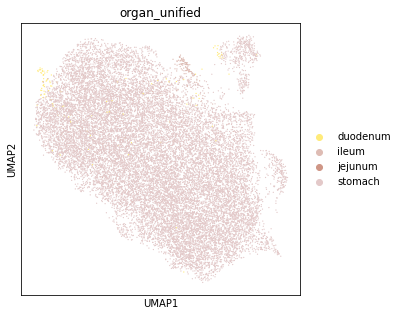

In [82]:
sc.pl.umap(full_muc6,color='organ_unified')

In [83]:
del full_muc6.uns['organ_unified_colors']

In [84]:
full_muc6

AnnData object with n_obs × n_vars = 19058 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

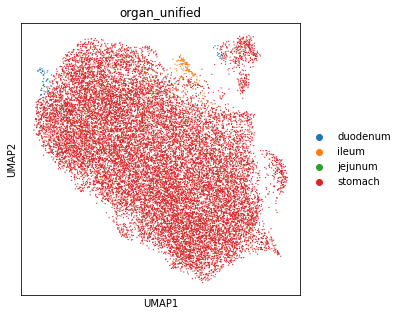

In [85]:
sc.pl.umap(full_muc6,color='organ_unified')

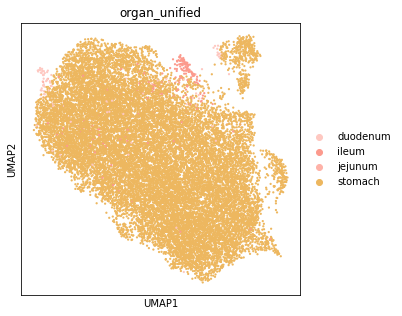

In [86]:
#plot by organ
sc.pl.umap(full_muc6,color='organ_unified',palette={
  'stomach': '#edb75f',
  'duodenum': '#fec8c1',
  'jejunum': '#feb2a8',
  'ileum': '#fc9a8d'},size=20)

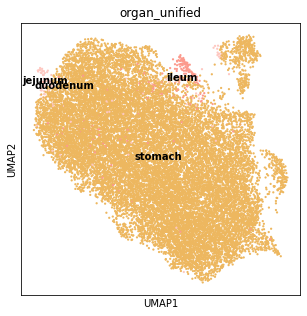

In [87]:
sc.pl.umap(full_muc6,color='organ_unified',palette={
  'stomach': '#edb75f',
  'duodenum': '#fec8c1',
  'jejunum': '#feb2a8',
  'ileum': '#fc9a8d'},size=20,legend_loc='on data')

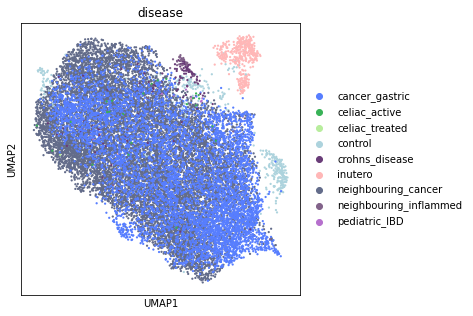

In [88]:
#plot by disease
sc.pl.umap(full_muc6,color='disease',palette = {'control': '#ADD3DD',
  'inutero': '#ffb7b7',
  'cancer_gastric': '#577eff',
  'crohns_disease': '#693C78',
  'pediatric_IBD': '#B670CD',
  'ulcerative_colitis': '#8934B1',
  'cancer_colorectal': '#1131bf',
  'preterm': '#f48154',
  'celiac_active': '#38B257',
  'celiac_treated': '#b8ed9d',
    'neighbouring_cancer': '#636c8a',
  'neighbouring_polyps': '#8a6375',
  'neighbouring_inflammed': '#82638a'               },size=20)


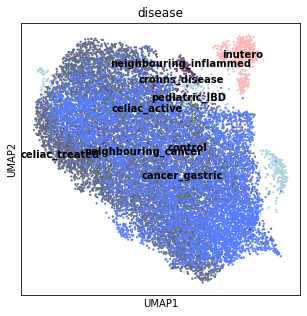

In [89]:
sc.pl.umap(full_muc6,color='disease',palette = {'control': '#ADD3DD',
  'inutero': '#ffb7b7',
  'cancer_gastric': '#577eff',
  'crohns_disease': '#693C78',
  'pediatric_IBD': '#B670CD',
  'ulcerative_colitis': '#8934B1',
  'cancer_colorectal': '#1131bf',
  'preterm': '#f48154',
  'celiac_active': '#38B257',
  'celiac_treated': '#b8ed9d',
    'neighbouring_cancer': '#636c8a',
  'neighbouring_polyps': '#8a6375',
  'neighbouring_inflammed': '#82638a'               },size=20,legend_loc='on data')


In [90]:
full_muc6.obs['organ_disease']= full_muc6.obs['organ_unified'].astype(str)+'_'+full_muc6.obs['disease'].astype(str)
full_muc6.obs.organ_disease.value_counts()

stomach_neighbouring_cancer     11669
stomach_cancer_gastric           6136
stomach_control                   567
stomach_inutero                   369
ileum_crohns_disease              159
duodenum_control                   71
ileum_neighbouring_inflammed       32
duodenum_celiac_active             24
duodenum_inutero                   19
ileum_pediatric_IBD                 8
jejunum_control                     2
ileum_control                       1
duodenum_celiac_treated             1
Name: organ_disease, dtype: int64

In [91]:
full_muc6.obs['organ_disease'] = full_muc6.obs['organ_disease'].astype('category')

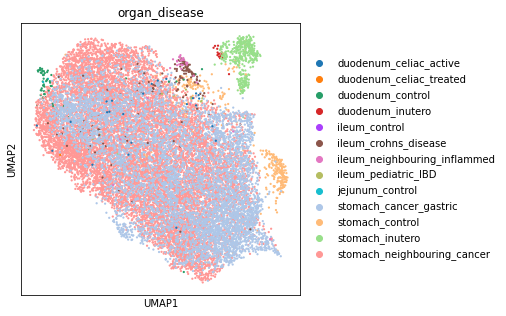

In [92]:
sc.pl.umap(full_muc6,color='organ_disease',size=20)

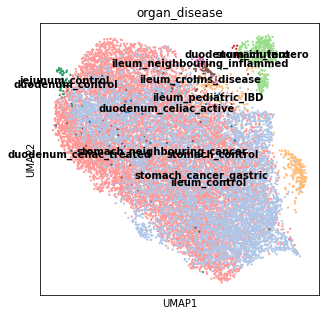

In [93]:
sc.pl.umap(full_muc6,color='organ_disease',size=20,legend_loc='on data')

In [94]:
import sctk as sk

In [95]:
#for plotting, remove categories with less than 2 cells
plot_full_muc6 = full_muc6[~full_muc6.obs.organ_disease.isin(['jejunum_control',
'ileum_control',
'duodenum_celiac_treated'])].copy()

In [96]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=150,dpi_save=300)

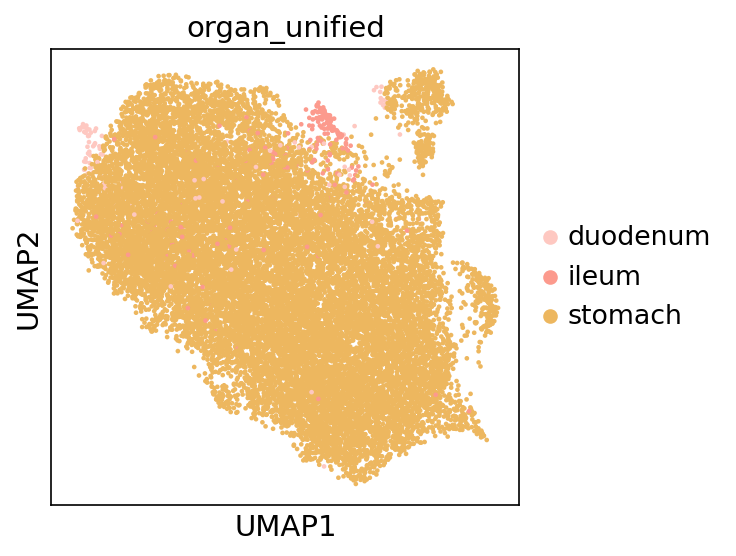

In [97]:
sc.pl.umap(plot_full_muc6,color='organ_unified',palette={
  'stomach': '#edb75f',
  'duodenum': '#fec8c1',
  'ileum': '#fc9a8d'},size=20,save='full_muc6_organ1.pdf')

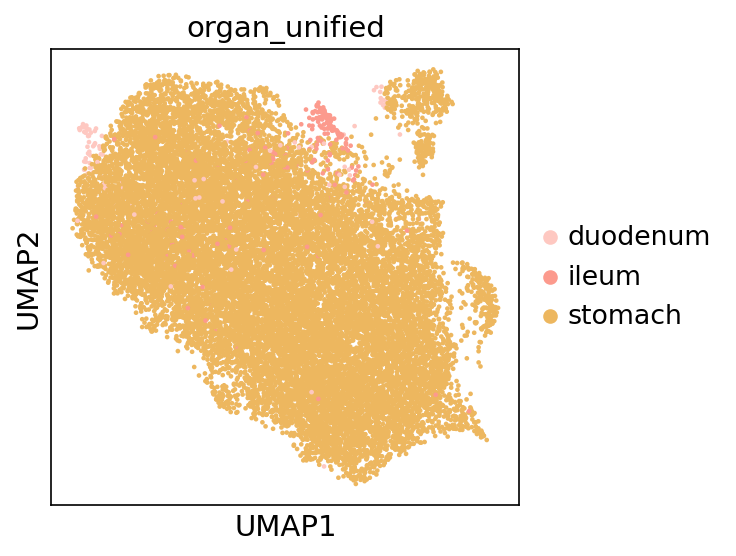

In [98]:
sc.pl.umap(plot_full_muc6,color='organ_unified',palette=[ '#fec8c1',#duo
                                                         '#fc9a8d',#ile
                                                         '#edb75f'#sto
                                                        ],size=20,save='full_muc6_organ1.png')

In [99]:
plot_full_muc6.obs.organ_unified.value_counts()

stomach     18741
ileum         199
duodenum      114
Name: organ_unified, dtype: int64

In [100]:
plot_full_muc6 = plot_full_muc6[plot_full_muc6.obs.organ_unified.isin(['stomach',
'ileum',
'duodenum'])].copy()

In [101]:
plot_full_muc6

AnnData object with n_obs × n_vars = 19054 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

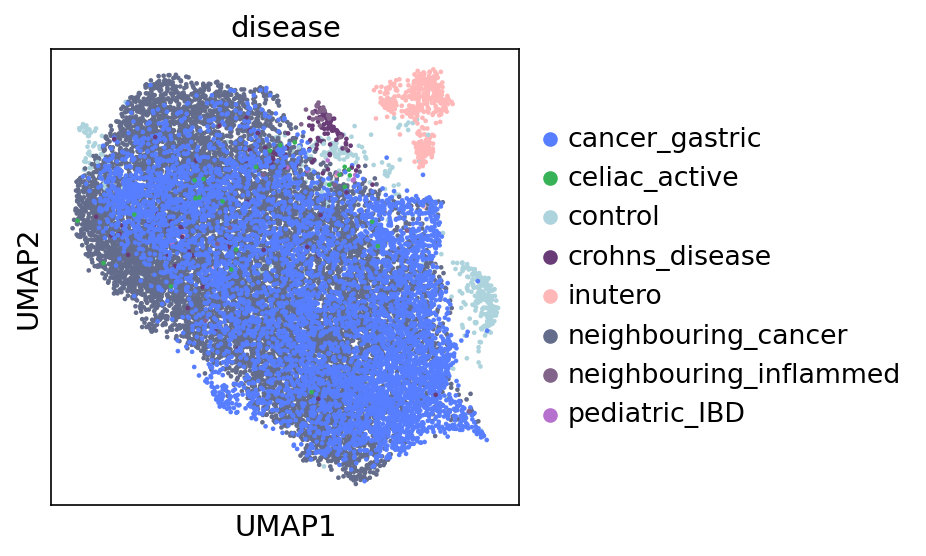

In [102]:
sc.pl.umap(plot_full_muc6,color='disease',palette = {'control': '#ADD3DD',
  'inutero': '#ffb7b7',
  'cancer_gastric': '#577eff',
  'crohns_disease': '#693C78',
  'pediatric_IBD': '#B670CD',
  'ulcerative_colitis': '#8934B1',
  'cancer_colorectal': '#1131bf',
  'preterm': '#f48154',
  'celiac_active': '#38B257',
  'celiac_treated': '#b8ed9d',
    'neighbouring_cancer': '#636c8a',
  'neighbouring_polyps': '#8a6375',
  'neighbouring_inflammed': '#82638a'               },size=20,save='full_muc6_disease1.pdf')


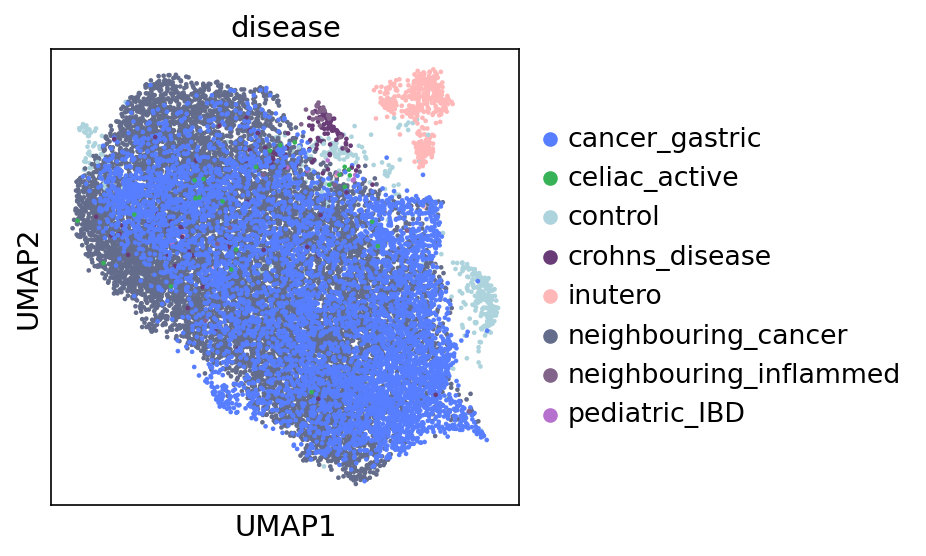

In [103]:
sc.pl.umap(plot_full_muc6,color='disease',palette = {'control': '#ADD3DD',
  'inutero': '#ffb7b7',
  'cancer_gastric': '#577eff',
  'crohns_disease': '#693C78',
  'pediatric_IBD': '#B670CD',
  'ulcerative_colitis': '#8934B1',
  'cancer_colorectal': '#1131bf',
  'preterm': '#f48154',
  'celiac_active': '#38B257',
  'celiac_treated': '#b8ed9d',
    'neighbouring_cancer': '#636c8a',
  'neighbouring_polyps': '#8a6375',
  'neighbouring_inflammed': '#82638a'               },size=20,save='full_muc6_disease1.png')


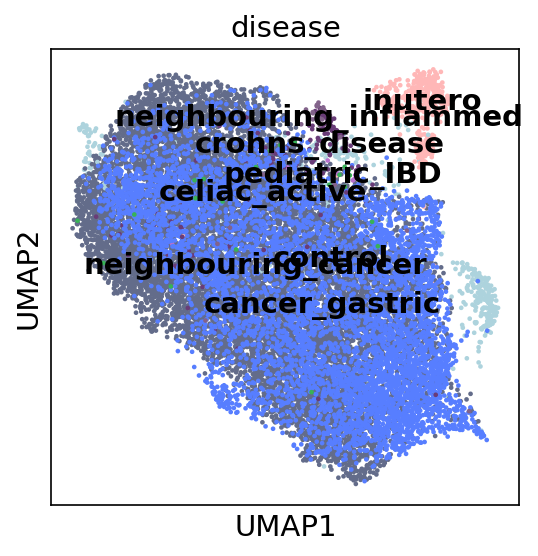

In [104]:
sc.pl.umap(plot_full_muc6,color='disease',size=20,legend_loc='on data',save='full_muc6_disease_legendloc.pdf')

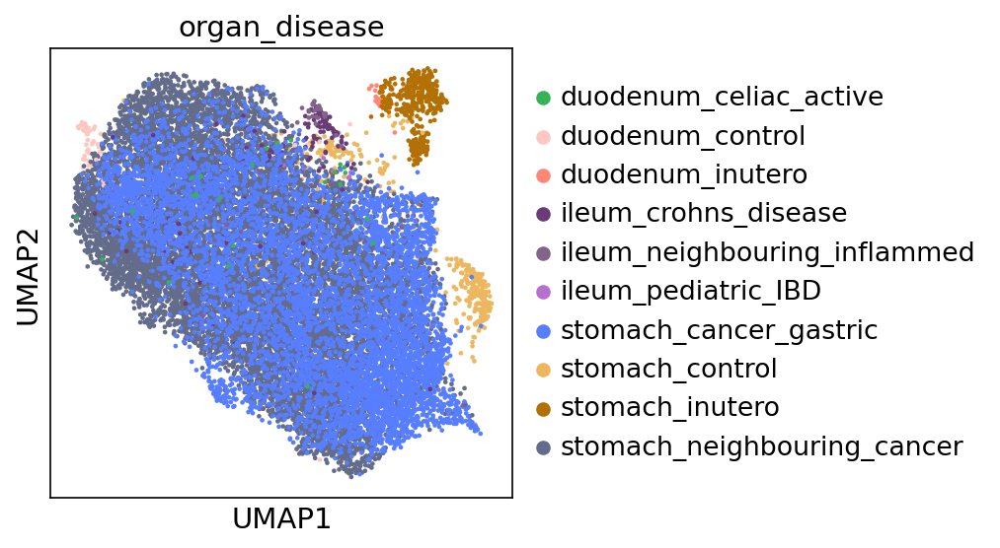

In [105]:
#plot by disease/organ combined - Extended data 9d
sc.pl.umap(plot_full_muc6,color='organ_disease',size=20,palette={'duodenum_control': '#fec8c1',
           'stomach_control': '#edb75f',
  'duodenum_inutero': '#ff8778',
            'stomach_inutero': '#b37004',
  'stomach_cancer_gastric': '#577eff',
  'ileum_crohns_disease': '#693C78',
  'ileum_pediatric_IBD': '#B670CD',
  
 
  'duodenum_celiac_active': '#38B257',
  
    'stomach_neighbouring_cancer': '#636c8a',
  
  'ileum_neighbouring_inflammed': '#82638a'    } ,save='full_muc6_organdisease1.pdf'       )

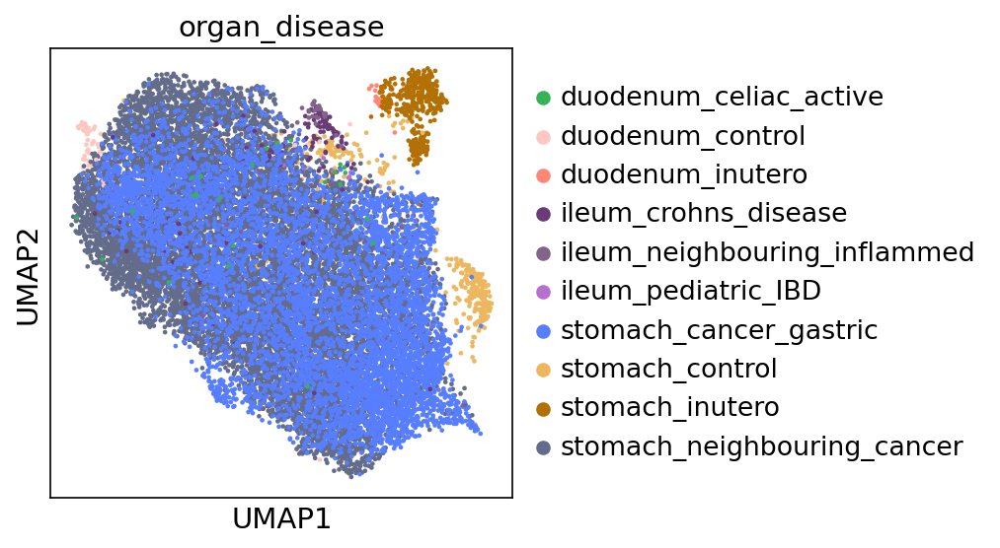

In [106]:
sc.pl.umap(plot_full_muc6,color='organ_disease',size=20,palette={'duodenum_control': '#fec8c1',
           'stomach_control': '#edb75f',
  'duodenum_inutero': '#ff8778',
            'stomach_inutero': '#b37004',
  'stomach_cancer_gastric': '#577eff',
  'ileum_crohns_disease': '#693C78',
  'ileum_pediatric_IBD': '#B670CD',
  
 
  'duodenum_celiac_active': '#38B257',
  
    'stomach_neighbouring_cancer': '#636c8a',
  
  'ileum_neighbouring_inflammed': '#82638a'    } ,save='full_muc6_organdisease1.png'       )

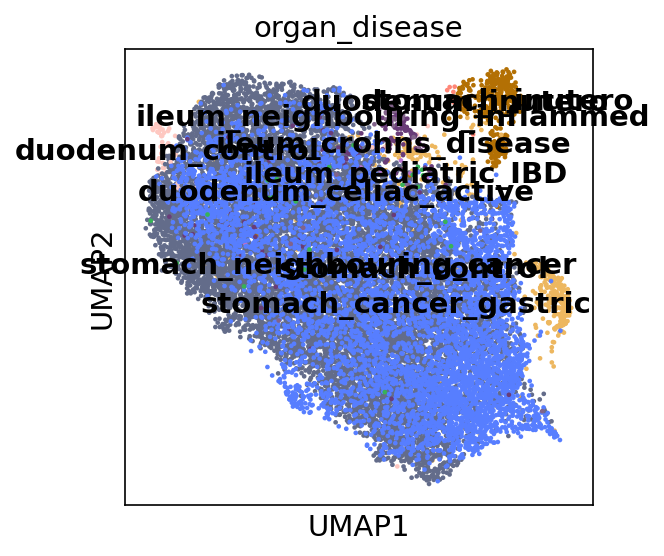

In [107]:
sc.pl.umap(plot_full_muc6,color='organ_disease',size=20,palette={'duodenum_control': '#fec8c1',
           'stomach_control': '#edb75f',
  'duodenum_inutero': '#ff8778',
            'stomach_inutero': '#b37004',
  'stomach_cancer_gastric': '#577eff',
  'ileum_crohns_disease': '#693C78',
  'ileum_pediatric_IBD': '#B670CD',
  
 
  'duodenum_celiac_active': '#38B257',
  
    'stomach_neighbouring_cancer': '#636c8a',
  
  'ileum_neighbouring_inflammed': '#82638a'    } ,save='full_muc6_organdisease1_legendlog.pdf',legend_loc='on data'       )

In [108]:
plot_full_muc6

AnnData object with n_obs × n_vars = 19054 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [109]:
del plot_full_muc6.uns['organ_disease_colors']

In [110]:
plot_full_muc6

AnnData object with n_obs × n_vars = 19054 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

         Falling back to preprocessing with `sc.pp.pca` and default params.


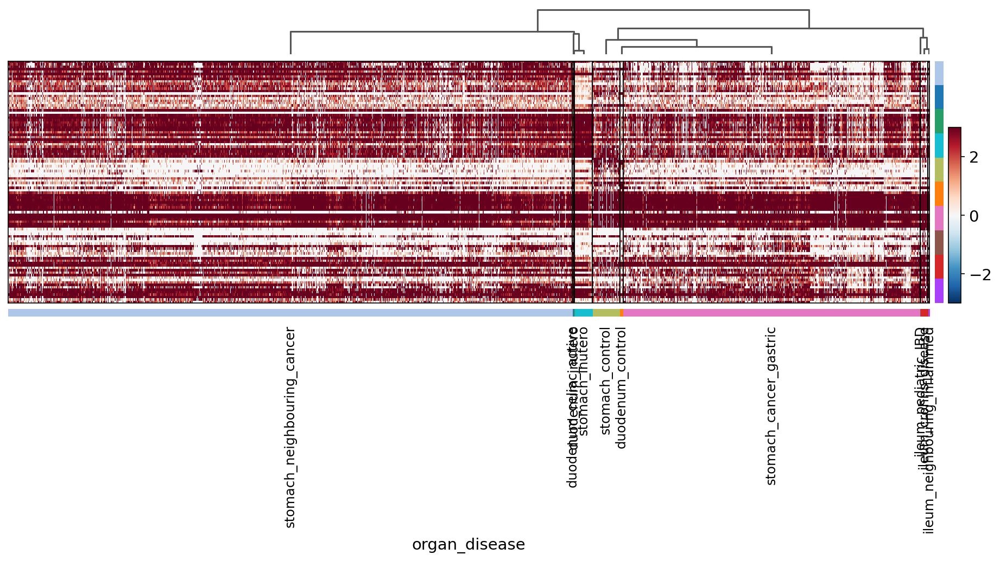

In [111]:
#dendrogram
sc.tl.rank_genes_groups(plot_full_muc6,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(plot_full_muc6, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(plot_full_muc6,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,5))

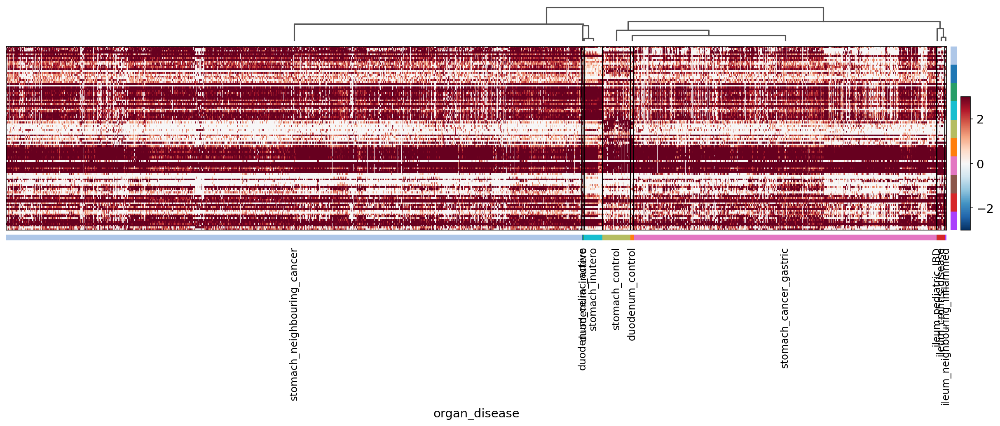

In [112]:
sc.pl.rank_genes_groups_heatmap(plot_full_muc6,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(20,5))

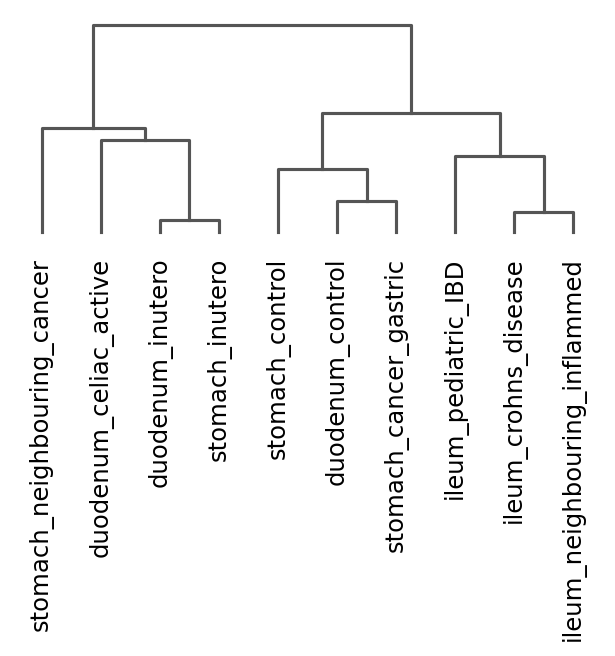

<AxesSubplot:>

In [113]:
plt.rcParams['figure.figsize'] = [5,2]
sc.pl.dendrogram(plot_full_muc6,groupby='organ_disease')

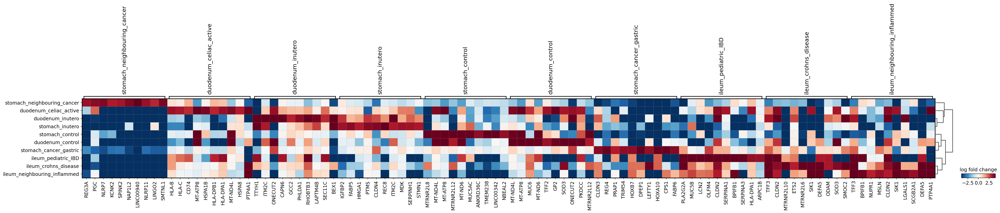

In [114]:
sc.pl.rank_genes_groups_matrixplot(
    plot_full_muc6,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
)

In [115]:
#function for downsampling
def downsample_mask(clustering, to_thin, n_cells=200):
    mask = np.array([i not in to_thin for i in clustering])
    numtemp = np.arange(len(clustering))
    for clus in to_thin:
        inds = set(numtemp[[i==clus for i in clustering]])
        keep = random.sample(inds, round(n_cells))
        mask[keep] = True
    return mask

In [116]:
#Prepare categories for downsampling (per donor_celltype combination)
plot_full_muc6.obs['donor_celltype']=plot_full_muc6.obs['donorID_unified'].astype(str)+'_'+plot_full_muc6.obs['level_3_annot'].astype(str)
plot_full_muc6.obs.donor_celltype.value_counts()

D131_Mucous_gland_neck    2558
D111_Mucous_gland_neck    1344
D120_Mucous_gland_neck    1277
D112_Mucous_gland_neck    1149
D110_Mucous_gland_neck    1039
D123_Mucous_gland_neck     873
D107_Mucous_gland_neck     851
D127_Mucous_gland_neck     781
D130_Mucous_gland_neck     722
D124_Mucous_gland_neck     678
D114_Mucous_gland_neck     647
D117_Mucous_gland_neck     603
D118_Mucous_gland_neck     561
D99_Mucous_gland_neck      519
D133_Mucous_gland_neck     471
D109_Mucous_gland_neck     434
D129_Mucous_gland_neck     401
D121_Mucous_gland_neck     355
D108_Mucous_gland_neck     349
D91_Mucous_gland_neck      318
D115_Mucous_gland_neck     311
D126_Mucous_gland_neck     280
D113_Mucous_gland_neck     229
D134_Mucous_gland_neck     213
D116_Mucous_gland_neck     204
D132_Mucous_gland_neck     192
F27_Mucous_gland_neck      181
D147_Mucous_gland_neck     169
D125_Mucous_gland_neck     131
D92_Mucous_gland_neck      129
D191_Mucous_gland_neck     125
D119_Mucous_gland_neck     120
D106_Muc

# Downsampled muc6 cells

In [117]:
#Downsample
vc=plot_full_muc6.obs.donor_celltype.value_counts().loc[lambda x: x>200].reset_index()['index']
mask_p = downsample_mask(plot_full_muc6.obs['donor_celltype'], vc.tolist(), n_cells=200)
muc6_downsample = plot_full_muc6[mask_p]
muc6_downsample.obs.donor_celltype.value_counts()

D99_Mucous_gland_neck     200
D111_Mucous_gland_neck    200
D129_Mucous_gland_neck    200
D127_Mucous_gland_neck    200
D126_Mucous_gland_neck    200
D124_Mucous_gland_neck    200
D123_Mucous_gland_neck    200
D121_Mucous_gland_neck    200
D120_Mucous_gland_neck    200
D118_Mucous_gland_neck    200
D117_Mucous_gland_neck    200
D116_Mucous_gland_neck    200
D115_Mucous_gland_neck    200
D114_Mucous_gland_neck    200
D131_Mucous_gland_neck    200
D112_Mucous_gland_neck    200
D113_Mucous_gland_neck    200
D110_Mucous_gland_neck    200
D133_Mucous_gland_neck    200
D134_Mucous_gland_neck    200
D109_Mucous_gland_neck    200
D91_Mucous_gland_neck     200
D107_Mucous_gland_neck    200
D108_Mucous_gland_neck    200
D130_Mucous_gland_neck    200
D132_Mucous_gland_neck    192
F27_Mucous_gland_neck     181
D147_Mucous_gland_neck    169
D125_Mucous_gland_neck    131
D92_Mucous_gland_neck     129
D191_Mucous_gland_neck    125
D119_Mucous_gland_neck    120
D106_Mucous_gland_neck    118
F26_Mucous

In [118]:
sc.tl.dendrogram(muc6_downsample, groupby='disease')

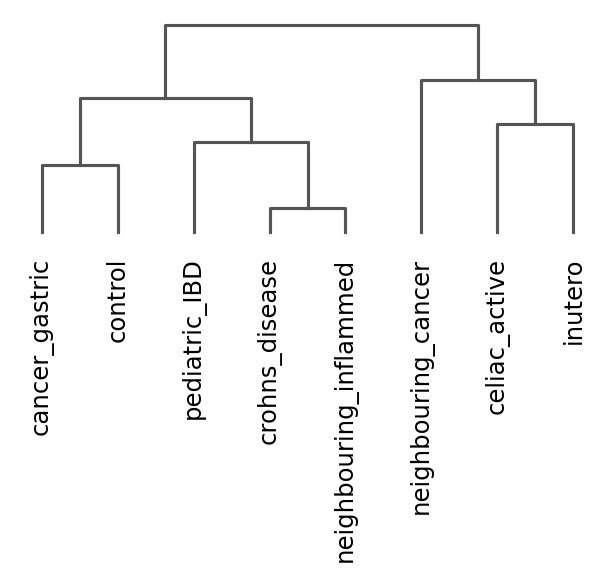

<AxesSubplot:>

In [119]:
plt.rcParams['figure.figsize'] = [5,2]
sc.pl.dendrogram(muc6_downsample,groupby='disease')

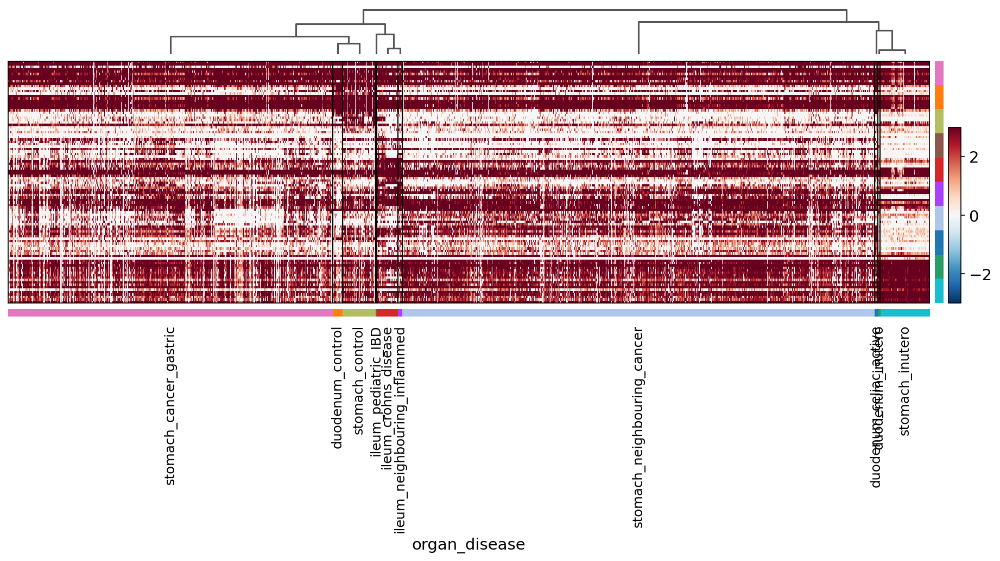

In [120]:
#dendrogram
sc.tl.rank_genes_groups(muc6_downsample,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(muc6_downsample, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(muc6_downsample,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,5))

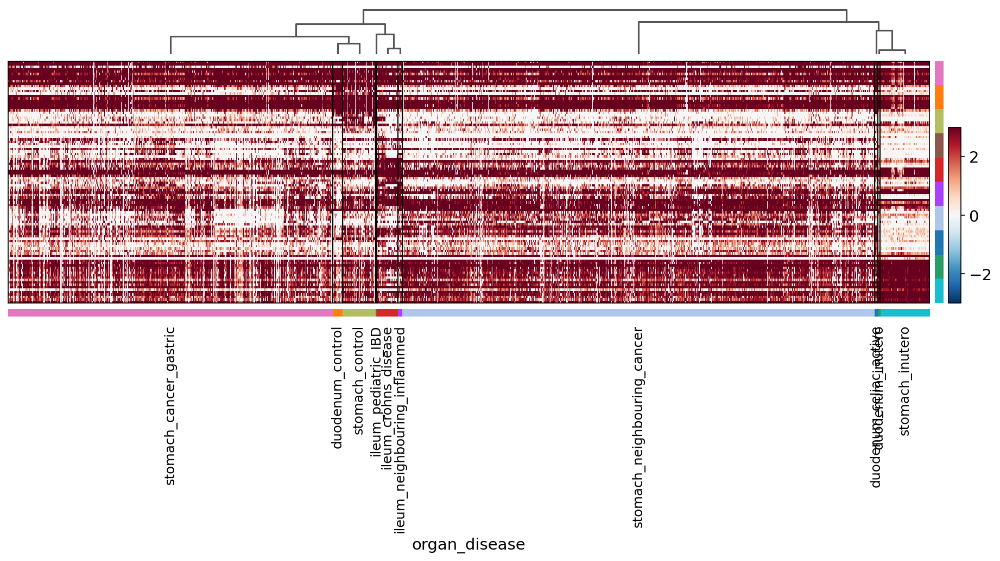

In [121]:
#dendrogram
sc.tl.rank_genes_groups(muc6_downsample,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(muc6_downsample, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(muc6_downsample,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,5))

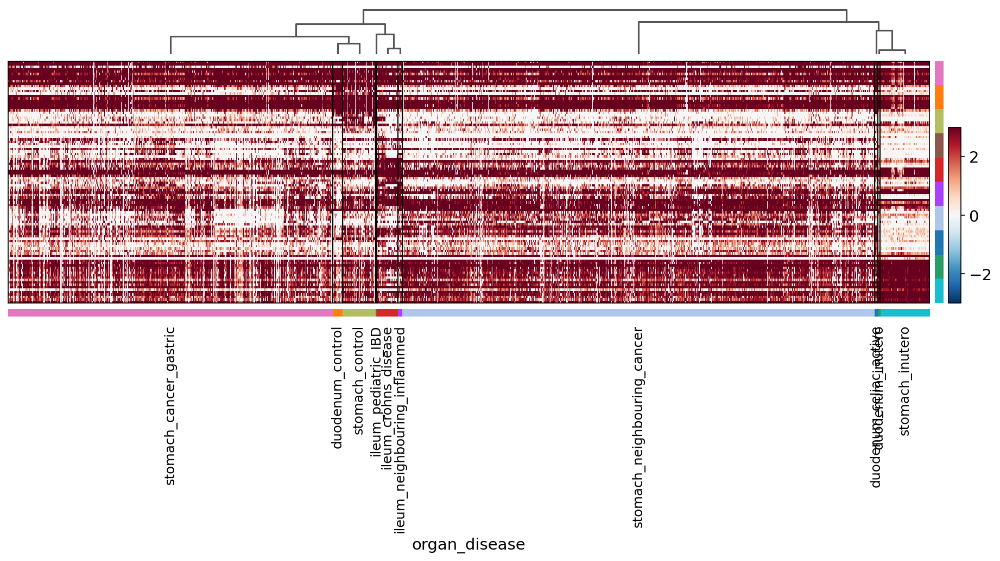

In [122]:
sc.pl.rank_genes_groups_heatmap(muc6_downsample,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,5),save='muc6_downsample_dendro.pdf')

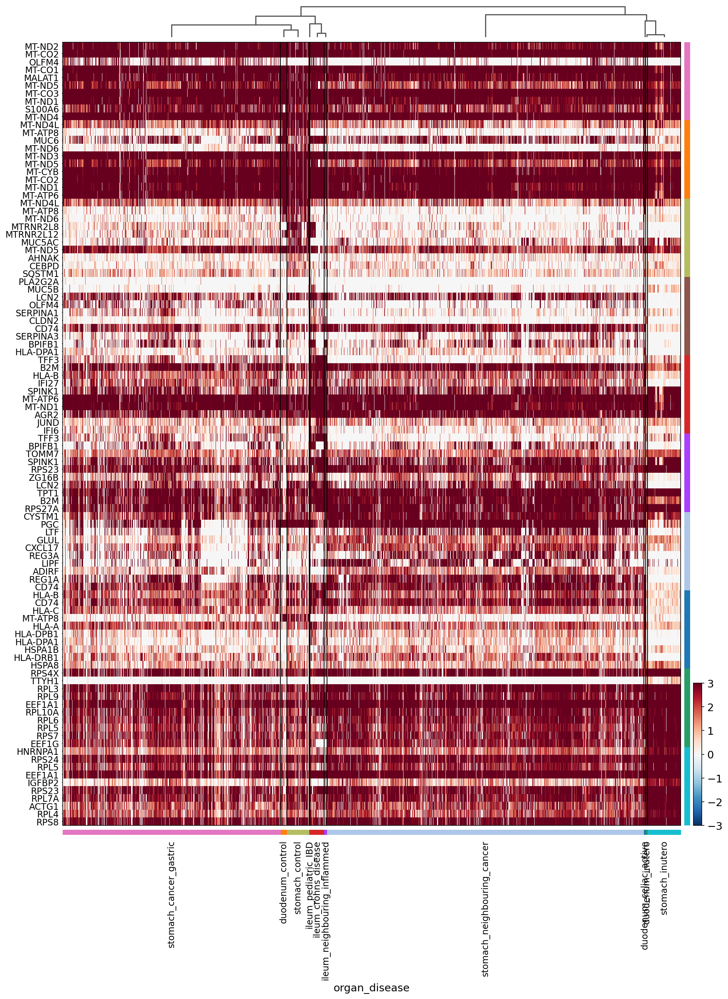

In [123]:
sc.pl.rank_genes_groups_heatmap(muc6_downsample,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, 
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,20), show_gene_labels=True)#save='muc6_downsample_dendro.pdf')

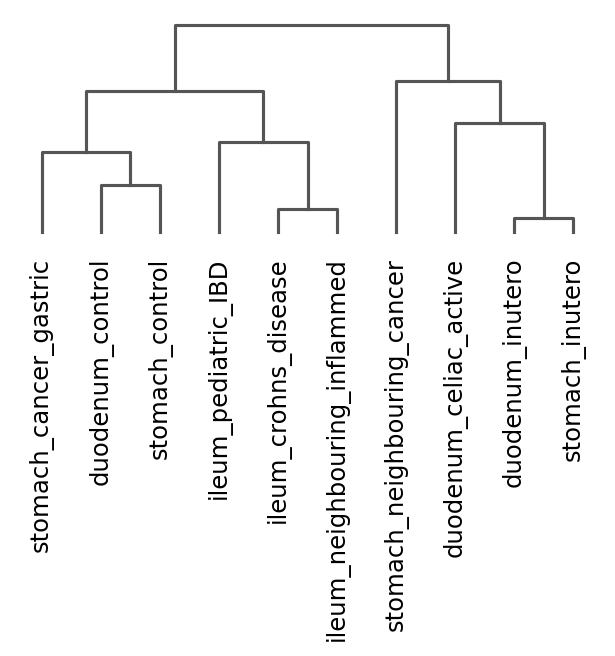

<AxesSubplot:>

In [124]:
plt.rcParams['figure.figsize'] = [5,2]
sc.pl.dendrogram(muc6_downsample,groupby='organ_disease')

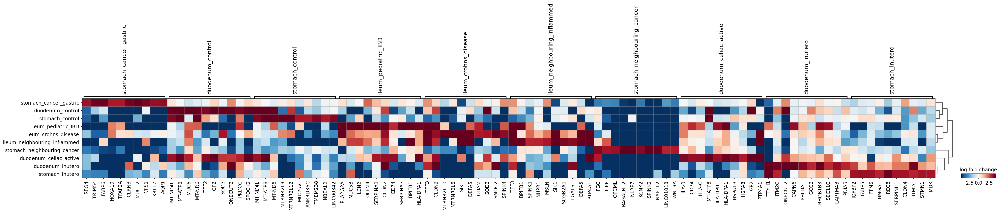

In [125]:
sc.pl.rank_genes_groups_matrixplot(
    muc6_downsample,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
)

In [126]:
muc6_downsample

AnnData object with n_obs × n_vars = 6887 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

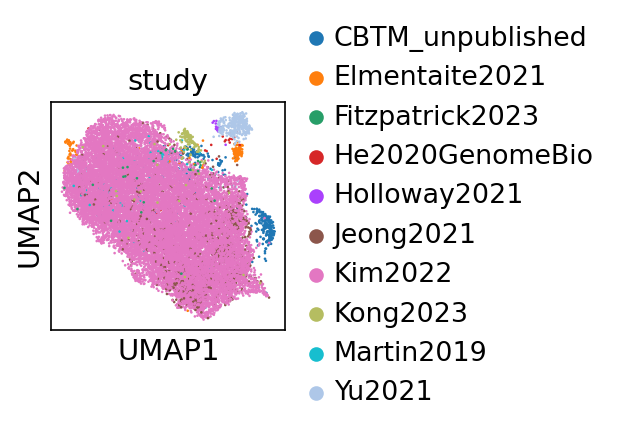

In [127]:
plt.rcParams['figure.figsize'] = [2,2]
sc.pl.umap(plot_full_muc6,color='study')

In [128]:
plot_full_muc6

AnnData object with n_obs × n_vars = 19054 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

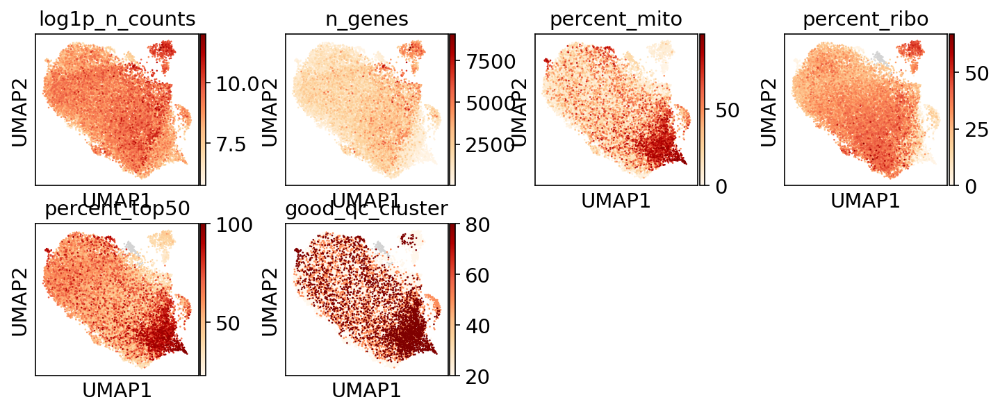

In [129]:
sc.pl.umap(plot_full_muc6,color=['log1p_n_counts','n_genes','percent_mito','percent_ribo','percent_top50','good_qc_cluster'],cmap='OrRd')

remove mitochondrial and ribosomal genes before calculating differentially expressed genes

# MUC6 comparison downsampled without MT/Ribo genes

In [130]:
#remove technical artifacts from malat, mito and ribo genes from matrix
malat1 = adata.var_names.str.startswith('MALAT1')
mito_genes1 = adata.var_names.str.startswith('MT-')
mito_genes2 = adata.var_names.str.startswith('MTRNR')
ribo_genes1 = adata.var_names.str.startswith('RPL')
ribo_genes2 = adata.var_names.str.startswith('RPS')


remove = np.add(mito_genes1, mito_genes2)
remove = np.add(remove, ribo_genes1)
remove = np.add(remove, ribo_genes2)
remove = np.add(remove, malat1)
keep = np.invert(remove)

muc6_deg = muc6_downsample[:,keep]

print(muc6_deg.n_obs, muc6_deg.n_vars)

6887 18360


In [131]:
muc6_deg

View of AnnData object with n_obs × n_vars = 6887 × 18360
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts

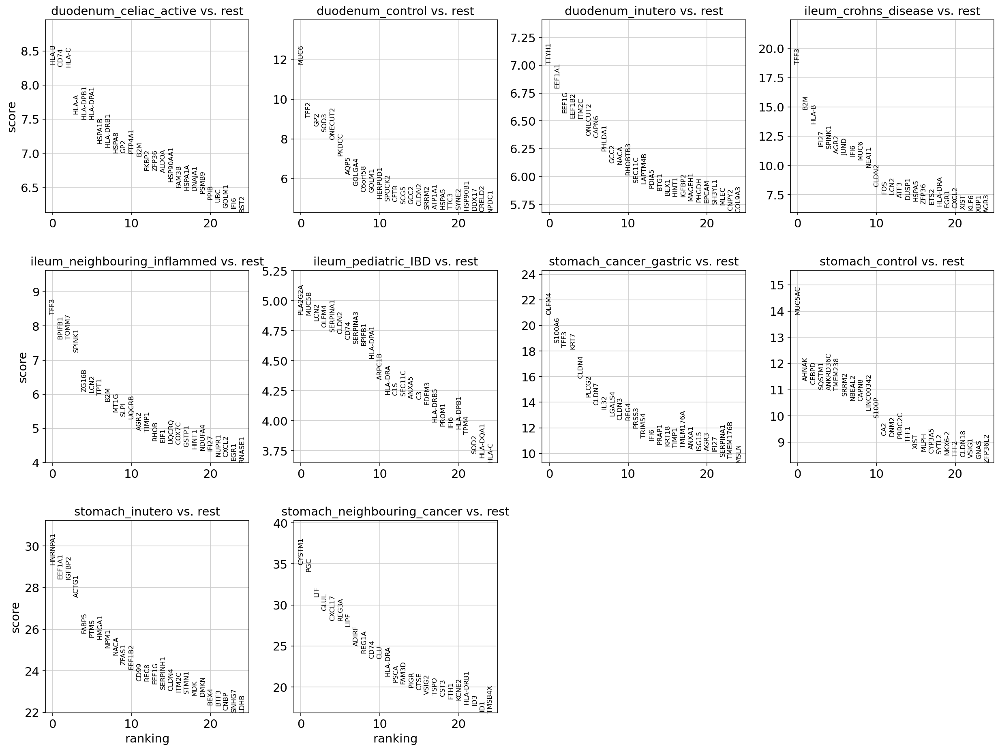

In [132]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',method='wilcoxon')
sc.pl.rank_genes_groups(muc6_deg, n_genes=25, sharey=False)

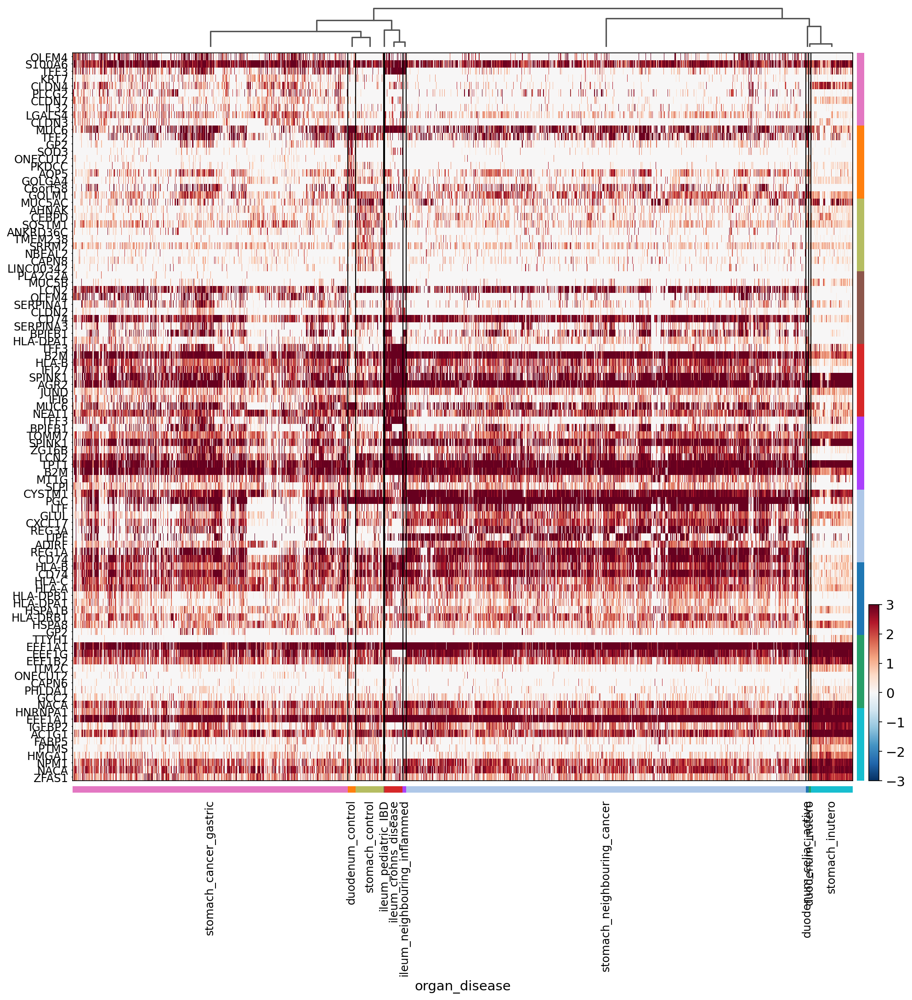

In [133]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(muc6_deg, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(muc6_deg,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,15),save='muc6_downsample_noMTorRPgenes_heatmap.pdf')

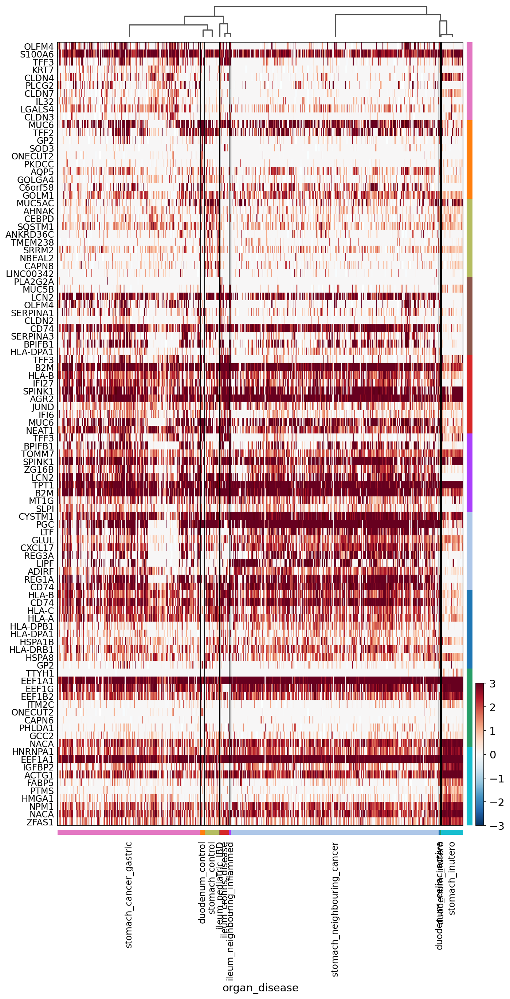

In [134]:
sc.pl.rank_genes_groups_heatmap(muc6_deg,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(10,20),save='muc6_downsample_noMTorRPgenes_heatmap.pdf')

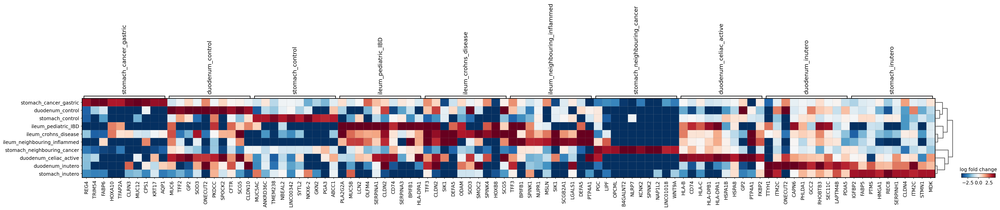

In [135]:
sc.pl.rank_genes_groups_matrixplot(
    muc6_deg,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
)

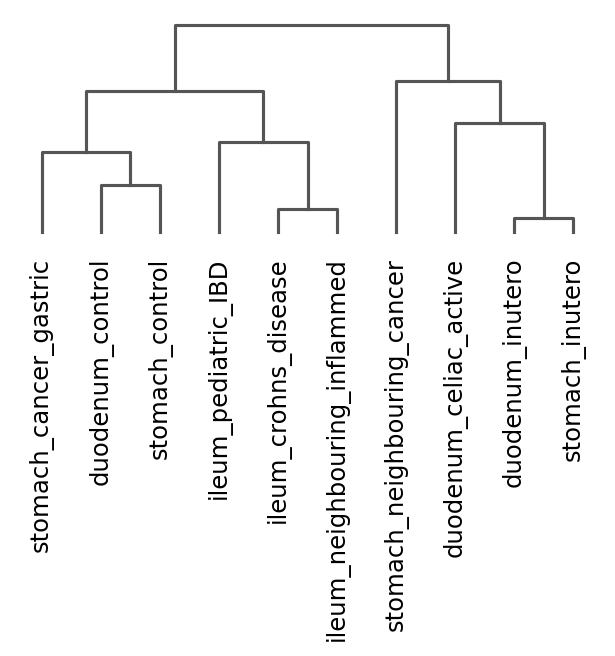

<AxesSubplot:>

In [136]:
plt.rcParams['figure.figsize'] = [5,2]
sc.pl.dendrogram(muc6_deg,groupby='organ_disease')

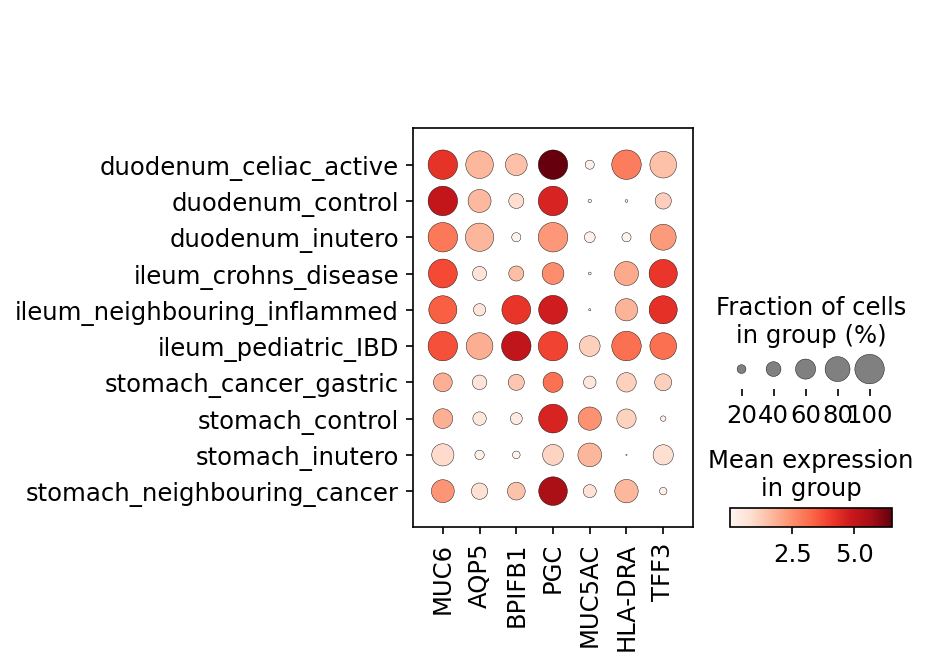

In [137]:
sc.pl.dotplot(muc6_deg,var_names=['MUC6','AQP5','BPIFB1','PGC','MUC5AC','HLA-DRA','TFF3'],groupby='organ_disease')

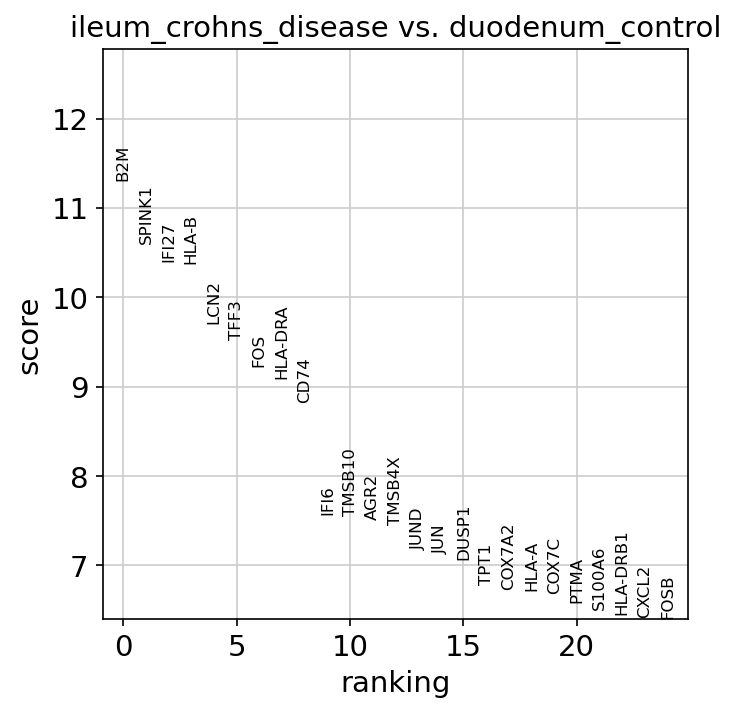

In [138]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['ileum_crohns_disease'], reference='duodenum_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_deg, n_genes=25, sharey=False, key="wilcoxon")

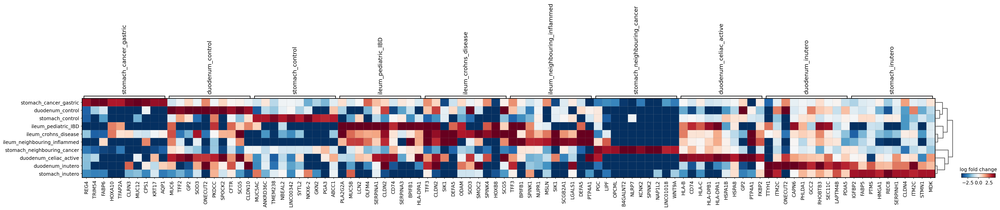

In [139]:
sc.pl.rank_genes_groups_matrixplot(
    muc6_deg,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
)

In [140]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_deg, group='ileum_crohns_disease', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

88


In [141]:
disease_vs_ileum = glist

In [142]:
disease_vs_duodenum = disease_vs_ileum

In [143]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

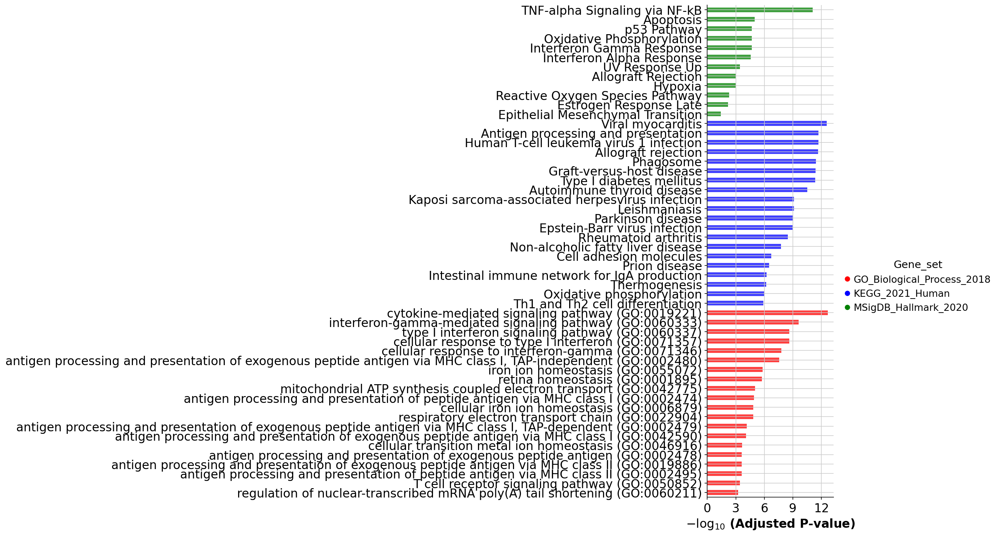

In [144]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['red', 'blue','green'] # set colors for group
             )

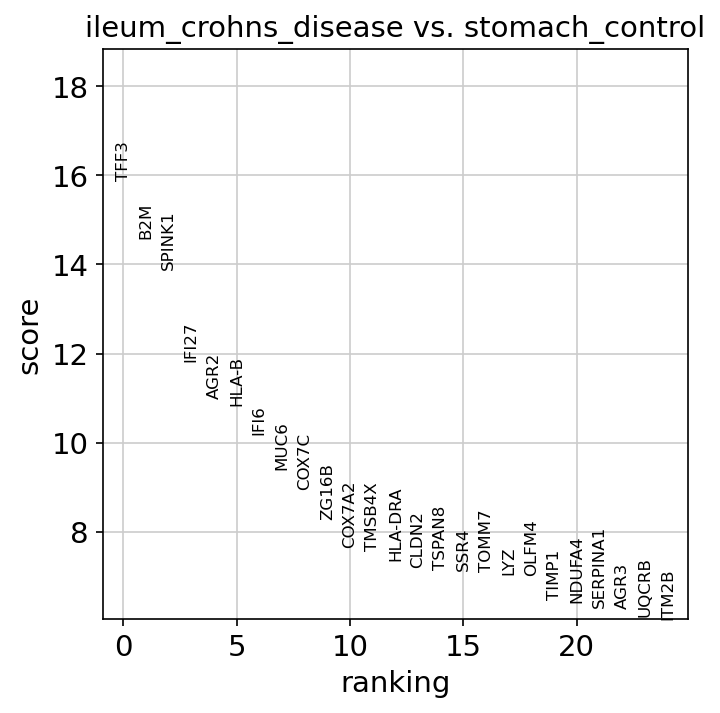

In [145]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['ileum_crohns_disease'], reference='stomach_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_deg, n_genes=25, sharey=False, key="wilcoxon")

In [146]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_deg, group='ileum_crohns_disease', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

102


In [147]:
disease_vs_stomach = glist

In [148]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

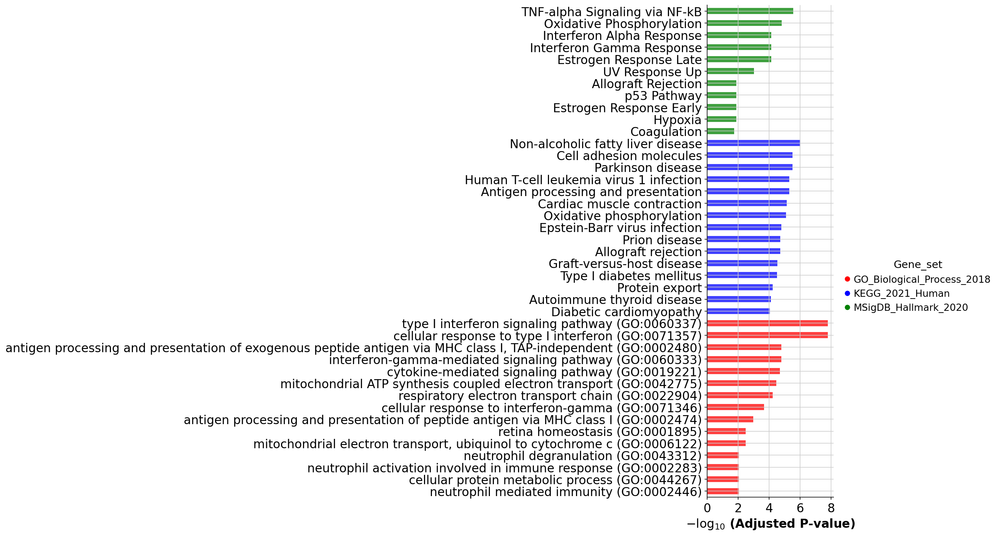

In [149]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=15,
              figsize=(3,12), 
              color=['red', 'blue','green'] # set colors for group
             )

In [150]:
muc6_deg.obs.organ_disease.value_counts()

stomach_neighbouring_cancer     3529
stomach_cancer_gastric          2428
stomach_inutero                  369
stomach_control                  248
ileum_crohns_disease             159
duodenum_control                  71
ileum_neighbouring_inflammed      32
duodenum_celiac_active            24
duodenum_inutero                  19
ileum_pediatric_IBD                8
Name: organ_disease, dtype: int64

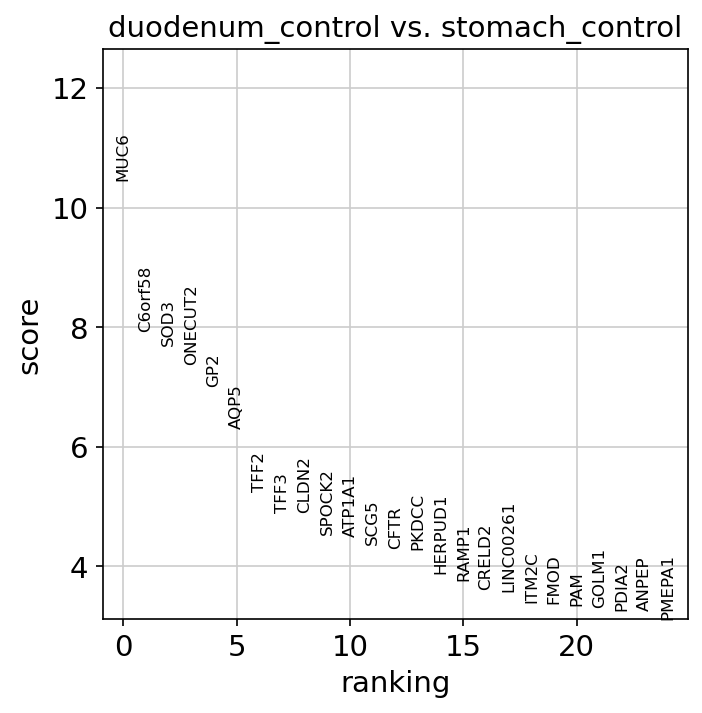

In [151]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['duodenum_control'], reference='stomach_control', method='wilcoxon')
sc.pl.rank_genes_groups(muc6_deg, n_genes=25, sharey=False)

In [152]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_deg, group='duodenum_control', 
                                     log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

18


In [153]:
stomach_vs_duodenum = glist

In [154]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

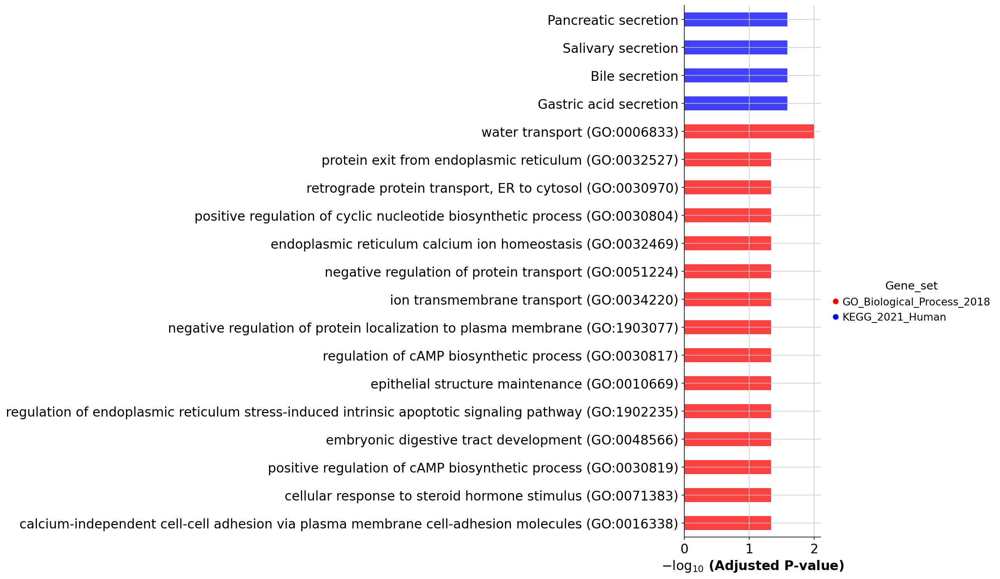

In [155]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=15,
              figsize=(3,12), 
              color=['red', 'blue','green'] # set colors for group
             )

make venn diagrams for DEG between 3 groups (crohn's vs duodenum, crohn's vs stomach, stomach vs duodenum)

In [156]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['duodenum_control'], reference='stomach_control', method='wilcoxon')
stomach_vs_duodenum = sc.get.rank_genes_groups_df(muc6_deg, group='duodenum_control',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(stomach_vs_duodenum))

170


In [157]:
muc6_deg.obs.organ_disease.value_counts()

stomach_neighbouring_cancer     3529
stomach_cancer_gastric          2428
stomach_inutero                  369
stomach_control                  248
ileum_crohns_disease             159
duodenum_control                  71
ileum_neighbouring_inflammed      32
duodenum_celiac_active            24
duodenum_inutero                  19
ileum_pediatric_IBD                8
Name: organ_disease, dtype: int64

In [158]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['ileum_crohns_disease'], reference='stomach_control', method='wilcoxon',key_added = "wilcoxon")
disease_vs_stomach = sc.get.rank_genes_groups_df(muc6_deg, group='ileum_crohns_disease', 
                                    key='wilcoxon', 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(disease_vs_stomach))

879


In [159]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['ileum_crohns_disease'], reference='duodenum_control', method='wilcoxon',key_added = "wilcoxon")

disease_vs_duodenum = sc.get.rank_genes_groups_df(muc6_deg, group='ileum_crohns_disease', 
                                    key='wilcoxon', 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(disease_vs_duodenum))

110


In [160]:
pip install matplotlib-venn

Note: you may need to restart the kernel to use updated packages.


In [161]:
disease_vs_duodenum

['B2M',
 'SPINK1',
 'IFI27',
 'HLA-B',
 'LCN2',
 'TFF3',
 'FOS',
 'HLA-DRA',
 'CD74',
 'IFI6',
 'TMSB10',
 'AGR2',
 'TMSB4X',
 'JUND',
 'JUN',
 'DUSP1',
 'TPT1',
 'COX7A2',
 'HLA-A',
 'COX7C',
 'PTMA',
 'S100A6',
 'HLA-DRB1',
 'CXCL2',
 'FOSB',
 'CYBA',
 'ZFP36',
 'ATF3',
 'ZG16B',
 'KLF6',
 'EGR1',
 'UBB',
 'UQCRB',
 'TOMM7',
 'EEF1A1',
 'RHOB',
 'HLA-C',
 'HLA-DPA1',
 'NDUFA4',
 'SSR4',
 'SMIM22',
 'PIGR',
 'COX6C',
 'TXN',
 'FAU',
 'NDUFB1',
 'H3F3A',
 'H3F3B',
 'FAM3D',
 'SAT1',
 'HLA-DPB1',
 'FTL',
 'UBA52',
 'ISG15',
 'LIPF',
 'AGR3',
 'SEC61G',
 'FTH1',
 'HLA-DRB5',
 'BTG2',
 'UQCRH',
 'XIST',
 'SRP14',
 'CALM2',
 'IFITM3',
 'S100A10',
 'ACTB',
 'S100P',
 'COMMD6',
 'CXCL3',
 'TSPAN8',
 'SLPI',
 'UQCRQ',
 'OST4',
 'ACTG1',
 'SERF2',
 'MIA',
 'POLR2L',
 'TIMP1',
 'HLA-E',
 'PABPC1',
 'ETS2',
 'HINT1',
 'ITM2B',
 'TM4SF1',
 'FKBP2',
 'SOD1',
 'FXYD3',
 'ANXA4',
 'HSPG2',
 'SPOCK2',
 'DDX17',
 'CRELD2',
 'GOLGA4',
 'IGFBP2',
 'DDX39B',
 'PDIA2',
 'NPDC1',
 'SRRM2',
 'LINC00261',
 '

In [162]:
from matplotlib_venn import venn3

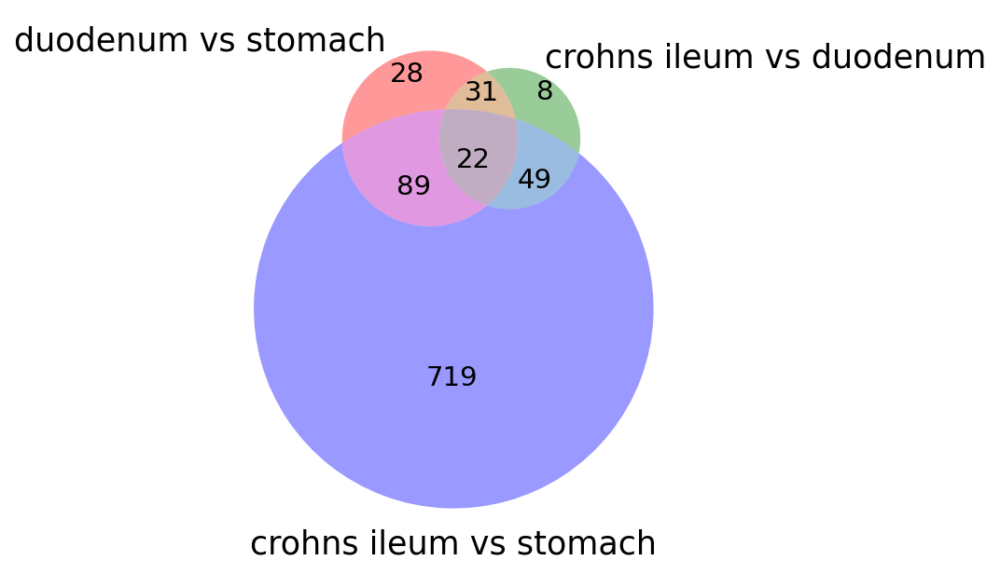

In [163]:
set1 = set(stomach_vs_duodenum)
set2 = set(disease_vs_duodenum)
set3 = set(disease_vs_stomach)

venn3([set1, set2, set3], ('duodenum vs stomach', 'crohns ileum vs duodenum', 'crohns ileum vs stomach'))

plt.show()

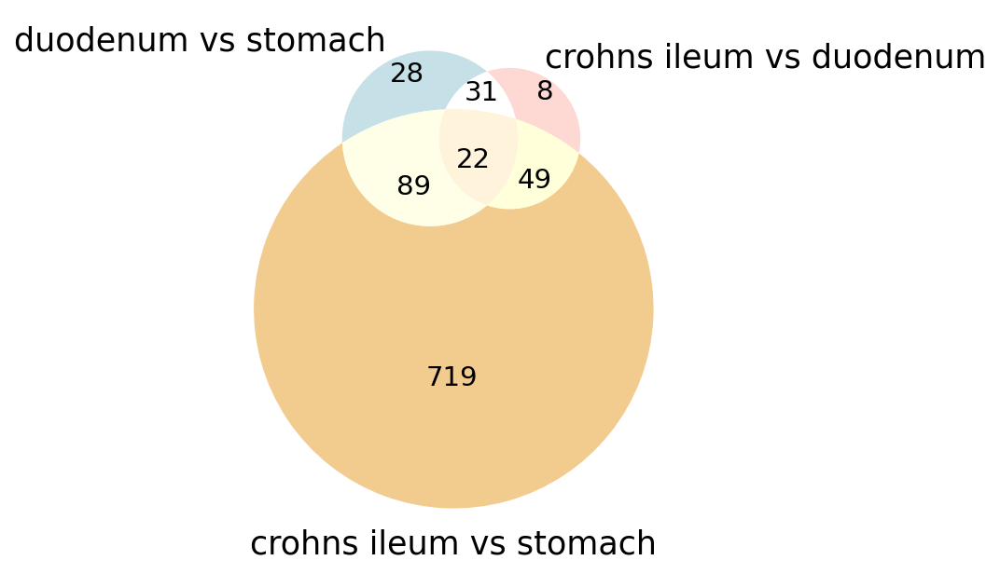

In [164]:
venn3([set1, set2, set3], set_labels=('duodenum vs stomach', 'crohns ileum vs duodenum', 'crohns ileum vs stomach'),set_colors=('#ADD3DD', '#fec8c1','#edb75f'), alpha = 0.7)
plt.savefig('venn_test.pdf')

In [165]:
#extract overlapping gene lists

set1 = set(stomach_vs_duodenum)
set2 = set(disease_vs_duodenum)
set3 = set(disease_vs_stomach)

common_disease = set2.intersection(set3)
print("Overlapping genes:", common_disease)


Overlapping genes: {'TFF2', 'UQCRQ', 'GOLGA4', 'TMSB4X', 'HLA-DRA', 'ZG16B', 'PIGR', 'PGC', 'TFF3', 'IFI27', 'GOLM1', 'SPINK1', 'B2M', 'S100P', 'FAM3D', 'SSR4', 'COX7A2', 'EGR1', 'ATF3', 'HLA-A', 'ETS2', 'FKBP2', 'JUND', 'HINT1', 'HLA-C', 'MIA', 'KLF6', 'SEC61G', 'COX7C', 'ITM2B', 'HLA-B', 'HLA-DPA1', 'NDUFA4', 'DUSP1', 'TSPAN8', 'LIPF', 'NDUFB1', 'COX6C', 'FXYD3', 'IGFBP2', 'SMIM22', 'EEF1A1', 'SAT1', 'IFI6', 'CXCL2', 'ISG15', 'DDX17', 'DDX39B', 'ANXA4', 'SOD3', 'UQCRH', 'FOS', 'H3F3A', 'AGR2', 'OST4', 'MUC6', 'SRRM2', 'S100A10', 'SLPI', 'SRP14', 'TOMM7', 'TM4SF1', 'FOSB', 'FAU', 'MEIS2', 'PKDCC', 'AGR3', 'HSPG2', 'COMMD6', 'UQCRB', 'TIMP1'}


In [166]:
print(len(common_disease))

71


In [167]:
all_common = set(common_disease).intersection(set1)
print("Overlapping genes:", all_common)

Overlapping genes: {'TFF2', 'TMSB4X', 'HLA-DRA', 'IFI27', 'TFF3', 'B2M', 'S100P', 'EGR1', 'ATF3', 'HLA-A', 'JUND', 'HLA-C', 'KLF6', 'HLA-B', 'DUSP1', 'SAT1', 'CXCL2', 'SOD3', 'FOS', 'MUC6', 'FOSB', 'PKDCC'}


In [168]:
print(len(all_common))

22


In [169]:
all_common

{'ATF3',
 'B2M',
 'CXCL2',
 'DUSP1',
 'EGR1',
 'FOS',
 'FOSB',
 'HLA-A',
 'HLA-B',
 'HLA-C',
 'HLA-DRA',
 'IFI27',
 'JUND',
 'KLF6',
 'MUC6',
 'PKDCC',
 'S100P',
 'SAT1',
 'SOD3',
 'TFF2',
 'TFF3',
 'TMSB4X'}

In [170]:
genes_to_remove = set(all_common)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, common_disease))
print(gene_list)

['UQCRQ', 'GOLGA4', 'ZG16B', 'PIGR', 'PGC', 'GOLM1', 'SPINK1', 'FAM3D', 'SSR4', 'COX7A2', 'ETS2', 'FKBP2', 'HINT1', 'MIA', 'SEC61G', 'COX7C', 'ITM2B', 'HLA-DPA1', 'NDUFA4', 'TSPAN8', 'LIPF', 'NDUFB1', 'COX6C', 'FXYD3', 'IGFBP2', 'SMIM22', 'EEF1A1', 'IFI6', 'ISG15', 'DDX17', 'DDX39B', 'ANXA4', 'UQCRH', 'H3F3A', 'AGR2', 'OST4', 'SRRM2', 'S100A10', 'SLPI', 'SRP14', 'TOMM7', 'TM4SF1', 'FAU', 'MEIS2', 'AGR3', 'HSPG2', 'COMMD6', 'UQCRB', 'TIMP1']


In [171]:
print(len(gene_list))

49


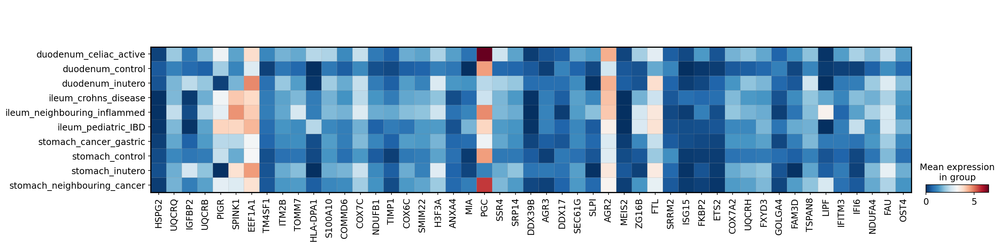

In [172]:
var_names = ['HSPG2', 'UQCRQ', 'IGFBP2', 'UQCRB', 'PIGR', 'SPINK1', 'EEF1A1', 
             'TM4SF1', 'ITM2B', 'TOMM7', 'HLA-DPA1', 'S100A10', 'COMMD6', 'COX7C', 
             'NDUFB1', 'TIMP1', 'COX6C', 'SMIM22', 'H3F3A', 'ANXA4', 'MIA', 'PGC', 'SSR4', 
             'SRP14', 'DDX39B', 'AGR3', 'DDX17', 'SEC61G', 'SLPI', 'AGR2', 'MEIS2', 'ZG16B',
             'FTL', 'SRRM2', 'ISG15', 'FKBP2', 'ETS2', 'COX7A2', 'UQCRH', 'FXYD3', 'GOLGA4', 
             'FAM3D', 'TSPAN8', 'LIPF', 'IFITM3', 'IFI6', 'NDUFA4', 'FAU', 'OST4']
sc.pl.matrixplot(
    muc6_deg,
    var_names=var_names,
    groupby='organ_disease',cmap='RdBu_r'
    
)

In [173]:
muc6_downsample

AnnData object with n_obs × n_vars = 6887 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

#### Remove fetal MUC6 cells from comparison

In [174]:
muc6_nofetal = muc6_downsample[~muc6_downsample.obs.organ_disease.isin(['duodenum_inutero','stomach_inutero'])].copy()

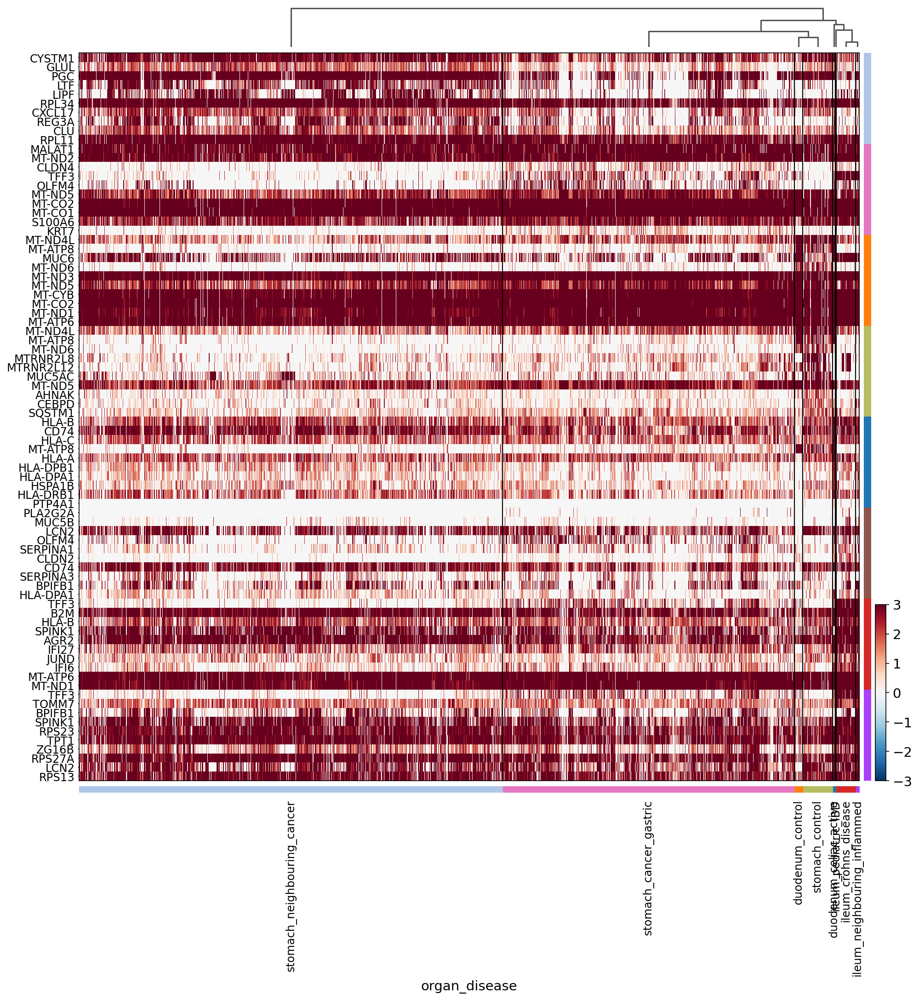

In [175]:
sc.tl.rank_genes_groups(muc6_nofetal,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(muc6_nofetal, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(muc6_nofetal,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,15))

In [176]:
muc6_nonfetal_deg = muc6_deg[~muc6_deg.obs.organ_disease.isin(['duodenum_inutero','stomach_inutero'])].copy()

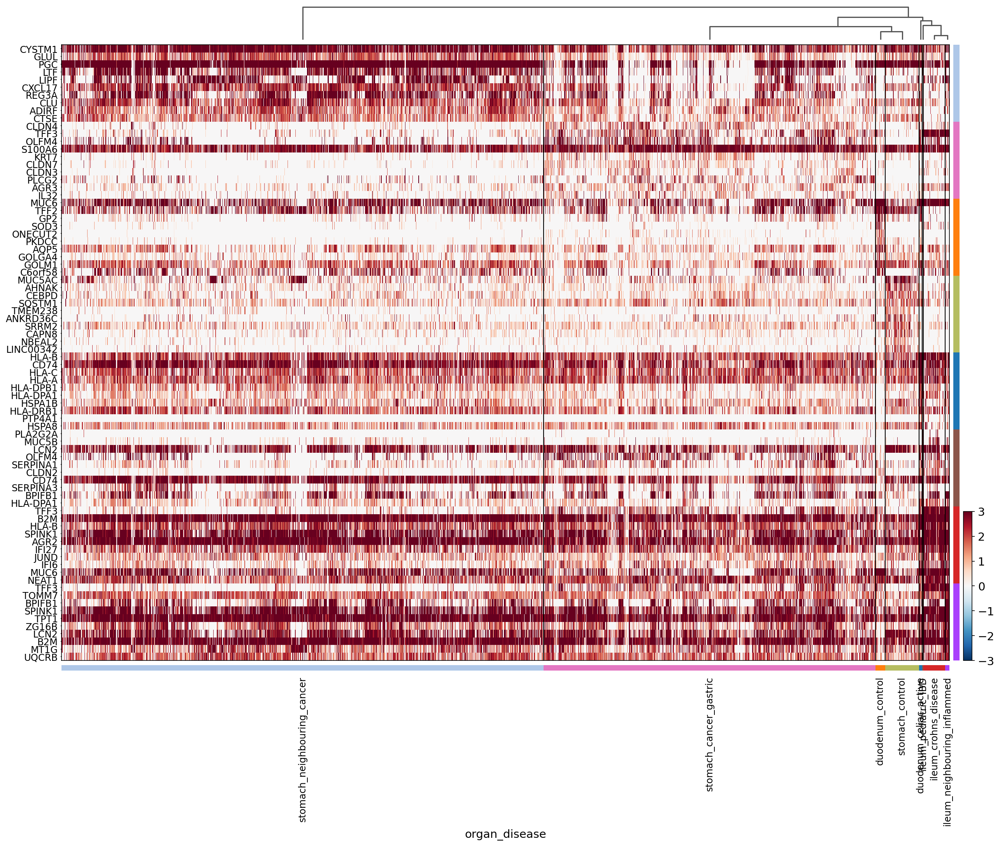

In [177]:
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(muc6_nonfetal_deg, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(muc6_nonfetal_deg,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(20,15),save='muc6_nofetal_noMTorRBgenes_heatmapdendro.pdf')

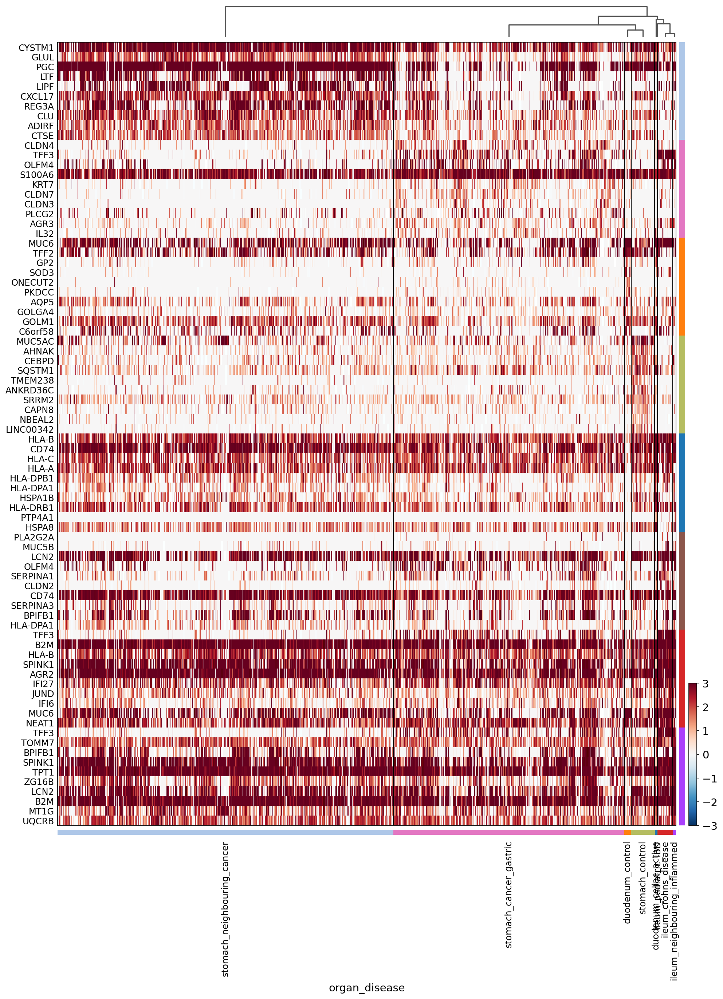

In [178]:
sc.pl.rank_genes_groups_heatmap(muc6_nonfetal_deg,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,20),save='muc6_nofetal_noMTorRBgenes_heatmapdendro.pdf')

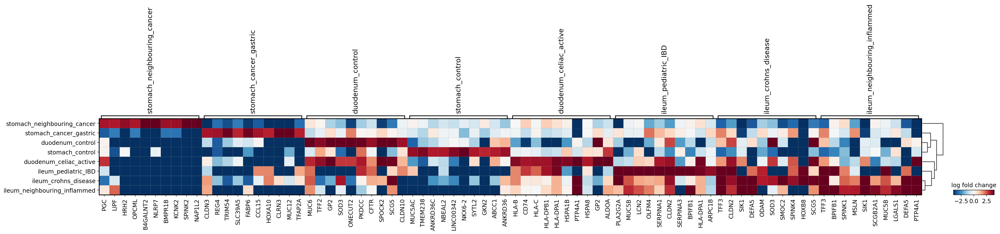

In [179]:
sc.pl.rank_genes_groups_matrixplot(
    muc6_nonfetal_deg,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
save='logFC_muc6_nofetal_noMTorRBgenes_heatmapdendro_organ_disease.pdf')

In [180]:
muc6_nonfetal_deg.obs['organ_disease2'] = (
    muc6_nonfetal_deg.obs['organ_disease']
    .map(lambda x: {
        'stomach_neighbouring_cancer':'stomach_control'
    }.get(x,x))
    .astype("category")
)

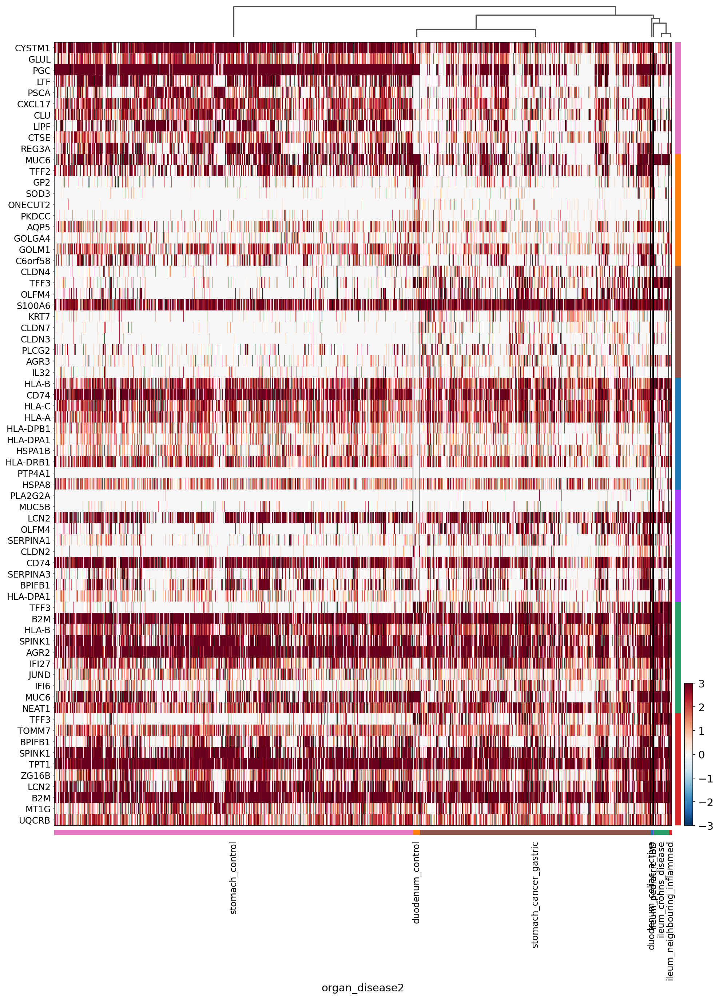

In [181]:
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',method='wilcoxon')
sc.tl.dendrogram(muc6_nonfetal_deg, groupby='organ_disease2')
sc.pl.rank_genes_groups_heatmap(muc6_nonfetal_deg,groupby='organ_disease2', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,20),save='muc6_nofetal_noMTorRBgenes_heatmapdendro_organ_disease2.pdf')

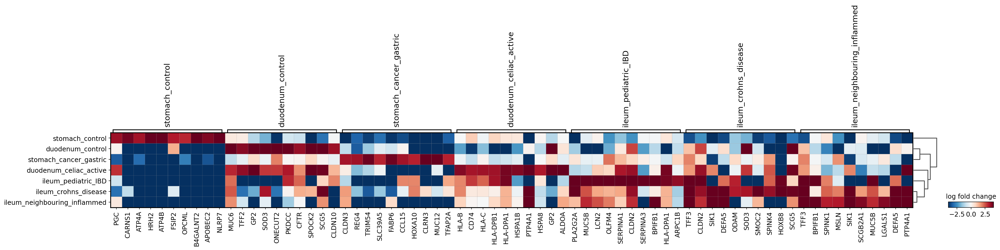

In [182]:
#Plot top 10 marker genes differentiating INFLAREs from healthy counterparts from wilcoxon test
#Extended data 9f
sc.pl.rank_genes_groups_matrixplot(
    muc6_nonfetal_deg,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
save='logFC_muc6_nofetal_noMTorRBgenes_heatmapdendro_organ_disease2.pdf')

In [183]:
muc6_nonfetal_deg.obs['organ_disease2'] = (
    muc6_nonfetal_deg.obs['organ_disease']
    .map(lambda x: {
        'ileum_pediatric_IBD':'ileum_IBD',
        'ileum_crohns_disease':'ileum_IBD',
         'stomach_neighbouring_cancer':'stomach_control'
    }.get(x,x))
    .astype("category")
)

#### Run wilcoxon DGE and GSEA on combined pediatric/adult IBD

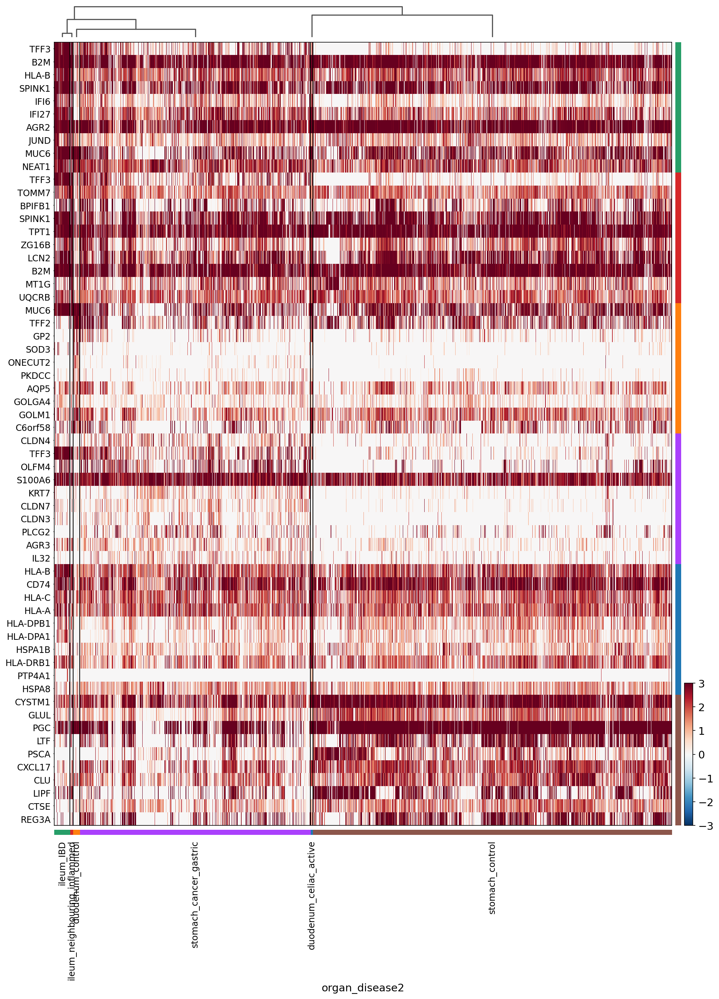

In [184]:
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',method='wilcoxon')
sc.tl.dendrogram(muc6_nonfetal_deg, groupby='organ_disease2')
sc.pl.rank_genes_groups_heatmap(muc6_nonfetal_deg,groupby='organ_disease2', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,20),save='muc6_nofetal_noMTorRBgenes_heatmapdendro_organ_disease2_newplot.pdf')

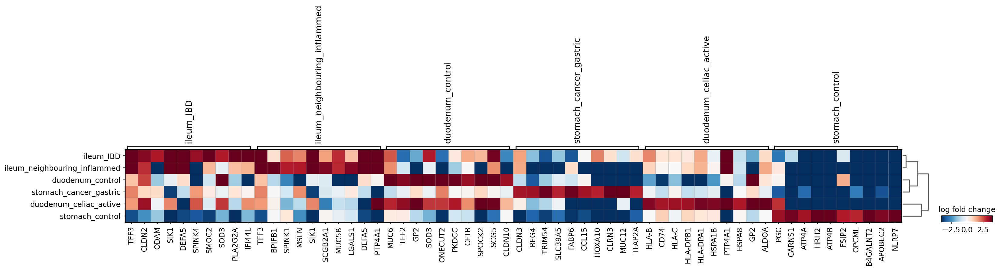

In [185]:
sc.pl.rank_genes_groups_matrixplot(
    muc6_nonfetal_deg,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
save='logFC_muc6_nofetal_noMTorRBgenes_heatmapdendro_organ_disease2.pdf')

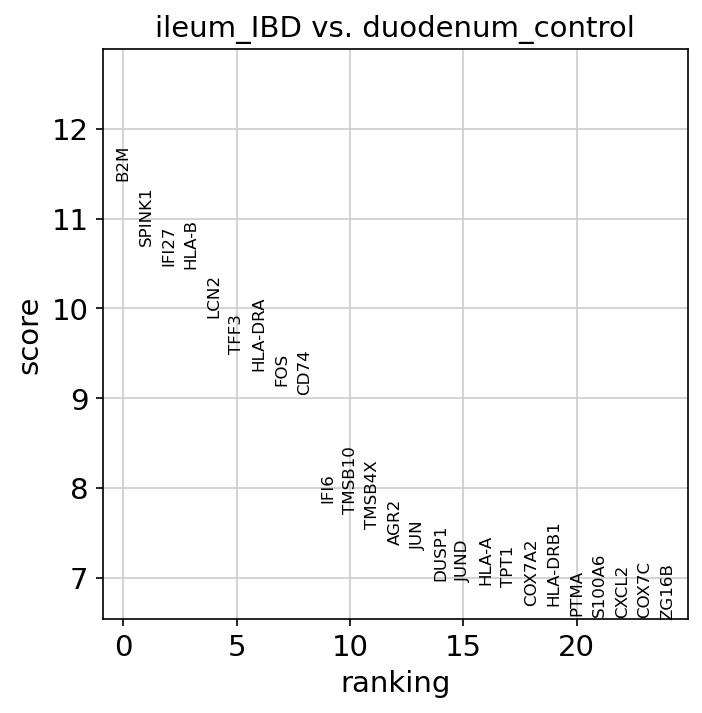

In [186]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',groups=['ileum_IBD'], reference='duodenum_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_nonfetal_deg, n_genes=25, sharey=False, key="wilcoxon")

#### GSEA for IBD ileum (INFLAREs) vs duodenum control (healthy Brunner's gland MGN)

In [187]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='ileum_IBD', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

90


In [188]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

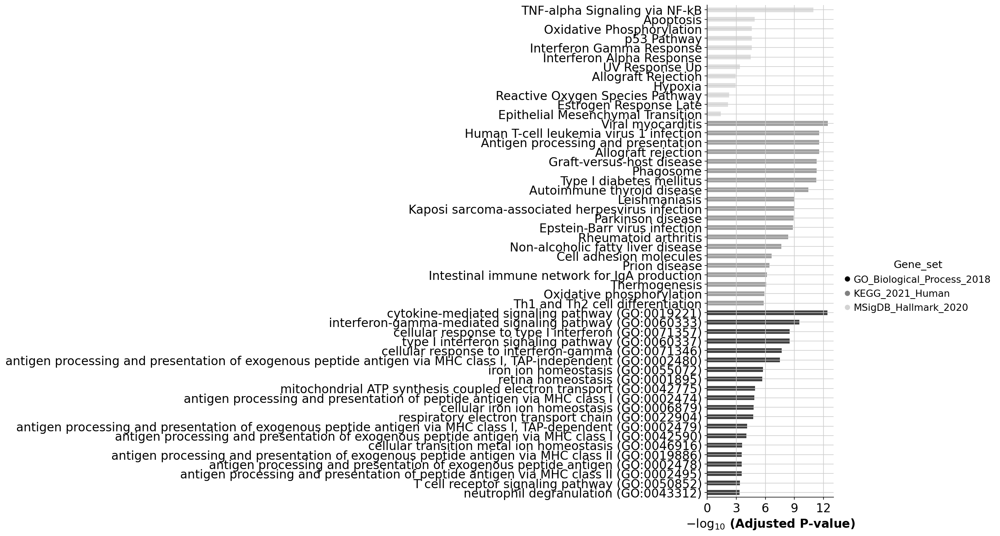

In [189]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [190]:
#save figure - Extended data 9g
ax.figure.savefig('Gene_set_IBD_vs_healthy_duodenum.pdf',bbox_inches='tight')

In [191]:
enr.results.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/DGE/Gene_set_IBD_vs_healthy_duodenum.csv')

In [192]:
dge_save = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='ileum_IBD', 
                                    key='wilcoxon')

In [193]:
dge_save

,names,scores,logfoldchanges,pvals,pvals_adj
0,B2M,11.423905,4.501481,3.176317e-30,5.831718e-26
1,SPINK1,10.695442,4.929175,1.069080e-26,6.542772e-23
2,IFI27,10.481431,9.199955,1.051408e-25,4.825964e-22
3,HLA-B,10.439246,4.041039,1.641093e-25,6.026092e-22
4,LCN2,9.894957,6.821268,4.378013e-23,1.339672e-19
...,...,...,...,...,...
18355,PGC,-6.464595,-2.966074,1.015704e-10,6.216110e-08
18356,ONECUT2,-6.997567,-7.845322,2.604462e-12,2.656552e-09
18357,MUC6,-8.018238,-1.779171,1.072728e-15,1.641274e-12
18358,GP2,-8.065568,-5.919836,7.289643e-16,1.216708e-12


In [194]:
dge_save.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/DGE/DGE_scanpy_IBD_vs_healthy_duodenum.csv')

#### GSEA for IBD ileum (INFLAREs) vs stomach control (healthy gastric MGN)

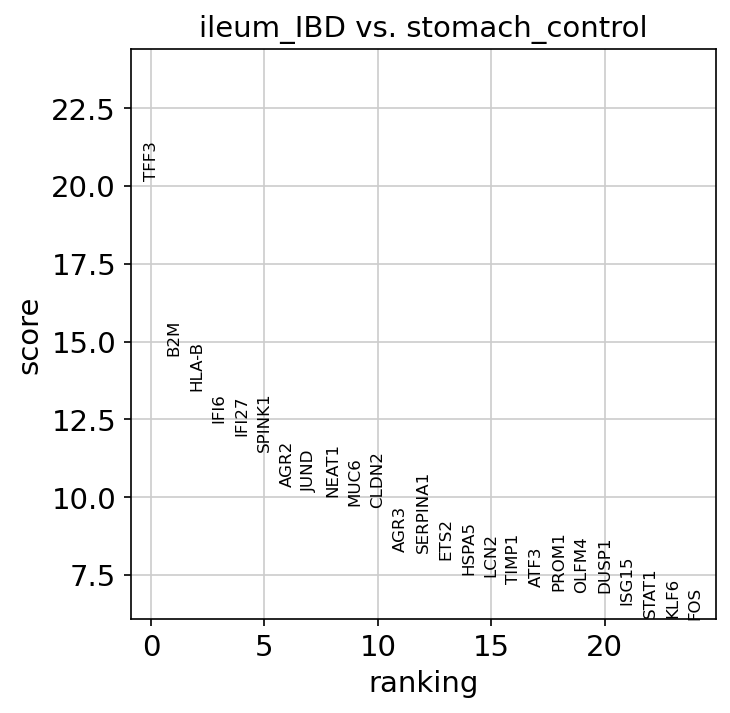

In [195]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',groups=['ileum_IBD'], reference='stomach_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_nonfetal_deg, n_genes=25, sharey=False, key="wilcoxon")

In [196]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='ileum_IBD', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

89


In [197]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

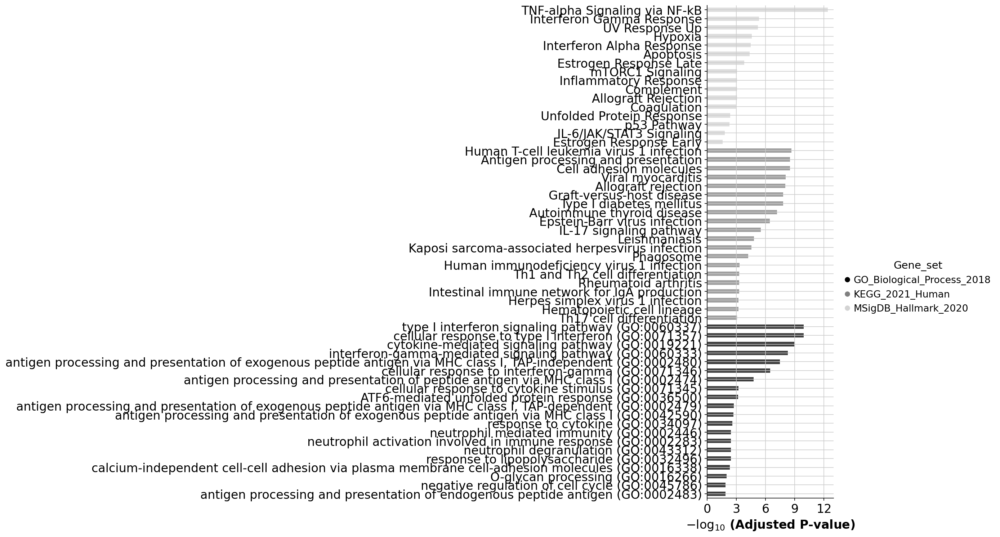

In [198]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [199]:
#save figure - Extended data 9h
ax.figure.savefig('Gene_set_IBD_vs_healthy_stomach.pdf',bbox_inches='tight')

In [200]:
enr.results.head()

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,15/200,1.174199e-14,4.109697e-13,0,0,21.613587,693.268863,EGR1;BTG2;DUSP1;FOS;CXCL2;F3;ETS2;RHOB;NR4A1;ZFP36;KLF6;FOSB;SIK1;ATF3;MCL1
1,MSigDB_Hallmark_2020,Interferon Gamma Response,9/200,2.661503e-07,4.657630e-06,0,0,11.615183,175.844637,BST2;APOL6;IFI27;STAT1;HLA-B;ISG15;HLA-A;B2M;IFI44L
2,MSigDB_Hallmark_2020,UV Response Up,8/158,5.215851e-07,6.085160e-06,0,0,13.011358,188.227424,NR4A1;BTG2;EPCAM;FOSB;FOS;CXCL2;ATF3;RHOB
3,MSigDB_Hallmark_2020,Hypoxia,8/200,3.070285e-06,2.686499e-05,0,0,10.143519,128.759189,ZFP36;KLF6;HOXB9;HSPA5;DUSP1;FOS;F3;ATF3
4,MSigDB_Hallmark_2020,Interferon Alpha Response,6/97,4.675922e-06,3.273146e-05,0,0,15.744737,193.236485,BST2;IFI27;HLA-C;ISG15;B2M;IFI44L


In [201]:
enr.results.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/DGE/Gene_set_IBD_vs_healthy_stomach.csv')

In [202]:
dge_save = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='ileum_IBD', 
                                    key='wilcoxon')
dge_save.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/DGE/DGE_scanpy_IBD_vs_healthy_stomach.csv')

#### GSEA for stomach control (healthy gastric MGN) vs duodenum control (healthy Brunner's gland MGN)

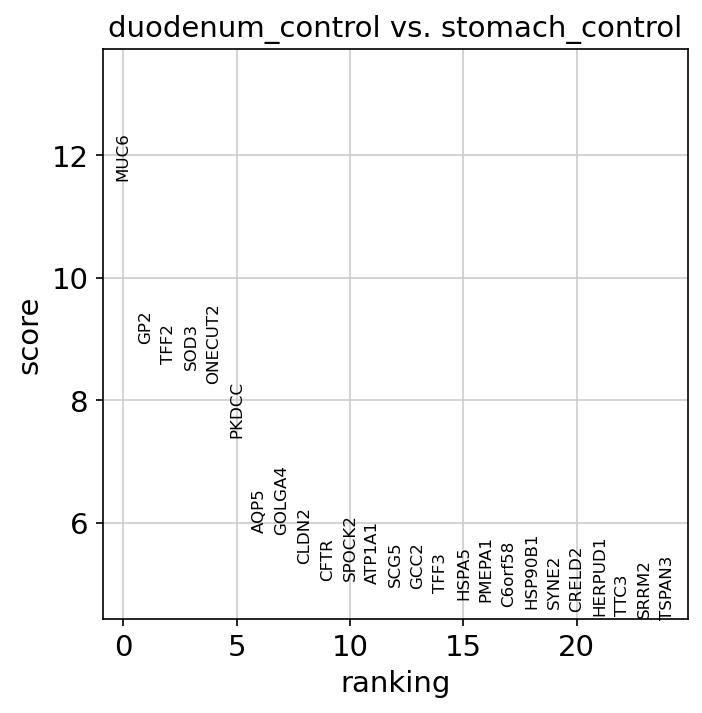

In [203]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',groups=['duodenum_control'], reference='stomach_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_nonfetal_deg, n_genes=25, sharey=False, key="wilcoxon")

In [204]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='duodenum_control', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

45


In [205]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

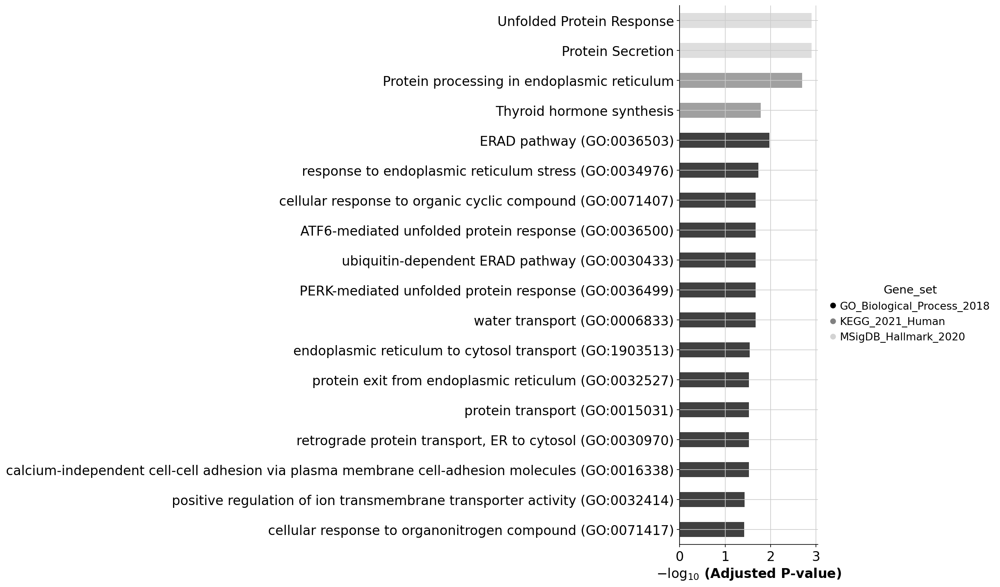

In [206]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [207]:
ax.figure.savefig('Gene_set_healthy_duodenum_vs_healthy_stomach.pdf',bbox_inches='tight')
enr.results.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/DGE/Gene_set_healthy_duodenum_vs_healthy_stomach.csv')

In [208]:
dge_save = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='duodenum_control', 
                                    key='wilcoxon')
dge_save.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/DGE/DGE_scanpy_healthy_duodenum_vs_healthy_stomach.csv')

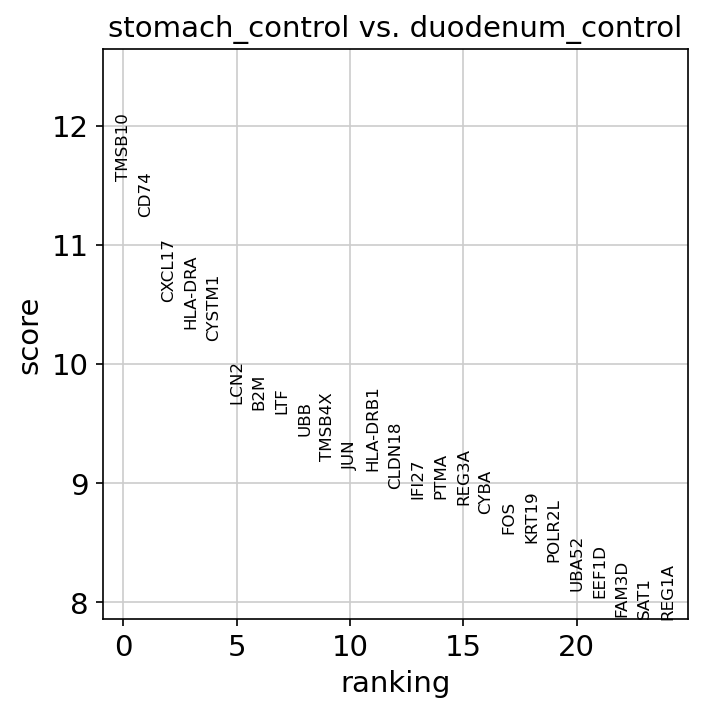

In [209]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',groups=['stomach_control'], reference='duodenum_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_nonfetal_deg, n_genes=25, sharey=False, key="wilcoxon")

In [210]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='stomach_control', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

280


In [211]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

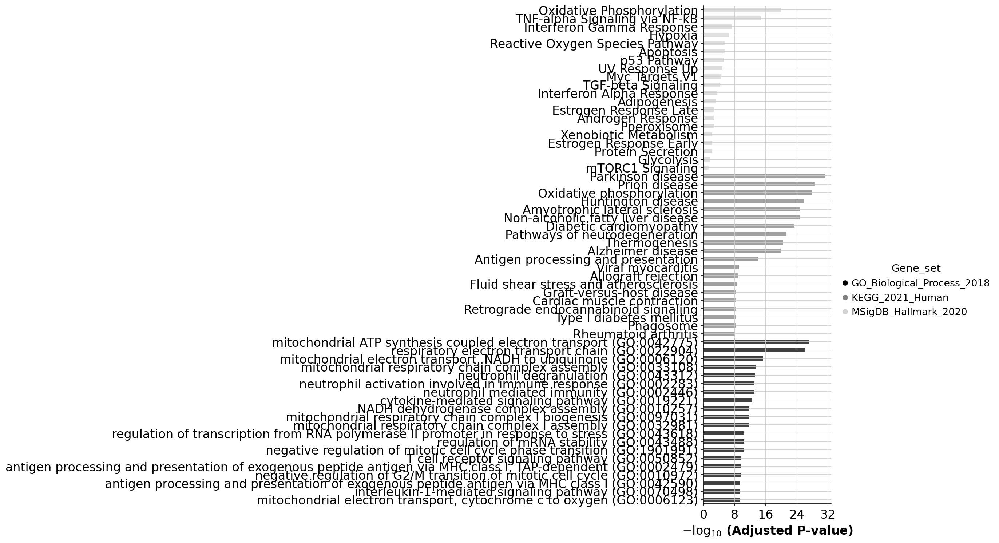

In [212]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [213]:
ax.figure.savefig('Gene_set_healthy_stomach_vs_healthy_duodenum.pdf',bbox_inches='tight')
enr.results.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/DGE/Gene_set_healthy_stomach_vs_healthy_duodenum.csv')

In [214]:
dge_save = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='stomach_control', 
                                    key='wilcoxon')
dge_save.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/DGE/DGE_scanpy_healthy_stomach_vs_healthy_duodenum.csv')

#### GSEA for active celiac (INFLAREs) vs duodenum control (healthy Brunner's gland MGN)

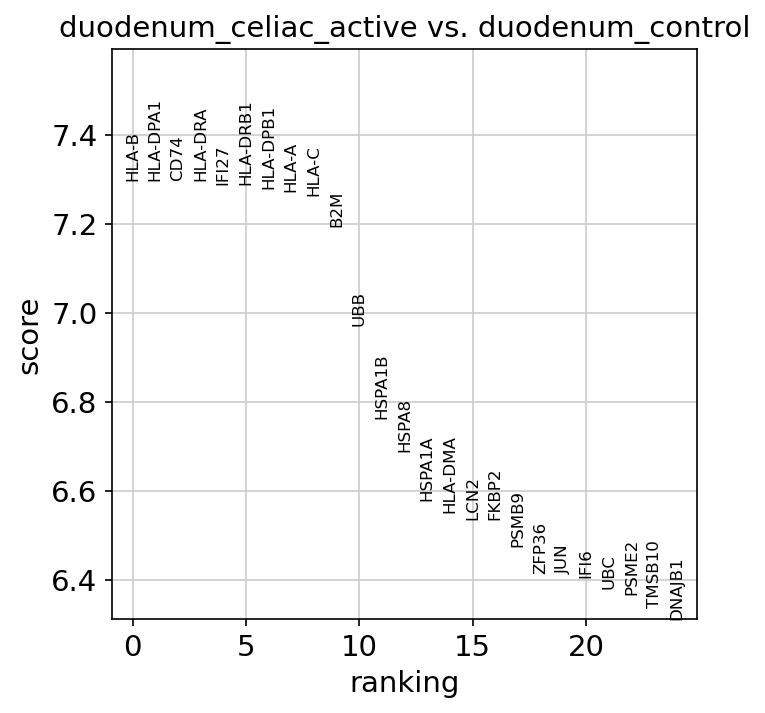

In [215]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',groups=['duodenum_celiac_active'], reference='duodenum_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_nonfetal_deg, n_genes=25, sharey=False, key="wilcoxon")

In [216]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='duodenum_celiac_active', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

652


In [217]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

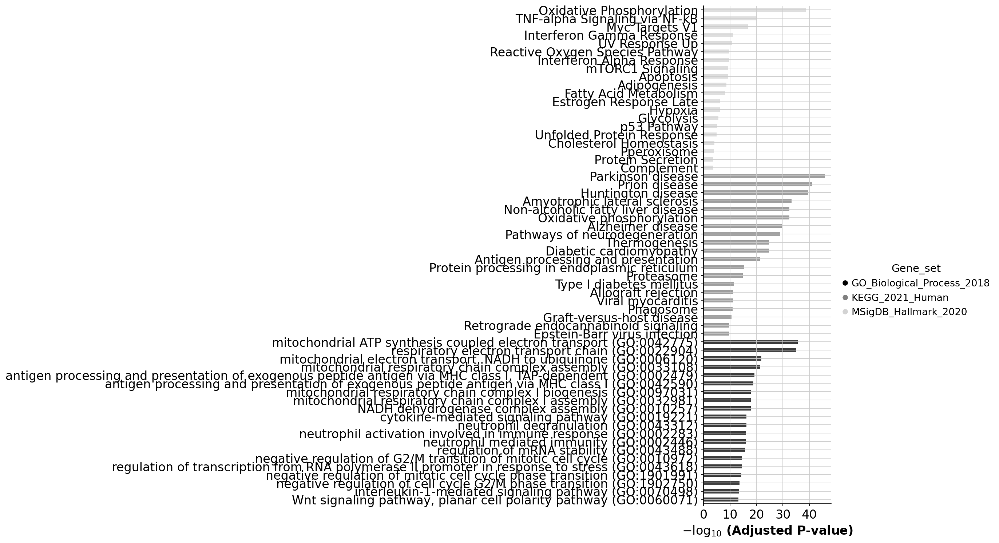

In [218]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [219]:
ax.figure.savefig('Gene_set_celiac_vs_healthy_duodenum.pdf',bbox_inches='tight')
enr.results.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/DGE/Gene_set_celiac_vs_healthy_duodenum.csv')

In [220]:
dge_save = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='duodenum_celiac_active', 
                                    key='wilcoxon')
dge_save.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/DGE/DGE_scanpy_celiac_vs_healthy_duodenum.csv')

### Now to find how many marker genes are overlapping between:
1. ileum IBD MUC6+ cells (INFLAREs)
2. healthy stomach MUC6+ cells (MGN)
3. healthy duodenum MUC6+ cells (MGN)
4. active celiac MUC6+ cells (INFLAREs)
- Calculate and export marker genes for 1-4 compared to other epithelial cells across small intestine and stomach
- Then plot overlapping genes

In [221]:
#subset all epithelial cells
epi = full_adata[full_adata.obs.level_1_annot.isin(['Epithelial'])].copy()

In [222]:
epi

AnnData object with n_obs × n_vars = 659483 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [223]:
epi.obs.organ_groups.unique()

array(['Oral_mucosa', 'Small_intestine', 'Stomach', 'Salivary_gland',
       'Large_intestine', 'Oesophagus'], dtype=object)

In [224]:
#isolate relevant organs - ie. those with MUC6+ cells small intestine and stomach
epi_organ = epi[epi.obs.organ_groups.isin(['Small_intestine', 'Stomach'])]

In [225]:
epi_organ

View of AnnData object with n_obs × n_vars = 344850 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_coun

#### Prepare cell type/organ/disease categories for comparison

In [226]:
epi_organ.obs['organ_disease'] = epi_organ.obs['organ_unified'].astype(str)+'_'+epi_organ.obs['disease'].astype(str)
epi_organ.obs.organ_disease.value_counts()

ileum_neighbouring_inflammed              103590
ileum_control                              50766
stomach_neighbouring_cancer                39783
stomach_cancer_gastric                     26252
ileum_crohns_disease                       24478
ileum_inutero                              23626
duodenum_inutero                           23555
duodenum_control                           12671
ileum_neighbouring_cancer                   8121
jejunum_control                             7456
ileum_pediatric_IBD                         5212
ileum_neighbouring_polyps                   4710
small intestine_control                     3254
small intestine_preterm                     2927
stomach_control                             2778
small intestine_inutero                     1594
stomach_inutero                             1277
jejunum_inutero                              898
duodenum_celiac_active                       896
duodenum_celiac_treated                      734
intestine_preterm   

In [227]:
#remove fetal MUC6 cells
epi_organ_age = epi_organ[~epi_organ.obs.disease.isin(['inutero','preterm'])].copy()

In [228]:
epi_organ_age.obs['organ_disease_celltype'] = epi_organ_age.obs['organ_disease'].astype(str)+'_'+epi_organ_age.obs['level_3_annot'].astype(str)
epi_organ_age.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte          53954
ileum_control_Enterocyte                         34776
ileum_neighbouring_inflammed_TA                  26391
stomach_neighbouring_cancer_Mucous_gland_neck    11669
stomach_neighbouring_cancer_Cycling              10019
                                                 ...  
MLN_control_Enterocyte                               1
jejunum_control_Paneth                               1
ileum_control_Mucous_gland_neck                      1
duodenum_celiac_treated_Mucous_gland_neck            1
duodenum_celiac_treated_Surface_foveolar             1
Name: organ_disease_celltype, Length: 181, dtype: int64

In [229]:
pd.set_option('display.max_rows', 500)
epi_organ_age.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte                     53954
ileum_control_Enterocyte                                    34776
ileum_neighbouring_inflammed_TA                             26391
stomach_neighbouring_cancer_Mucous_gland_neck               11669
stomach_neighbouring_cancer_Cycling                         10019
ileum_crohns_disease_Enterocyte                              9133
stomach_cancer_gastric_Cycling                               8659
duodenum_control_Enterocyte                                  8446
stomach_neighbouring_cancer_Surface_foveolar                 8048
ileum_crohns_disease_TA                                      7898
ileum_control_TA                                             7320
stomach_cancer_gastric_Mucous_gland_neck                     6136
ileum_neighbouring_inflammed_Goblet                          5832
jejunum_control_Enterocyte                                   5590
ileum_neighbouring_cancer_Enterocyte                         5454
stomach_ca

In [230]:
epi_organ_age = epi_organ_age[~epi_organ_age.obs.organ_disease_celltype.isin(['ileum_control_Mucous_gland_neck','duodenum_celiac_treated_Mucous_gland_neck','jejunum_control_Mucous_gland_neck'])].copy()

In [231]:
list(epi_organ_age.obs.organ_disease_celltype.unique())

['duodenum_control_TA',
 'ileum_control_TA',
 'ileum_control_Microfold',
 'ileum_control_Enterocyte',
 'ileum_control_Epithelial_stem',
 'stomach_control_Surface_foveolar',
 'stomach_control_Mucous_gland_neck',
 'stomach_control_Cycling',
 'stomach_control_Pareital',
 'stomach_control_Enteroendocrine_MX',
 'stomach_control_Enterochromaffin',
 'stomach_control_Chief',
 'stomach_control_Enteroendocrine_G',
 'stomach_control_Goblet_progenitor',
 'stomach_control_Goblet',
 'stomach_control_Enteroendocrine',
 'stomach_control_Enterocyte',
 'stomach_control_Enteroendocrine_X',
 'ileum_control_Goblet_cycling',
 'ileum_control_Goblet_progenitor',
 'ileum_control_BEST4_enterocyte_colonocyte',
 'ileum_control_Goblet',
 'ileum_control_Tuft',
 'ileum_control_Enteroendocrine',
 'ileum_control_Surface_foveolar',
 'ileum_control_Paneth',
 'duodenum_control_Enterocyte',
 'duodenum_control_BEST4_enterocyte_colonocyte',
 'duodenum_control_Epithelial_stem',
 'duodenum_control_Goblet_progenitor',
 'duoden

In [232]:
#remove other disease cell types so comparing MUC6 to healthy only
epi_organ_age = epi_organ_age[epi_organ_age.obs.organ_disease_celltype.isin(['duodenum_control_TA',
 'ileum_control_TA',
 'ileum_control_Microfold',
 'ileum_control_Enterocyte',
 'ileum_control_Epithelial_stem',
 'stomach_control_Surface_foveolar',
 'stomach_control_Mucous_gland_neck',
 'stomach_control_Cycling',
 'stomach_control_Pareital',
 'stomach_control_Enteroendocrine_MX',
 'stomach_control_Enterochromaffin',
 'stomach_control_Chief',
 'stomach_control_Enteroendocrine_G',
 'stomach_control_Goblet_progenitor',
 'stomach_control_Goblet',
 'stomach_control_Enteroendocrine',
 'stomach_control_Enterocyte',
 'stomach_control_Enteroendocrine_X',
 'ileum_control_Goblet_cycling',
 'ileum_control_Goblet_progenitor',
 'ileum_control_BEST4_enterocyte_colonocyte',
 'ileum_control_Goblet',
 'ileum_control_Tuft',
 'ileum_control_Enteroendocrine',
 'ileum_control_Surface_foveolar',
 'ileum_control_Paneth',
 'duodenum_control_Enterocyte',
 'duodenum_control_BEST4_enterocyte_colonocyte',
 'duodenum_control_Epithelial_stem',
 'duodenum_control_Goblet_progenitor',
 'duodenum_control_Goblet',
 'duodenum_control_Tuft',
 'ileum_neighbouring_polyps_TA',
 'ileum_neighbouring_polyps_Tuft',
 'ileum_neighbouring_polyps_Microfold',
 'ileum_neighbouring_polyps_Enteroendocrine',
 'ileum_neighbouring_polyps_Enterocyte',
 'ileum_neighbouring_polyps_BEST4_enterocyte_colonocyte',
 'ileum_neighbouring_polyps_Epithelial_stem',
 'ileum_neighbouring_polyps_Goblet_cycling',
 'ileum_neighbouring_polyps_Paneth',
 'ileum_neighbouring_polyps_Goblet_progenitor',
 'ileum_neighbouring_polyps_Goblet',
 'ileum_neighbouring_polyps_Surface_foveolar',
 'duodenum_control_Surface_foveolar',
 'duodenum_control_Goblet_cycling',
 'duodenum_control_Mucous_gland_neck',
 'duodenum_control_Enteroendocrine',
 'jejunum_control_TA',
 'jejunum_control_Enterocyte',
 'jejunum_control_BEST4_enterocyte_colonocyte',
 'jejunum_control_Epithelial_stem',
 'jejunum_control_Goblet_cycling',
 'jejunum_control_Tuft',
 'jejunum_control_Surface_foveolar',
 'jejunum_control_Goblet',
 'duodenum_control_Microfold',
 'jejunum_control_Microfold',
 'jejunum_control_Goblet_progenitor',
 'jejunum_control_Enteroendocrine',
 'jejunum_control_Paneth',
 'MLN_control_Enterocyte',
 'MLN_control_TA',
 'small intestine_control_Enterocyte',
 'small intestine_control_BEST4_enterocyte_colonocyte',
 'small intestine_control_TA',
 'small intestine_control_Tuft',
 'small intestine_control_Enteroendocrine',
 'small intestine_control_Goblet_progenitor',
 'small intestine_control_Epithelial_stem',
 'small intestine_control_Goblet',
 'small intestine_control_Goblet_cycling',
 'ileum_neighbouring_inflammed_TA',
 'ileum_neighbouring_inflammed_Surface_foveolar',
 'ileum_neighbouring_inflammed_Enterocyte',
 'small intestine_neighbouring_inflammed_TA',
 'stomach_neighbouring_cancer_Surface_foveolar',
 'stomach_neighbouring_cancer_Pareital',
 'stomach_neighbouring_cancer_Cycling',
 'stomach_neighbouring_cancer_Mucous_gland_neck',
 'stomach_neighbouring_cancer_Chief',
 'stomach_neighbouring_cancer_Gastric_fetal_epithelial',
 'stomach_neighbouring_cancer_Enterocyte',
 'stomach_neighbouring_cancer_Enterochromaffin',
 'stomach_neighbouring_cancer_Goblet',
 'stomach_neighbouring_cancer_Enteroendocrine_X',
 'stomach_neighbouring_cancer_Enteroendocrine',
 'stomach_neighbouring_cancer_Enteroendocrine_MX',
 'stomach_neighbouring_cancer_BEST4_enterocyte_colonocyte',
 'stomach_neighbouring_cancer_Enteroendocrine_G',
 'stomach_neighbouring_cancer_Goblet_progenitor',
 'ileum_neighbouring_inflammed_Epithelial_stem',
 'ileum_neighbouring_inflammed_Goblet_progenitor',
 'ileum_neighbouring_inflammed_Enteroendocrine',
 'ileum_neighbouring_inflammed_Microfold',
 'ileum_neighbouring_inflammed_Goblet_cycling',
 'ileum_neighbouring_inflammed_Paneth',
 'ileum_neighbouring_inflammed_Goblet',
 'ileum_neighbouring_inflammed_BEST4_enterocyte_colonocyte',
 'ileum_neighbouring_inflammed_Tuft',
 'ileum_neighbouring_cancer_Enteroendocrine',
 'ileum_neighbouring_cancer_Enterocyte',
 'ileum_neighbouring_cancer_TA',
 'ileum_neighbouring_cancer_Goblet',
 'ileum_neighbouring_cancer_Tuft',
 'ileum_neighbouring_cancer_Goblet_cycling',
 'ileum_neighbouring_cancer_Goblet_progenitor',
 'ileum_neighbouring_cancer_Epithelial_stem',
 'ileum_neighbouring_cancer_Paneth',
 'ileum_neighbouring_cancer_BEST4_enterocyte_colonocyte',
 'ileum_neighbouring_cancer_Surface_foveolar',
 'duodenum_control_Paneth',
 #'ileum_pediatric_IBD_Goblet_cycling',
 #'ileum_pediatric_IBD_TA',
 #'ileum_pediatric_IBD_Goblet_progenitor',
 #'ileum_pediatric_IBD_Enterocyte',
 #'ileum_pediatric_IBD_Epithelial_stem',
 #'ileum_pediatric_IBD_Enteroendocrine',
 #'ileum_pediatric_IBD_Microfold',
 #'ileum_pediatric_IBD_Goblet',
 #'ileum_pediatric_IBD_BEST4_enterocyte_colonocyte',
 #'ileum_pediatric_IBD_Tuft',
 #'ileum_pediatric_IBD_Paneth',
 'ileum_pediatric_IBD_Mucous_gland_neck',
 #'ileum_pediatric_IBD_Surface_foveolar',
 #'ileum_crohns_disease_TA',
 #'ileum_crohns_disease_Enterocyte',
 #'ileum_crohns_disease_Epithelial_stem',
 #'ileum_crohns_disease_Goblet',
 #'ileum_crohns_disease_Goblet_progenitor',
 #'ileum_crohns_disease_BEST4_enterocyte_colonocyte',
 #'ileum_crohns_disease_Tuft',
 #'ileum_crohns_disease_Enteroendocrine',
 #'ileum_crohns_disease_Goblet_cycling',
 #'ileum_crohns_disease_Paneth',
 'ileum_crohns_disease_Mucous_gland_neck',
 #'ileum_crohns_disease_Surface_foveolar',
 #'ileum_crohns_disease_Microfold',
 #'small intestine_crohns_disease_TA',
 #'stomach_cancer_gastric_Unknown',
 'stomach_cancer_gastric_Mucous_gland_neck',
 #'stomach_cancer_gastric_Surface_foveolar',
 #'stomach_cancer_gastric_Cycling',
 #'stomach_cancer_gastric_Chief',
 #'stomach_cancer_gastric_Goblet',
 #'stomach_cancer_gastric_Enterocyte',
 #'stomach_cancer_gastric_Enterochromaffin',
# 'stomach_cancer_gastric_Pareital',
# 'stomach_cancer_gastric_Enteroendocrine_MX',
 #'stomach_cancer_gastric_BEST4_enterocyte_colonocyte',
 #'stomach_cancer_gastric_Enteroendocrine_X',
 #'stomach_cancer_gastric_Goblet_progenitor',
 #'stomach_cancer_gastric_Enteroendocrine_G',
 #'stomach_cancer_gastric_Enteroendocrine',
 #'ileum_neighbouring_inflammed_Mucous_gland_neck',
 #'duodenum_celiac_active_Enterocyte',
 'duodenum_celiac_active_Mucous_gland_neck',
 #'duodenum_celiac_active_TA',
 #'duodenum_celiac_active_Enteroendocrine',
 #'duodenum_celiac_active_Surface_foveolar',
 #'duodenum_celiac_active_Tuft',
 #'duodenum_celiac_active_Goblet_cycling',
 #'duodenum_celiac_active_Goblet_progenitor',
 #'duodenum_celiac_active_Epithelial_stem',
 #'duodenum_celiac_active_Goblet',
 #'duodenum_celiac_active_BEST4_enterocyte_colonocyte',
 #'duodenum_celiac_active_Paneth',
# 'duodenum_celiac_treated_TA',
# 'duodenum_celiac_treated_Enterocyte',
# 'duodenum_celiac_treated_Enteroendocrine',
# 'duodenum_celiac_treated_Paneth',
# 'duodenum_celiac_treated_Tuft',
# 'duodenum_celiac_treated_Epithelial_stem',
# 'duodenum_celiac_treated_Goblet_cycling',
# 'duodenum_celiac_treated_Goblet_progenitor',
# 'duodenum_celiac_treated_BEST4_enterocyte_colonocyte',
# 'duodenum_celiac_treated_Goblet',
# 'duodenum_celiac_treated_Surface_foveolar'
                                                                            ])].copy()

In [233]:
#prepare data subsets for comparison
#keep non-MUC6+ healthy epithelial cells from small intestine and stomach
#remove MUC6 cells from other organ/diseases
stomach = epi_organ_age[~epi_organ_age.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','ileum_crohns_disease_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck'])].copy()
duodenum = epi_organ_age[~epi_organ_age.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'ileum_crohns_disease_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()
IBD = epi_organ_age[~epi_organ_age.obs.organ_disease_celltype.isin(['duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()
celiac = epi_organ_age[~epi_organ_age.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','ileum_crohns_disease_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()

In [234]:
stomach

AnnData object with n_obs × n_vars = 233033 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [235]:
stomach.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte                     53954
ileum_control_Enterocyte                                    34776
ileum_neighbouring_inflammed_TA                             26391
stomach_neighbouring_cancer_Mucous_gland_neck               11669
stomach_neighbouring_cancer_Cycling                         10019
duodenum_control_Enterocyte                                  8446
stomach_neighbouring_cancer_Surface_foveolar                 8048
ileum_control_TA                                             7320
ileum_neighbouring_inflammed_Goblet                          5832
jejunum_control_Enterocyte                                   5590
ileum_neighbouring_cancer_Enterocyte                         5454
ileum_neighbouring_inflammed_Goblet_progenitor               4555
stomach_neighbouring_cancer_Enterocyte                       3799
ileum_neighbouring_inflammed_Goblet_cycling                  3410
ileum_neighbouring_polyps_Enterocyte                         3215
ileum_neig

In [236]:
duodenum.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte                     53954
ileum_control_Enterocyte                                    34776
ileum_neighbouring_inflammed_TA                             26391
stomach_neighbouring_cancer_Cycling                         10019
duodenum_control_Enterocyte                                  8446
stomach_neighbouring_cancer_Surface_foveolar                 8048
ileum_control_TA                                             7320
ileum_neighbouring_inflammed_Goblet                          5832
jejunum_control_Enterocyte                                   5590
ileum_neighbouring_cancer_Enterocyte                         5454
ileum_neighbouring_inflammed_Goblet_progenitor               4555
stomach_neighbouring_cancer_Enterocyte                       3799
ileum_neighbouring_inflammed_Goblet_cycling                  3410
ileum_neighbouring_polyps_Enterocyte                         3215
ileum_neighbouring_inflammed_Epithelial_stem                 2987
ileum_neig

In [237]:
IBD.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte                     53954
ileum_control_Enterocyte                                    34776
ileum_neighbouring_inflammed_TA                             26391
stomach_neighbouring_cancer_Cycling                         10019
duodenum_control_Enterocyte                                  8446
stomach_neighbouring_cancer_Surface_foveolar                 8048
ileum_control_TA                                             7320
ileum_neighbouring_inflammed_Goblet                          5832
jejunum_control_Enterocyte                                   5590
ileum_neighbouring_cancer_Enterocyte                         5454
ileum_neighbouring_inflammed_Goblet_progenitor               4555
stomach_neighbouring_cancer_Enterocyte                       3799
ileum_neighbouring_inflammed_Goblet_cycling                  3410
ileum_neighbouring_polyps_Enterocyte                         3215
ileum_neighbouring_inflammed_Epithelial_stem                 2987
ileum_neig

In [238]:
IBD.obs.level_3_annot.value_counts()

Enterocyte                     117981
TA                              38816
Cycling                         10892
Surface_foveolar                 9957
Goblet                           9123
Goblet_progenitor                6732
Goblet_cycling                   5305
Epithelial_stem                  5005
Paneth                           3720
BEST4_enterocyte_colonocyte      3045
Tuft                             2256
Chief                            2006
Enteroendocrine                  1986
Pareital                         1180
Enterochromaffin                  886
Enteroendocrine_MX                596
Enteroendocrine_X                 463
Microfold                         423
Enteroendocrine_G                 420
Mucous_gland_neck                 167
Gastric_fetal_epithelial            5
Name: level_3_annot, dtype: int64

In [239]:
celiac.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte                     53954
ileum_control_Enterocyte                                    34776
ileum_neighbouring_inflammed_TA                             26391
stomach_neighbouring_cancer_Cycling                         10019
duodenum_control_Enterocyte                                  8446
stomach_neighbouring_cancer_Surface_foveolar                 8048
ileum_control_TA                                             7320
ileum_neighbouring_inflammed_Goblet                          5832
jejunum_control_Enterocyte                                   5590
ileum_neighbouring_cancer_Enterocyte                         5454
ileum_neighbouring_inflammed_Goblet_progenitor               4555
stomach_neighbouring_cancer_Enterocyte                       3799
ileum_neighbouring_inflammed_Goblet_cycling                  3410
ileum_neighbouring_polyps_Enterocyte                         3215
ileum_neighbouring_inflammed_Epithelial_stem                 2987
ileum_neig

#### Ok now we have 4 datasets, stomach, duodenum, IBD and celiac - where MUC6 cells are only from that healthy organ/disease, and other cells are a healthy reference to identify common marker genes
- proceed to making marker gene lists for each for comparison using scanpy wilcoxon test

In [241]:
#generate gene lists
sc.tl.rank_genes_groups(stomach,groupby='level_3_annot',method='wilcoxon')
sto = sc.get.rank_genes_groups_df(stomach, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(sto))

7650


In [242]:
sto

['PGC',
 'LYZ',
 'CXCL17',
 'LTF',
 'MUC6',
 'RPS17',
 'CLU',
 'MUC1',
 'LCN2',
 'RPL17',
 'CYSTM1',
 'REG3A',
 'EEF1G',
 'GLUL',
 'VSIG2',
 'ZG16B',
 'CLDN18',
 'BPIFB1',
 'AGR2',
 'NME2',
 'RPL36A',
 'CTSE',
 'CD59',
 'MIA',
 'TFF2',
 'GOLM1',
 'RPL31',
 'ANXA10',
 'MIF',
 'KCNE2',
 'TESC',
 'ATP6V1G1',
 'HLA-DPB1',
 'CA2',
 'GABARAP',
 'RPL36',
 'WFDC2',
 'FXYD3',
 'CD74',
 'RPL15',
 'FAM3D',
 'AQP5',
 'RPL18A',
 'RPL7',
 'RPL13',
 'SLPI',
 'RPS27',
 'RPL13A',
 'RPS18',
 'RPL27A',
 'LIPF',
 'RPL3',
 'RPS6',
 'C6orf58',
 'RPS19',
 'RPS2',
 'S100P',
 'RPL4',
 'RPL34',
 'MSMB',
 'RPL23',
 'LDHB',
 'RPL6',
 'SPINK1',
 'RPS10',
 'RPS20',
 'RPS4X',
 'RPL35',
 'RPL10A',
 'RPL39',
 'RPS28',
 'CXCL3',
 'RPS9',
 'RNASE4',
 'RPL26',
 'TSPO',
 'RPL32',
 'CFB',
 'RPL37A',
 'PSCA',
 'C16orf89',
 'SSR4',
 'RPL11',
 'EEF1D',
 'CD63',
 'NQO1',
 'RPSA',
 'RPL35A',
 'RPS14',
 'PSMA2',
 'RPL12',
 'RPL21',
 'RPS29',
 'NPM1',
 'RPL5',
 'SERPINA3',
 'RPL10',
 'RPS3',
 'TFF1',
 'S100A11',
 'CDC42EP1',
 'FM

In [243]:
#generate gene lists
sc.tl.rank_genes_groups(duodenum,groupby='level_3_annot',method='wilcoxon')
duo = sc.get.rank_genes_groups_df(duodenum, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(duo))

456


In [244]:
duo

['MUC6',
 'PGC',
 'TFF2',
 'LYZ',
 'MT-ND4L',
 'AQP5',
 'MT-ATP8',
 'GP2',
 'C6orf58',
 'SOD3',
 'GOLM1',
 'MT-ND6',
 'MT-ND3',
 'NPDC1',
 'ONECUT2',
 'MT-ND5',
 'MUC1',
 'PKDCC',
 'PDIA2',
 'FMOD',
 'MT-ND1',
 'MT-CYB',
 'BPIFB1',
 'HERPUD1',
 'SYNE2',
 'KCNN4',
 'TESC',
 'MT-CO2',
 'SPOCK2',
 'KIAA1324',
 'TTC3',
 'LINC00261',
 'FARP1',
 'MT-ATP6',
 'SCG5',
 'MEIS2',
 'CLDN2',
 'MLPH',
 'CLU',
 'AGR2',
 'PMEPA1',
 'CA2',
 'NFIA',
 'MT-ND2',
 'DNAJC10',
 'SPDEF',
 'CFTR',
 'BACE2',
 'CRELD2',
 'PAM',
 'PRR4',
 'AK4',
 'CLDN10',
 'HSPG2',
 'FNDC3B',
 'C16orf89',
 'QSOX1',
 'KCNE2',
 'SLC9A3R2',
 'GLUL',
 'HDLBP',
 'APP',
 'WFDC2',
 'ERN2',
 'IMPDH1',
 'ANXA5',
 'CALU',
 'RAMP1',
 'VSIG2',
 'PDIA5',
 'MT-CO1',
 'SORBS2',
 'PROM1',
 'CREB3L1',
 'RARRES2',
 'FAM107B',
 'HOMER2',
 'CKAP4',
 'HSPA5',
 'MTUS1',
 'GALNT4',
 'RRBP1',
 'HM13',
 'SEC16A',
 'COL27A1',
 'SRRM2',
 'GPRC5C',
 'LENG8',
 'ACSL3',
 'GCC2',
 'CPD',
 'DDX39B',
 'CDC42EP1',
 'ERGIC1',
 'ANXA10',
 'SYVN1',
 'PDIA4',
 'ETFB

In [245]:
#generate gene lists
sc.tl.rank_genes_groups(IBD,groupby='level_3_annot',method='wilcoxon')
ibd = sc.get.rank_genes_groups_df(IBD, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(ibd))

1152


In [246]:
ibd

['MUC6',
 'LYZ',
 'LCN2',
 'TFF3',
 'AGR2',
 'SPINK1',
 'ZG16B',
 'PGC',
 'IFI6',
 'CXCL2',
 'SLPI',
 'TIMP1',
 'BPIFB1',
 'MUC1',
 'TM4SF1',
 'CLDN2',
 'AQP5',
 'LIPF',
 'WFDC2',
 'HLA-DPA1',
 'C6orf58',
 'CXCL3',
 'PROM1',
 'MTRNR2L10',
 'MIA',
 'HLA-DPB1',
 'RPL34',
 'MTRNR2L6',
 'TESC',
 'MUC5B',
 'ODAM',
 'FMOD',
 'GLUL',
 'BACE2',
 'RHOB',
 'PRR4',
 'FAM3D',
 'MMP7',
 'RPL31',
 'SOX9',
 'S100P',
 'NUCB2',
 'RPL36A',
 'SOD3',
 'STAT1',
 'XIST',
 'IER3',
 'CD74',
 'HMGN3',
 'EGR1',
 'RPL26',
 'SERPINA3',
 'ATF3',
 'NUPR1',
 'RPL39',
 'ANXA5',
 'NPDC1',
 'IFI27',
 'SLC12A2',
 'MSLN',
 'XBP1',
 'GOLM1',
 'NNMT',
 'HLA-DRB5',
 'PRSS23',
 'IFITM3',
 'GDF15',
 'TCN1',
 'LTF',
 'SEC62',
 'RPS20',
 'BST2',
 'SCG5',
 'FGGY',
 'SMOC2',
 'GABRP',
 'KLF2',
 'RPS4X',
 'FOSB',
 'CXCR4',
 'SSR4',
 'MTRNR2L8',
 'HLA-DRA',
 'TMEM123',
 'GALNT7',
 'RPL37A',
 'PDIA4',
 'RNASE1',
 'LEFTY1',
 'RARRES2',
 'NR4A1',
 'EEF1A1',
 'CLU',
 'PHLDA1',
 'HSPA5',
 'SCGB3A1',
 'MECOM',
 'CXCL17',
 'IFI44L',
 'MTR

In [247]:
#generate gene lists
sc.tl.rank_genes_groups(celiac,groupby='level_3_annot',method='wilcoxon')
ced = sc.get.rank_genes_groups_df(celiac, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(ced))

1671


In [248]:
ced

['MUC6',
 'PGC',
 'CD74',
 'LYZ',
 'HLA-DPB1',
 'GOLM1',
 'NPDC1',
 'CLU',
 'HLA-DPA1',
 'LY6E',
 'AGR2',
 'HLA-C',
 'ZG16B',
 'SSR4',
 'KCNE2',
 'HLA-DRB1',
 'HLA-B',
 'TFF2',
 'CYSTM1',
 'HSPA1B',
 'AQP5',
 'GP2',
 'PPIB',
 'MUC1',
 'DNAJB1',
 'HLA-DMA',
 'IFI6',
 'SLPI',
 'GPRC5C',
 'TESC',
 'UBB',
 'HSPA1A',
 'MT-ATP8',
 'ZFP36',
 'MIF',
 'PDIA2',
 'HLA-DRA',
 'PDIA3',
 'LCN2',
 'CA2',
 'PPDPF',
 'HLA-A',
 'B2M',
 'UBC',
 'RAMP1',
 'LDHB',
 'HSPA8',
 'CST3',
 'IFI27',
 'C6orf58',
 'SQSTM1',
 'SYNGR2',
 'TCN1',
 'S100A11',
 'HERPUD1',
 'FMOD',
 'RPN2',
 'JUN',
 'LGALS3BP',
 'ATP6V1G1',
 'HSP90AA1',
 'MLPH',
 'DNAJA1',
 'HSP90AB1',
 'C12orf57',
 'KCNN4',
 'IER2',
 'FKBP2',
 'CALR',
 'SAT1',
 'HLA-E',
 'BST2',
 'ATP6V0C',
 'CD63',
 'NME2',
 'SPDEF',
 'HSP90B1',
 'CXCL17',
 'ERP29',
 'BACE2',
 'RPL30',
 'GABARAP',
 'FKBP11',
 'GMDS',
 'NFKBIZ',
 'SEC62',
 'VSIG2',
 'JUNB',
 'GSTM3',
 'PRSS23',
 'HSPA5',
 'CD46',
 'CKB',
 'QSOX1',
 'FAM3B',
 'ATF3',
 'HLA-DRB5',
 'TMED9',
 'EEF1D',
 'RO

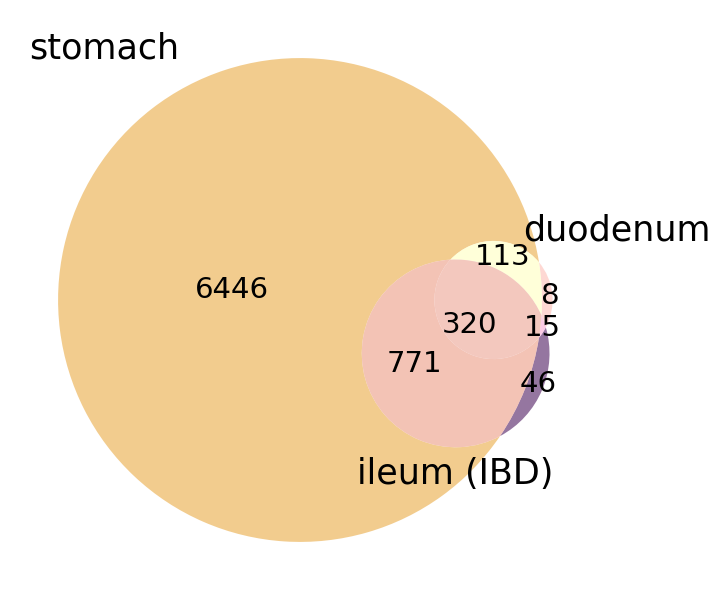

In [250]:
from matplotlib_venn import venn3
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn3([set1, set2, set3], ('stomach', 'duodenum', 'ileum (IBD)'),set_colors=('#edb75f', '#fec8c1','#693C78'), alpha = 0.7)
plt.savefig('venn_MUC6_markers_test1.pdf')

plt.show()

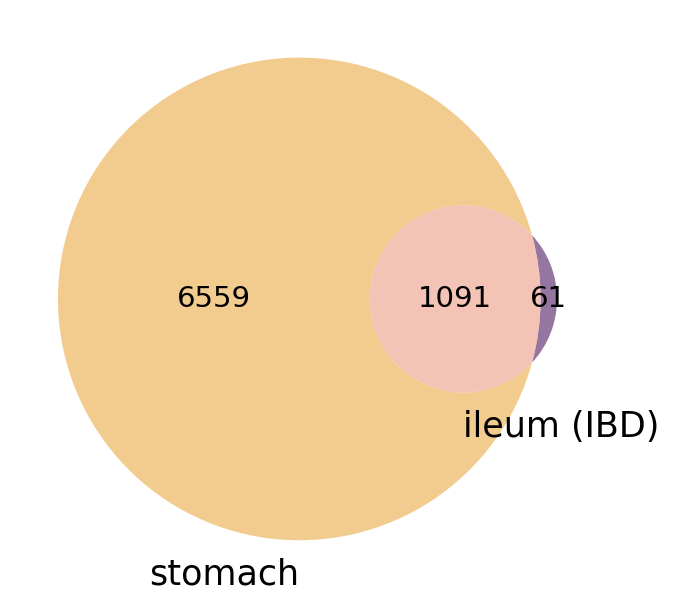

In [251]:
from matplotlib_venn import venn2
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn2([set1, set3], ('stomach', 'ileum (IBD)'),set_colors=('#edb75f', '#693C78'), alpha = 0.7)

plt.show()

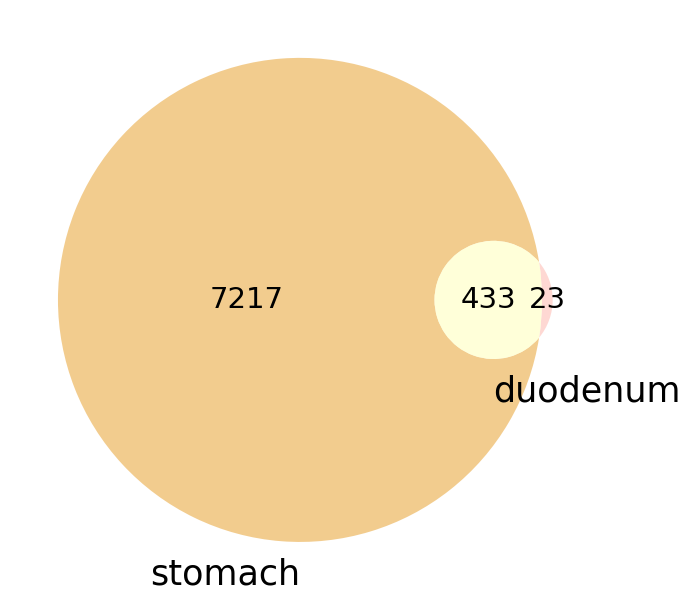

In [252]:
from matplotlib_venn import venn2
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn2([set1, set2], ('stomach', 'duodenum'),set_colors=('#edb75f','#fec8c1'), alpha = 0.7)

plt.show()

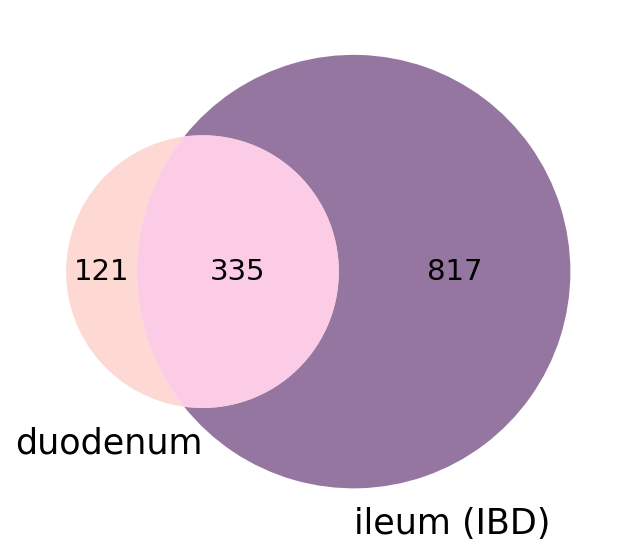

In [253]:
from matplotlib_venn import venn2
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn2([ set2,set3], ('duodenum','ileum (IBD)'),set_colors=('#fec8c1', '#693C78'), alpha = 0.7)

plt.show()

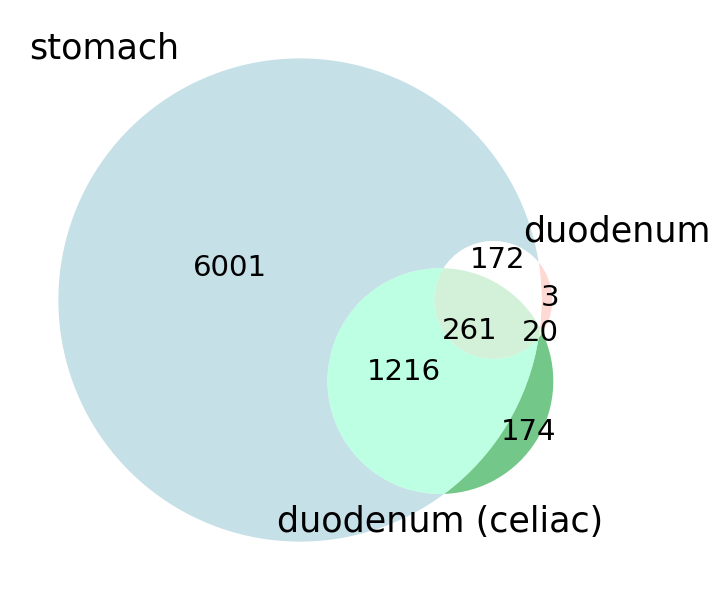

In [254]:
from matplotlib_venn import venn3
set1 = set(sto)
set2 = set(duo)
set4 = set(ced)

venn3([set1, set2, set4], ('stomach', 'duodenum', 'duodenum (celiac)'),set_colors=('#ADD3DD', '#fec8c1','#38B257'), alpha = 0.7)
plt.savefig('venn_MUC6_markers_test2.pdf')

plt.show()

In [255]:
#export lists
sto = pd.DataFrame(sto, columns=['gene_list'])
duo = pd.DataFrame(duo, columns=['gene_list'])
ibd = pd.DataFrame(ibd, columns=['gene_list'])
ced = pd.DataFrame(ced, columns=['gene_list'])

sto.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/MGNmarker_analysis_output/sto_MGNmakers.csv')
duo.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/MGNmarker_analysis_output/duo_MGNmakers.csv')
ibd.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/MGNmarker_analysis_output/ibd_MGNmakers.csv')
ced.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/MGNmarker_analysis_output/ced_MGNmakers.csv')

### Repeat but with downsampled per cell type per donor
- some level of control for donor driven effects
- used these results in paper

In [256]:
#Prepare categories for downsampling (per donor_celltype combination)
epi_organ_age.obs['donor_celltype']=epi_organ_age.obs['donorID_unified'].astype(str)+'_'+epi_organ_age.obs['level_3_annot'].astype(str)
epi_organ_age.obs.donor_celltype.value_counts()

D207_Enterocyte                  22733
D207_TA                           9010
D168_Enterocyte                   8924
D11_Enterocyte                    6846
D216_Enterocyte                   5946
                                 ...  
D129_Enteroendocrine                 1
D206_Microfold                       1
D131_Gastric_fetal_epithelial        1
D131_Goblet                          1
D161_Mucous_gland_neck               1
Name: donor_celltype, Length: 1102, dtype: int64

In [257]:
epi_organ_age

AnnData object with n_obs × n_vars = 239431 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [258]:
#function for downsampling
def downsample_mask(clustering, to_thin, n_cells=200):
    mask = np.array([i not in to_thin for i in clustering])
    numtemp = np.arange(len(clustering))
    for clus in to_thin:
        inds = set(numtemp[[i==clus for i in clustering]])
        keep = random.sample(inds, round(n_cells))
        mask[keep] = True
    return mask

In [259]:
#Downsample
vc=epi_organ_age.obs.donor_celltype.value_counts().loc[lambda x: x>100].reset_index()['index']
mask_p = downsample_mask(epi_organ_age.obs['donor_celltype'], vc.tolist(), n_cells=100)
epi_organ_age_downsample = epi_organ_age[mask_p]
epi_organ_age_downsample.obs.donor_celltype.value_counts()

D197_Goblet_progenitor           100
D199_TA                          100
D110_Chief                       100
D110_Surface_foveolar            100
D110_Cycling                     100
                                ... 
D129_Enteroendocrine               1
D206_Microfold                     1
D131_Gastric_fetal_epithelial      1
D131_Goblet                        1
D161_Mucous_gland_neck             1
Name: donor_celltype, Length: 1102, dtype: int64

In [260]:
#prepare data subsets for comparison
#keep non-MUC6+ healthy epithelial cells from small intestine and stomach
#remove MUC6 cells from other organ/diseases
stomach = epi_organ_age_downsample[~epi_organ_age_downsample.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','ileum_crohns_disease_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck'])].copy()
duodenum = epi_organ_age_downsample[~epi_organ_age_downsample.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'ileum_crohns_disease_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()
IBD = epi_organ_age_downsample[~epi_organ_age_downsample.obs.organ_disease_celltype.isin(['duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()
celiac = epi_organ_age_downsample[~epi_organ_age_downsample.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','ileum_crohns_disease_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()

In [261]:
#generate gene lists
sc.tl.rank_genes_groups(stomach,groupby='level_3_annot',method='wilcoxon')
sto = sc.get.rank_genes_groups_df(stomach, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(sto))

6230


In [262]:
sto

['PGC',
 'LYZ',
 'MUC6',
 'CXCL17',
 'LTF',
 'MUC1',
 'RPS17',
 'CYSTM1',
 'CLU',
 'VSIG2',
 'CLDN18',
 'LCN2',
 'GLUL',
 'RPL17',
 'LIPF',
 'EEF1G',
 'CTSE',
 'BPIFB1',
 'TESC',
 'ANXA10',
 'ZG16B',
 'NME2',
 'CA2',
 'MIA',
 'AQP5',
 'KCNE2',
 'TFF2',
 'CD74',
 'HLA-DPB1',
 'C6orf58',
 'GOLM1',
 'REG3A',
 'RPL36A',
 'CD59',
 'PSCA',
 'AGR2',
 'HLA-DRA',
 'HLA-DRB1',
 'LDHB',
 'SLPI',
 'CFB',
 'C16orf89',
 'MIF',
 'FAM3D',
 'CXCL3',
 'ATP6V1G1',
 'RPL31',
 'GABARAP',
 'FUT9',
 'SERPINA3',
 'WFDC2',
 'A4GNT',
 'HLA-DMA',
 'MSMB',
 'FMOD',
 'ALDH3A1',
 'RPL7',
 'PDIA2',
 'CXCL2',
 'PSMA2',
 'COLCA1',
 'FOXQ1',
 'S100P',
 'CST3',
 'TM4SF1',
 'TMSB4X',
 'HLA-DPA1',
 'RNASE4',
 'ANKRD22',
 'GSTM3',
 'PIGR',
 'MMP1',
 'SAT1',
 'RPS19',
 'FXYD3',
 'ADAM28',
 'RPS27',
 'MECOM',
 'RNASEK',
 'RPL34',
 'CDC42EP1',
 'FXYD5',
 'RPL18A',
 'LY6E',
 'RPL36',
 'RPS18',
 'RPL13A',
 'EEF1D',
 'RPS20',
 'RPL15',
 'MUC5AC',
 'TMEM97',
 'NQO1',
 'RPL23',
 'RPL27A',
 'RPS6',
 'NDUFB8',
 'RPS10',
 'PIK3C2G',


In [263]:
#generate gene lists
sc.tl.rank_genes_groups(duodenum,groupby='level_3_annot',method='wilcoxon')
duo = sc.get.rank_genes_groups_df(duodenum, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(duo))

580


In [264]:
duo

['MUC6',
 'PGC',
 'TFF2',
 'MT-ND4L',
 'MT-ATP8',
 'AQP5',
 'LYZ',
 'GP2',
 'C6orf58',
 'SOD3',
 'MT-ND6',
 'ONECUT2',
 'GOLM1',
 'MT-ND3',
 'MT-ND5',
 'PDIA2',
 'PKDCC',
 'FMOD',
 'MUC1',
 'BPIFB1',
 'NPDC1',
 'SPOCK2',
 'KCNN4',
 'FARP1',
 'CLDN2',
 'MEIS2',
 'MT-ND1',
 'MT-CYB',
 'MT-CO2',
 'TESC',
 'PMEPA1',
 'SCG5',
 'SYNE2',
 'CLDN10',
 'CA2',
 'AK4',
 'HSPG2',
 'PRR4',
 'C16orf89',
 'CFTR',
 'PAM',
 'MT-ATP6',
 'LINC00261',
 'HERPUD1',
 'FNDC3B',
 'NFIA',
 'CLU',
 'KCNE2',
 'IMPDH1',
 'HOMER2',
 'CRELD2',
 'RARRES2',
 'CAST',
 'EAPP',
 'CHMP3',
 'SLC25A6',
 'ZFP36L1',
 'VPS29',
 'EPS8L3',
 'NHSL1',
 'FXYD3',
 'TSPAN8',
 'SAT1',
 'GSN',
 'ALDH2',
 'RPL19',
 'NDUFA5',
 'PLGRKT',
 'TUBB4B',
 'RBX1',
 'U2AF1',
 'CALR',
 'SEC61G',
 'ENPEP',
 'TMEM106C',
 'BLVRB',
 'DEGS2',
 'SLC44A1',
 'UQCRC1',
 'DAZAP2',
 'RPS4X',
 'PSMB4',
 'EIF4A2',
 'RPL36A',
 'ACTR3',
 'CHMP1B',
 'RAB11A',
 'ARF1',
 'NEDD8',
 'PSMD8',
 'ATP6V0D1',
 'APOA1',
 'ISG15',
 'CSTB',
 'PHB',
 'LARP7',
 'ANP32B',
 'PSMA

In [265]:
#generate gene lists
sc.tl.rank_genes_groups(IBD,groupby='level_3_annot',method='wilcoxon')
ibd = sc.get.rank_genes_groups_df(IBD, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(ibd))

2212


In [266]:
ibd

['MUC6',
 'LYZ',
 'LCN2',
 'IFI6',
 'PGC',
 'ZG16B',
 'CXCL2',
 'SPINK1',
 'AGR2',
 'BPIFB1',
 'SLPI',
 'CLDN2',
 'TFF3',
 'AQP5',
 'TM4SF1',
 'HLA-DPA1',
 'TIMP1',
 'C6orf58',
 'LIPF',
 'HLA-DRA',
 'MTRNR2L10',
 'MIA',
 'CXCL3',
 'HLA-DPB1',
 'CD74',
 'WFDC2',
 'PROM1',
 'MUC1',
 'MUC5B',
 'ODAM',
 'MTRNR2L6',
 'HLA-DRB5',
 'MMP7',
 'IFI27',
 'TESC',
 'PRR4',
 'SOD3',
 'FMOD',
 'SERPINA3',
 'STAT1',
 'NNMT',
 'MSLN',
 'IFI44L',
 'HLA-DRB1',
 'NUPR1',
 'BST2',
 'TCN1',
 'XIST',
 'PRSS23',
 'PIGR',
 'CXCR4',
 'GABRP',
 'SCGB3A1',
 'GPRC5A',
 'LTF',
 'FGGY',
 'LEFTY1',
 'RHOB',
 'FAM3D',
 'ISG15',
 'CADM1',
 'BACE2',
 'A4GNT',
 'RPL34',
 'RARRES2',
 'CRISP3',
 'SMOC2',
 'S100P',
 'C3',
 'GOLM1',
 'SCG5',
 'OAS2',
 'HOXB8',
 'PART1',
 'SAA1',
 'GDF15',
 'SIK1',
 'VIM',
 'KLF2',
 'INTS6',
 'UBTF',
 'GDE1',
 'ELF2',
 'PLBD1',
 'TMED7',
 'ORMDL2',
 'NET1',
 'ATP2C2',
 'DDX27',
 'ARRDC4',
 'ENOSF1',
 'NUDT1',
 'IRF6',
 'WDR33',
 'TMEM131',
 'CDKN2B',
 'SRSF9',
 'CDC42BPA',
 'HMGN5',
 'RRP7A',

In [267]:
#generate gene lists
sc.tl.rank_genes_groups(celiac,groupby='level_3_annot',method='wilcoxon')
ced = sc.get.rank_genes_groups_df(celiac, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(ced))

1191


In [268]:
ced

['MUC6',
 'CD74',
 'HLA-DPB1',
 'PGC',
 'GOLM1',
 'HLA-DPA1',
 'LYZ',
 'HLA-DRB1',
 'HLA-C',
 'CLU',
 'LY6E',
 'ZG16B',
 'NPDC1',
 'KCNE2',
 'HLA-B',
 'AQP5',
 'GP2',
 'MT-ATP8',
 'TFF2',
 'HLA-DRA',
 'HSPA1B',
 'AGR2',
 'HLA-DMA',
 'CYSTM1',
 'IFI6',
 'SSR4',
 'SLPI',
 'DNAJB1',
 'ZFP36',
 'TESC',
 'PPIB',
 'MUC1',
 'HSPA1A',
 'IFI27',
 'GPRC5C',
 'PDIA2',
 'C6orf58',
 'UBB',
 'B2M',
 'CST3',
 'TCN1',
 'LCN2',
 'HLA-A',
 'CA2',
 'FMOD',
 'MT-ND4L',
 'BST2',
 'HSPA8',
 'KCNN4',
 'LDHB',
 'LGALS3BP',
 'HLA-DRB5',
 'SAT1',
 'SQSTM1',
 'MIF',
 'UBC',
 'PPDPF',
 'PDIA3',
 'HSP90AA1',
 'SYNGR2',
 'ATP6V0C',
 'PRSS23',
 'RAMP1',
 'CXCL17',
 'FAM3B',
 'FKBP2',
 'RPN2',
 'ATP6V1G1',
 'JUN',
 'MLPH',
 'CLDN2',
 'GSTM3',
 'HSP90AB1',
 'NFKBIZ',
 'DNAJA1',
 'UBE2L6',
 'HERPUD1',
 'CALR',
 'VSIG2',
 'HLA-E',
 'ETV5',
 'S100A11',
 'GADD45B',
 'ATF3',
 'IER2',
 'SPDEF',
 'HSPA5',
 'RHOB',
 'NME2',
 'GABARAP',
 'ROMO1',
 'MAFF',
 'GMDS',
 'HSP90B1',
 'ERP29',
 'BACE2',
 'CXCL2',
 'IER3',
 'MSMB',
 'S

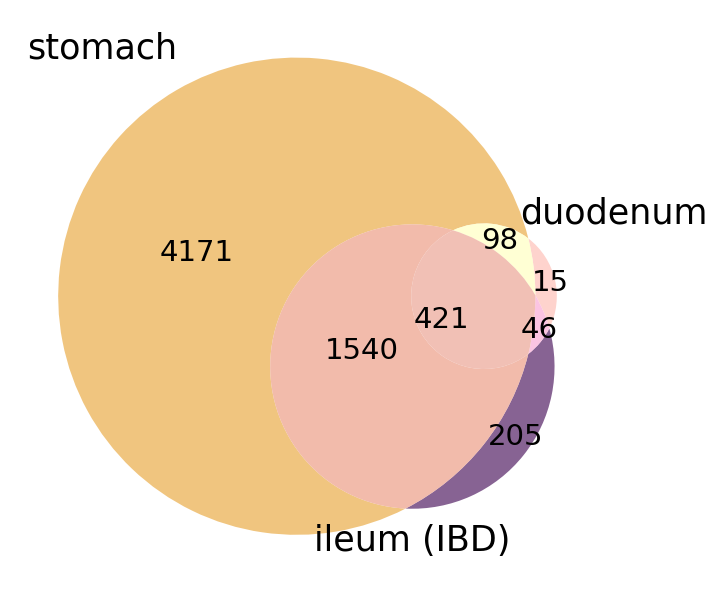

In [269]:
#visualise overlap with venn diagram - Extended data 9e
#overlap of healthy stomach, healthy duodenum and IBD ileum
from matplotlib_venn import venn3
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn3([set1, set2, set3], ('stomach', 'duodenum', 'ileum (IBD)'),set_colors=('#edb75f', '#fec8c1','#693C78'), alpha = 0.8)
plt.savefig('venn_MUC6_markers_test1.pdf')

plt.show()

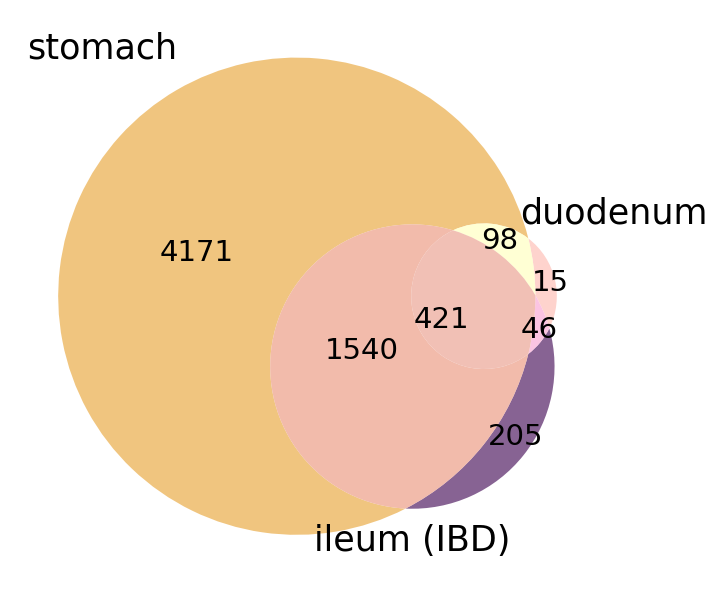

In [270]:
from matplotlib_venn import venn3
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn3([set1, set2, set3], ('stomach', 'duodenum', 'ileum (IBD)'),set_colors=('#edb75f', '#fec8c1','#693C78'), alpha = 0.8)
plt.savefig('venn_MUC6_markers_test1.png')

plt.show()

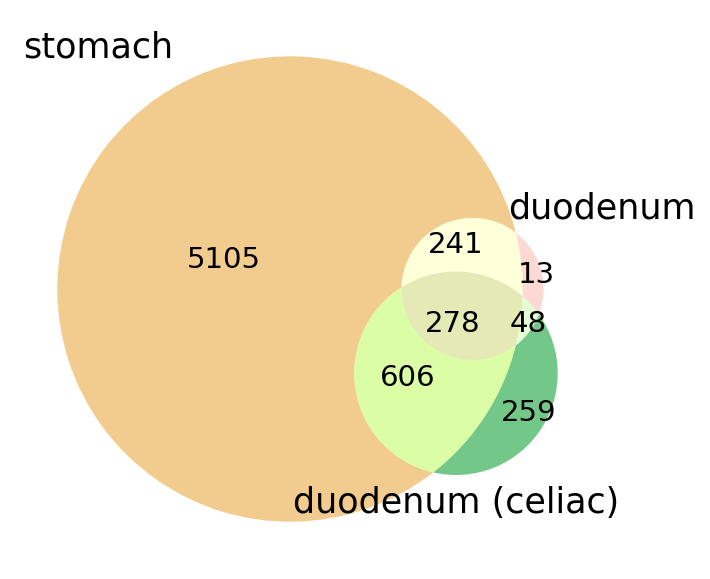

In [271]:
#visualise overlap with venn diagram - Extended data 9e
#overlap of healthy stomach, healthy duodenum and active celiac duodenum
from matplotlib_venn import venn3
set1 = set(sto)
set2 = set(duo)
set4 = set(ced)

venn3([set1, set2, set4], ('stomach', 'duodenum', 'duodenum (celiac)'),set_colors=('#edb75f', '#fec8c1','#38B257'), alpha = 0.7)
plt.savefig('venn_MUC6_markers_test_downsampled.pdf')

plt.show()

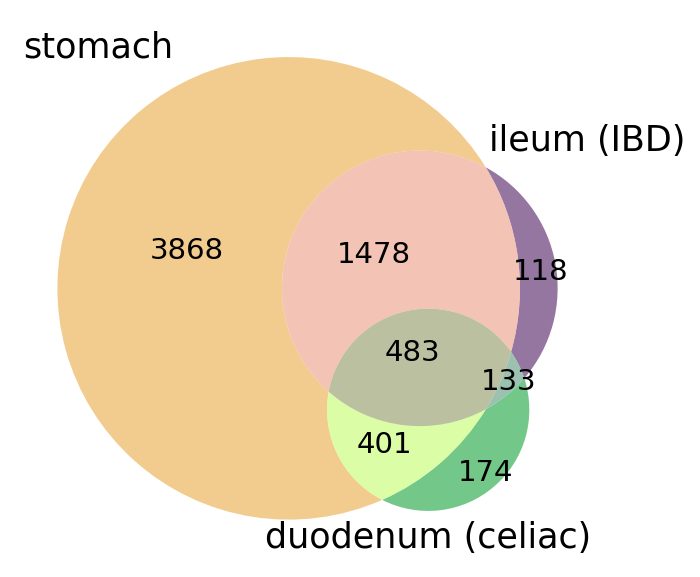

In [272]:
from matplotlib_venn import venn3
set1 = set(sto)
set3 = set(ibd)
set4 = set(ced)

venn3([set1, set3, set4], ('stomach', 'ileum (IBD)', 'duodenum (celiac)'),set_colors=('#edb75f', '#693C78','#38B257'), alpha = 0.7)
plt.savefig('venn_MUC6_markers_test_downsampled_ibd_celiac_sto.pdf')

plt.show()

In [273]:
#make overlapping gene lists

set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)
#set4 = set(ced)

sto_vs_ibd = set1.intersection(set3)
print("Overlapping genes:", sto_vs_ibd)


Overlapping genes: {'PCK2', 'SNX1', 'NDUFA9', 'CTDNEP1', 'EZR', 'IK', 'HINT1', 'SMAP1', 'NDRG1', 'EIF4G1', 'ARL4A', 'KLK1', 'LPCAT3', 'CYP2S1', 'POR', 'ZFAND6', 'OPTN', 'MTCH2', 'LYRM2', 'SAP30BP', 'LAMB3', 'SCRN2', 'TAF15', 'SNW1', 'LINC00667', 'UBXN4', 'ABCA5', 'GSR', 'TMEM54', 'RPL36', 'GSPT1', 'TNFSF10', 'CCT5', 'YWHAZ', 'DDX3X', 'NDUFS7', 'SLC3A2', 'PCM1', 'CAPG', 'CDK11A', 'USP47', 'LRBA', 'CPS1', 'HNRNPDL', 'CISD3', 'COX8A', 'RB1CC1', 'CEBPZ', 'BAZ1A', 'KIAA1522', 'TMED4', 'UGDH', 'CD74', 'PDCD6IP', 'PPP2R1A', 'GUCD1', 'UQCR10', 'GNAI3', 'IDH3B', 'APOA1', 'CNOT2', 'CD2AP', 'DDX52', 'HNRNPM', 'FAM200B', 'MAN1A1', 'TXNRD1', 'SLC20A1', 'MPST', 'SLC26A3', 'LRRC59', 'SLTM', 'TCN1', 'RBPJ', 'RTN4', 'NDUFA3', 'TMEM59', 'TAF10', 'PKN2', 'CAMK2D', 'DDX18', 'RAB11FIP1', 'ABHD14B', 'MTTP', 'BPTF', 'DDC', 'UCHL3', 'TMBIM1', 'PARP4', 'LGALS2', 'NDUFA10', 'FOXP1', 'RAB14', 'BRMS1', 'DDX24', 'UBE2B', 'PSMA7', 'CHMP4A', 'GLRX3', 'BAK1', 'PSMB9', 'IGFBP2', 'DNMBP', 'SDHA', 'RPL19', 'PSMA3', 'DER

In [274]:
all_common = set(sto_vs_ibd).intersection(set2)
print("Genes common across all MUC6 cells:", all_common)

Genes common across all MUC6 cells: {'DDX5', 'HEPACAM2', 'REG4', 'DSP', 'YWHAB', 'BUD31', 'CYCS', 'REG1A', 'EZR', 'HINT1', 'MDK', 'HSBP1', 'NDRG1', 'CD63', 'MUC2', 'PHGR1', 'ARL4A', 'MT-ATP8', 'KLK1', 'OCIAD2', 'NDUFA13', 'DPEP1', 'HSD11B2', 'DECR1', 'ALDH2', 'HLA-DRA', 'VPS28', 'DMBT1', 'HMGB2', 'TMEM54', 'RPL36', 'SAP18', 'DHRS11', 'TNFSF10', 'GSTO1', 'YWHAZ', 'RPL10', 'NDUFS7', 'ZG16', 'CISD3', 'COX8A', 'HIGD1A', 'PHB', 'ENPEP', 'UBL5', 'RBM8A', 'JUN', 'RBX1', 'SPINK1', 'TESC', 'CD74', 'UQCR10', 'APOA1', 'GSDMD', 'CLIC1', 'PFDN5', 'MPST', 'TPI1', 'UBC', 'DYNLT1', 'CLDN3', 'RPS9', 'RTN4', 'NDUFA3', 'RAB25', 'TMEM59', 'PRR13', 'SPATS2L', 'HNRNPA1', 'RAB11FIP1', 'DDC', 'LGALS2', 'EPCAM', 'NDUFA5', 'HNRNPK', 'PSMA7', 'EPS8L3', 'COX6B1', 'PSMB9', 'LGALS9', 'TMEM176A', 'MYH14', 'NDUFB4', 'PET100', 'RPL19', 'MARCKS', 'TMEM45B', 'EMP2', 'LINC01133', 'PSMB4', 'RARRES2', 'FABP6', 'CAMK2N1', 'ETHE1', 'ARF1', 'CASP1', 'TPM1', 'TMEM106C', 'NDUFB3', 'PYCARD', 'CAST', 'SRI', 'PSMB8', 'ACSL5', 'AQP

In [275]:
print(len(all_common))

421


In [276]:
genes_to_remove = set(all_common)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, sto_vs_ibd))
print(gene_list)

['PCK2', 'SNX1', 'NDUFA9', 'CTDNEP1', 'IK', 'SMAP1', 'EIF4G1', 'LPCAT3', 'CYP2S1', 'POR', 'ZFAND6', 'OPTN', 'MTCH2', 'LYRM2', 'SAP30BP', 'LAMB3', 'SCRN2', 'TAF15', 'SNW1', 'LINC00667', 'UBXN4', 'ABCA5', 'GSR', 'GSPT1', 'CCT5', 'DDX3X', 'SLC3A2', 'PCM1', 'CAPG', 'CDK11A', 'USP47', 'LRBA', 'CPS1', 'HNRNPDL', 'RB1CC1', 'CEBPZ', 'BAZ1A', 'KIAA1522', 'TMED4', 'UGDH', 'PDCD6IP', 'PPP2R1A', 'GUCD1', 'GNAI3', 'IDH3B', 'CNOT2', 'CD2AP', 'DDX52', 'HNRNPM', 'FAM200B', 'MAN1A1', 'TXNRD1', 'SLC20A1', 'SLC26A3', 'LRRC59', 'SLTM', 'TCN1', 'RBPJ', 'TAF10', 'PKN2', 'CAMK2D', 'DDX18', 'ABHD14B', 'MTTP', 'BPTF', 'UCHL3', 'TMBIM1', 'PARP4', 'NDUFA10', 'FOXP1', 'RAB14', 'BRMS1', 'DDX24', 'UBE2B', 'CHMP4A', 'GLRX3', 'BAK1', 'IGFBP2', 'DNMBP', 'SDHA', 'PSMA3', 'DERA', 'CANX', 'IRF6', 'SLC4A7', 'CAT', 'FIS1', 'SLC39A14', 'VPS25', 'TMEM41A', 'TPM4', 'GSTM4', 'DNAJC21', 'ALDH3A2', 'TMEM141', 'MUC3A', 'COA4', 'SLC38A2', 'ETFA', 'HSPD1', 'BAG6', 'SMC3', 'PSEN1', 'IFI6', 'XPNPEP2', 'PDZD11', 'EIF4EBP2', 'MRPS34', 

In [277]:
duo_vs_ibd = set2.intersection(set3)
print("Overlapping genes:", duo_vs_ibd)

Overlapping genes: {'DDX5', 'NDUFA11', 'HEPACAM2', 'REG4', 'DSP', 'YWHAB', 'BUD31', 'CYCS', 'REG1A', 'EZR', 'HINT1', 'MDK', 'HSBP1', 'NDRG1', 'CD63', 'MUC2', 'PHGR1', 'ARL4A', 'MT-ATP8', 'KLK1', 'PFN1', 'HNRNPA0', 'TXN', 'OCIAD2', 'NDUFA13', 'DPEP1', 'HSD11B2', 'DECR1', 'ALDH2', 'HLA-DRA', 'VPS28', 'DMBT1', 'HMGB2', 'TMEM54', 'RPL36', 'SAP18', 'DHRS11', 'TNFSF10', 'GSTO1', 'YWHAZ', 'RPL10', 'NDUFS7', 'RPL30', 'ZG16', 'CISD3', 'COX8A', 'HIGD1A', 'PHB', 'ENPEP', 'UBL5', 'CYB5A', 'RBM8A', 'JUN', 'RBX1', 'SPINK1', 'TESC', 'CD74', 'NDUFS8', 'UQCR10', 'APOA1', 'GSDMD', 'CLIC1', 'PFDN5', 'MPST', 'TPI1', 'UBC', 'DYNLT1', 'CLDN3', 'RPS9', 'RTN4', 'NDUFA3', 'RAB25', 'TMEM59', 'PRR13', 'SPATS2L', 'HNRNPA1', 'RAB11FIP1', 'DDC', 'CSTB', 'LGALS2', 'EPCAM', 'NDUFA5', 'HNRNPK', 'PSMA7', 'EPS8L3', 'COX6B1', 'PSMB9', 'LGALS9', 'TMEM176A', 'MYH14', 'NDUFB4', 'PET100', 'RPL19', 'MARCKS', 'TMEM45B', 'EMP2', 'LINC01133', 'PSMB4', 'RARRES2', 'FABP6', 'CAMK2N1', 'ETHE1', 'ARF1', 'RAB11A', 'CASP1', 'TPM1', 'TM

In [278]:
genes_to_remove = set(all_common)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, duo_vs_ibd))
print(gene_list)

['NDUFA11', 'PFN1', 'HNRNPA0', 'TXN', 'RPL30', 'CYB5A', 'NDUFS8', 'CSTB', 'RAB11A', 'EIF3K', 'RPL28', 'CLTA', 'LAMTOR4', 'POMP', 'FTL', 'TMBIM6', 'EIF1', 'PRDX5', 'SUB1', 'SLIRP', 'NEDD8', 'COX4I1', 'NDUFS5', 'TIMM13', 'TMA7', 'ALDH1A1', 'DSTN', 'PPA1', 'FTH1', 'BTG1', 'PPIA', 'CRIP1', 'SMIM22', 'UQCRH', 'SRP14', 'UBB', 'PSMB3', 'DDT', 'IER2', 'NFKBIA', 'MGST1', 'DEGS2', 'MRPL27', 'PSMB6', 'FAU', 'IFI27']


In [279]:
duo_vs_sto = set1.intersection(set2)
print("Overlapping genes:", duo_vs_sto)

Overlapping genes: {'DDX5', 'HEPACAM2', 'REG4', 'DSP', 'YWHAB', 'BUD31', 'CYCS', 'REG1A', 'EZR', 'HINT1', 'MDK', 'HSBP1', 'NDRG1', 'CD63', 'FNDC3B', 'MUC2', 'PHGR1', 'ARL4A', 'MT-ATP8', 'KLK1', 'RPS14', 'FARP1', 'OCIAD2', 'NDUFA13', 'FOSB', 'RPS15A', 'DPEP1', 'HSD11B2', 'DECR1', 'ALDH2', 'HLA-DRA', 'RPL27', 'SSR4', 'VPS28', 'DMBT1', 'FKBP2', 'HMGB2', 'TMEM54', 'RPL36', 'SAP18', 'DHRS11', 'KCNE2', 'TNFSF10', 'GSTO1', 'YWHAZ', 'RPL10', 'NDUFS7', 'ZG16', 'CISD3', 'COX8A', 'RPL35', 'HIGD1A', 'PHB', 'ENPEP', 'UBL5', 'RBM8A', 'RPS8', 'JUN', 'RPS27', 'RBX1', 'SPINK1', 'TESC', 'CD74', 'UQCR10', 'APOA1', 'GSDMD', 'DUSP1', 'CLIC1', 'PFDN5', 'RPL37A', 'MPST', 'TPI1', 'HSPA1A', 'UBC', 'DYNLT1', 'CLDN3', 'KCNN4', 'RPS9', 'RTN4', 'NDUFA3', 'RAB25', 'TMEM59', 'PRR13', 'SPATS2L', 'TFF2', 'HNRNPA1', 'RAB11FIP1', 'TMSB4X', 'DDC', 'RPL13', 'LGALS2', 'ZFP36L1', 'EPCAM', 'RPL41', 'NDUFA5', 'HNRNPK', 'PSMA7', 'EPS8L3', 'COX6B1', 'PSMB9', 'LGALS9', 'TMEM176A', 'SAT1', 'MYH14', 'NDUFB4', 'PET100', 'RPL19', 'M

In [280]:
genes_to_remove = set(all_common)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, duo_vs_sto))
print(gene_list)

['FNDC3B', 'RPS14', 'FARP1', 'FOSB', 'RPS15A', 'RPL27', 'SSR4', 'FKBP2', 'KCNE2', 'RPL35', 'RPS8', 'RPS27', 'DUSP1', 'RPL37A', 'HSPA1A', 'KCNN4', 'TFF2', 'TMSB4X', 'RPL13', 'ZFP36L1', 'RPL41', 'SAT1', 'RPL22', 'RPS27A', 'C16orf89', 'ATF3', 'RPS25', 'PKDCC', 'AGR3', 'RPS23', 'RPL39', 'RPS16', 'RPS4X', 'RPS19', 'RPL21', 'CA2', 'IFI27L2', 'RPL7', 'GP2', 'RPS28', 'PDIA2', 'CYBA', 'KLF6', 'SEC61G', 'NDUFB1', 'NFIA', 'RPL31', 'RPL23', 'RPL23A', 'RPS6', 'CALR', 'HLA-E', 'ONECUT2', 'ZFP36', 'CFTR', 'IRF1', 'MCL1', 'B2M', 'RPL36A', 'HLA-B', 'DEFA5', 'RPL12', 'RPLP2', 'RPLP1', 'RPS13', 'MT-ND1', 'HSPG2', 'IMPDH1', 'NDUFA4', 'BTG2', 'TSPAN8', 'RPL9', 'FXYD3', 'NPDC1', 'RPL27A', 'RPL13A', 'HLA-F', 'MT-ATP6', 'C4orf48', 'RPS3A', 'CLU', 'MT-ND3', 'RPS20', 'RPS12', 'MEIS2', 'MTRNR2L8', 'CRELD2', 'HOMER2', 'ETS2', 'RPL32', 'PAM', 'CTSS', 'RPL10A', 'JUND', 'AK4', 'RPS18', 'RPL26', 'RPL35A']


In [281]:
set1 = set(sto)
genes_to_remove = set(duo)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, set1))
genes_to_remove = set(ibd)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, gene_list))
print(gene_list)

['PPFIBP1', 'MPHOSPH10', 'KIFAP3', 'ZMYND11', 'SMCHD1', 'KCTD9', 'ZNF703', 'QSOX1', 'CCDC85B', 'TTC39A', 'ARFGAP2', 'CLDND2', 'DNAJB1', 'GPALPP1', 'ZDHHC6', 'VTA1', 'COLCA1', 'TNS3', 'DESI1', 'ASMTL', 'SP3', 'TMCO3', 'YAP1', 'PSMA2', 'MBNL2', 'FMN1', 'STRBP', 'EPN3', 'WBP11', 'GNG4', 'LIMS1', 'RNF187', 'AFTPH', 'TMEM171', 'ANLN', 'FUT6', 'EPPK1', 'FAM229B', 'C8orf33', 'TSHZ1', 'PRKG1', 'ANKRD36', 'UBQLN2', 'FMR1', 'OXNAD1', 'TMED3', 'CCDC93', 'HMCES', 'UBR4', 'GPR35', 'REPS2', 'PBK', 'NGEF', 'PARD3', 'GNAI2', 'JPH1', 'EDN2', 'CCNO', 'AP1B1', 'ARHGEF35', 'DNAJC2', 'GAPVD1', 'PFN2', 'CCNH', 'HERC4', 'ZNF124', 'KIF21A', 'RASSF1', 'SIPA1L3', 'SESN3', 'MMEL1', 'LIME1', 'RLIM', 'NQO2', 'NENF', 'FBXO28', 'CYB561A3', 'SLC43A2', 'RABEP2', 'CNTNAP2', 'PLEKHA6', 'PIM3', 'LRRC17', 'NME2', 'PIK3C2A', 'TRIO', 'ORMDL1', 'TRMT112', 'SNX12', 'SIAH1', 'ENPP4', 'ELMOD2', 'ABHD12', 'CASP8', 'MTRNR2L1', 'IL2RG', 'PPP6R2', 'MORN2', 'TNFRSF10B', 'TOMM5', 'FEM1C', 'KLK11', 'RSPH3', 'IFNGR1', 'OSGEP', 'CDCA8',

In [282]:
print(len(gene_list))

4171


In [283]:
set2 = set(duo)
genes_to_remove = set(sto)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, set2))
genes_to_remove = set(ibd)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, gene_list))
print(gene_list)

['ZFAS1', 'UQCRB', 'FOS', 'UQCRQ', 'CLDN10', 'TOMM7', 'EGR1', 'SYNE2', 'PMEPA1', 'SPOCK2', 'HERPUD1', 'RPS27L', 'ID2', 'COX7C', 'LINC00261']


In [284]:
set3 = set(ibd)
genes_to_remove = set(sto)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, set3))
genes_to_remove = set(duo)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, gene_list))
print(gene_list)

['SUCLG2', 'WDR83OS', 'EIF3L', 'KLHDC2', 'NDUFAF3', 'ZMAT2', 'PARK7', 'MMADHC', 'C14orf119', 'FGGY', 'OAS2', 'HSPBP1', 'CD151', 'LRPAP1', 'POLD2', 'TSPAN15', 'LTA4H', 'TMEM167A', 'MEA1', 'TOMM20', 'MORF4L1', 'NONO', 'SMAGP', 'NAPA', 'QARS', 'LMAN2', 'JOSD2', 'NACA', 'NOP10', 'SLC35A3', 'TMEM219', 'LSR', 'MRPL37', 'MRPL4', 'APEX1', 'TMEM14B', 'HID1', 'BNIP3L', 'NAA10', 'ANAPC11', 'PRSS8', 'SLC44A4', 'PCNP', 'UBXN1', 'PPP1CB', 'BANF1', 'EMC4', 'COPS6', 'PMVK', 'RFXANK', 'PPIB', 'SUMO1', 'POLR2H', 'ATXN7L3B', 'TMEM134', 'UFC1', 'DRG1', 'CDK5RAP3', 'ST13', 'DDOST', 'SH3BGRL', 'EIF3H', 'IFI44L', 'SSBP3', 'DDX39B', 'HIGD2A', 'EIF3G', 'MRPS12', 'SNRPD1', 'RNF181', 'PCBP2', 'PRPF19', 'LYPLA1', 'MRPL51', 'CCDC124', 'ROMO1', 'BAD', 'CCT4', 'POLR2F', 'HSD17B10', 'PNKD', 'PFDN2', 'PLCG2', 'NDUFB5', 'COPZ1', 'NUDC', 'C12orf10', 'ADI1', 'YWHAE', 'TSTD1', 'ADAM15', 'COX7A2L', 'SGSM3', 'COMT', 'MRPL55', 'PSMG2', 'COTL1', 'MRPL52', 'GRHPR', 'TMEM256', 'DPY30', 'ARL6IP1', 'TBCB', 'EIF3M', 'PTRHD1', 'SMD

In [285]:
print(len(gene_list))

205


In [286]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=gene_list, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

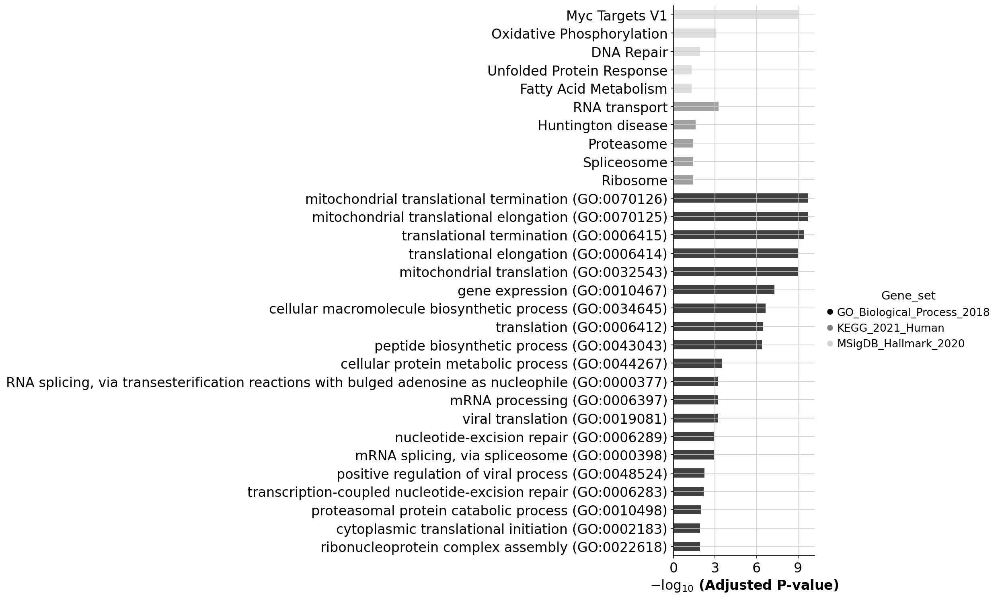

In [287]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [288]:
#save gene lists
sto = pd.DataFrame(sto, columns=['gene_list'])
duo = pd.DataFrame(duo, columns=['gene_list'])
ibd = pd.DataFrame(ibd, columns=['gene_list'])
ced = pd.DataFrame(ced, columns=['gene_list'])

sto.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/MGNmarker_analysis_output/sto_MGNmakers_downsampled.csv')
duo.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/MGNmarker_analysis_output/duo_MGNmakers_downsampled.csv')
ibd.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/MGNmarker_analysis_output/ibd_MGNmakers_downsampled.csv')
ced.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/revisions_Dec2023/MGNmarker_analysis_output/ced_MGNmakers_downsampled.csv')

Try this code for gene overlap (in a separate notebook)
https://rdrr.io/bioc/GeneOverlap/man/GeneOverlap.html#:~:text=Given%20two%20gene%20lists%2C%20tests,estimated%20odds%20ratio%20and%20intersection